# Security Practices Across Open Source Libraries

## Collaborators:
* *Noel Sarduy, noelsd*
* *Dylan Chou, dvchou*

## Project Overview

---

Our central question, "How do security practices differ across open source packages?", is on security practices across different open source datasets, which we investigate because data privacy and security is a significant issue that can impact the safety of many open source software projects. We look into three main themes: security practices in open source projects, how security practices impact open source project popularity and dependencies, and security practice trends over time. We focus on repository and project-level security practices as these are the two main organization levels of open source software packages.

We answer these specific questions to answer the three main themes of our project:

1. How are security practices in open source projects generally distributed?
  * What percentage of open-source projects have implemented security guidelines or conducted security audits?
  * Among GitHub, GitLab, and Bitbucket, which platform appears to have the highest prevalence of secure practices based on the presence of security documentation (security_threat_model_filename, security_audit_filename)?
2. How do security practices of open source projects relate to other features of a main project, such as status, description, platform/host type, or programming languages?
  * Is there a correlation between the adoption of security practices and the activity (status) of a project?
  * Do specific programming languages, platforms or project types (keywords + description) have a higher prevalence of security documentation?
3. How do popularity and dependencies correlate with the security practices of open source projects?
  * Is there a relationship between the number of dependencies a project has and its popularity (sourcerank)?
  * How are projects with a similar number of dependencies related in their number of contributors (repository_contributor_count)?
  * How do external factors like having a code of conduct, license, or contributing guidelines influence a project's popularity or number of dependencies?
4. Trends over time
  * Is there a growing trend in open-source projects including security guidelines or conducting security audits over time?
  * How has the landscape of popular programming languages or platforms in open source changed over time, and how does this correlate with security practices?
---


## Analysis of Dataset

The Libraries.io dataset offers a comprehensive view of open-source software, capturing project details, their dependencies, and various associated metrics. Given the increasing importance of security in software development, our primary focus is to understand the security practices adopted by open-source projects, determine which hosting platforms prioritize security, and see how these correlate with other factors like project popularity, activity, and dependencies. Additionally, we aim to uncover trends over time, providing insights into the evolving landscape of open-source software.

We analyze data from the Libraries.io Open Source Software Dataset. The dataset gathers data on over 2.4 million unique open-source projects, 25 million repositories, and 121 million interdependencies between them. Libraries.io has 7 tables and roughly 11.5 logical gigabytes. The dataset is a collection of open source software that includes 33 package managers and 3 code repositories. The data mainly concerns project and repository dependencies as well as their versions and tags.

### Dataset Summary

We are using tables from one dataset - the libraries.io bigquery dataset.

#### Projects Table (867 MB)
The projects table covers attributes on projects with features such as source rank and dependency count.

`id` - the **primary key** denoting each unique project.

`platform` - the name of the package manager that the project is on. This includes specific package managers such as Pypi or Packagist.

`name` - the name of the project. The names are organized like filepaths, where each word in the name is separated by a backslash. Note that while we can determine the host type that a project's corresponding repository may have if we have, say, a `github.com` prefix in the name, we can still have github repositories corresponding to projects with names that don't start with these prefixes.

`created_timestamp` - timestamp when collection of libraries io first discovered the project.

`updated_timestamp` - timestamp when libraries io last saved a change that was made to the project.

`description` - package manager's description of the project - if no description exists, this references the repository's description.

`keywords` - keywords that are comma separated if this feature - presence of keywords - is supported by the package manager.

`homepage_url` - the url of the corresponding repository or webpage provided by the package manager of the software project.

`licenses` - comma separated identifiers of licenses - for instance, some typical ones are the Apache-2.0 or MIT license that are associated with a project.

`repository_url` - the url the source code contained in the package manager metadata or submitted manually by libraries.io user.

`versions_count` - number of published versions of the project - found through libraries.io.

`sourcerank` - a score based on "quality, popularity and community metrics".

`latest_release_publish_timestamp` - timestamp of the latest release detected by Libraries.io.

`latest_release_number` - the version number of the latest project release.

`package_manager_id` - the Unique ID of project from package manager API, only currently used by PlatformIO.

`dependent_projects_count` - the number of other projects that declare the project as a dependency in at least one version.

`language` - main programming language that the project is written in. The exception is that for GitHub projects, the language is pulled from the repository.

`status` - one of "Active, Deprecated, Unmaintained, Help Wanted, Removed, no value also means active". This feature may be updated by libraries.io.

`last_synced_timestamp` - the timestamp of when libraries.io last synced the project using the project manager's API.

`dependent_repositories_count` - the total repositories that list the project as a dependency.

`repository_id` - a **foreign key** to the repositories table that uniquely identifies the repository `id` corresponding to the project.

#### Repositories Table (1.55 GB)

The repositories table contains repositories across host types such as GitLab, GitHub, and Bitbucket.

`id` - the **primary key** of each unique repository.

`host_type` - the website that the repository is hosted on - GitLab, GitHub or Bitbucket.

`name_with_owner` - now that we are at the repository level, the names contain the owner.

`description` - description of the repository. Keywords do not explicitly capture the contents in the description.

`fork` - a boolean of whether or not the repository is a fork of another.

`created_timestamp` - timestamp of when the repository was created on the host type (e.g., GitHub).

`updated_timestamp` - timestamp of when the repository was last saved by libraries.io.

`last_pushed_timestamp` - present only for repositories, the timestamp of when the repository was last pushed to only available for GitHub repositories. These timestamps may differ from the project timestamps depending on when libraries.io last synced up with the project/repository.

`homepage_url` - the URL of the repository's webpage/homepage.

`size` - the size of the repository (KB) only available for GitHub and Bitbucket.

`stars_count` - the number of stars on the repository only available for GitHub and GitLab.

`language` - the primary programming language of the project - only available for GitHub and Bitbucket.

`issues_enabled` - whether or not the bug tracker enabled for this repository.

`wiki_enabled` - whether or not the wiki enabled for this repository.

`pages_enabled` - only for GitHub, whether or not GitHub pages is enabled.

`forks_count`	- the number of forks of this repository.

`mirror_url` - the URL of the repository that's a mirror - this repository must
be a mirror of another repository.

`open_issues_count` - number of open issues on the repository bug tracker only available for GitHub and GitLab.

`default_branch` - the primary branch of the repository.

`watchers_count` - the number of subscribers to repository notifications - only valid for GitHub and Bitbucket.

`uuid` - ID of the repository on the remote host not unique between GitLab and GitHub repositories.

`fork_source_name_with_owner` - the repository name followed by a slash then the owner name given the repository was a fork.

`license` - license identifier only available for GitHub repositories.

`contributors_count` - the number of unique contributors that have committed to the default branch.

`readme_filename` - the readme file name if it exists.

`changelog_filename` - the changelog file name if it exists.

`contributing_guidelines_filename` - the contributing guidelines file name if it exists
`license_filename` - the license file name if it exists.

`code_of_conduct_filename` - the code of conduct file name if it exists (usually a markdown).

`security_threat_model_filename` - if a security threat model file exists, this is the file name of it. The threat model defines

`security_audit_filename` - if a security audit file exists, this is its filename.

`status` - one of active, deprecated, unmaintained, or help wanted, no value also means active. "Updated when detected by Libraries.io or su. manually by Libraries.io user via "repo suggection" feature."

`last_synced_timestamp` - the timestamp when Libraries.io last synced the repository from the host API.
`sourcerank` - a score based on quality popularity and community metrics.

`display_name` - repository display name only for GitLab.

`scm_type` - type of source control repository uses always "git" for GitHub and GitLab.

`pull_requests_enabled` - whether or not pull requests are enabled for this repository - only for GitLab repositories.

`logo_url` - logo url for repository that is only applicable to GitLab repositories.

`keywords` - comma separated keywords called "topics" only applicable to GitHub and GitLab.

#### Dependencies Table (2.75 GB)

The dependencies table covers project dependencies - a given project that depends on other projects. We use the existing versions_count feature in the `projects_with_repository_field` table in place of joining the dependencies to obtain the version counts.

`id` - **primary key** of the dependency.

`platform` - package manager platform that the project dependency is on. Each dependency corresponds to a project that is dependent on a given project,
represented by a project id.

`project_name` - name of the project that the dependency (another project) belongs to. This project is dependent on the dependency.

`project_id` - **foreign key** that refers to the primary key in the project table for the project that the dependency belongs to.

`version_number` - the number of the version that the dependency belongs to.

`version_id` - **foreign key** that references primary key `id` in the versions table, the version for this project.

`dependency_name` - the name of the project that the dependency specifies.

`dependency_platform` - the name of the package manager of the dependency (different for Atom).

`dependency_kind` - the type of dependency referencing the phase of usage, e.g. runtime, test, development, build.

`optional_dependency` - whether or not the dependency is optional.

`dependency_requirements` - the version or range of versions that the dependency specifies.

`dependency_project_id` - **foreign key** that references the project id primary key of the dependency in the projects table.


#### Repository Dependencies Table (1.21 GB)

The repository dependencies table concerns dependencies on the repository level - a given repository that depends on projects. Namely,

`id` - **primary key** denoting the dependency to a given repository

`host_type` - the host website (GitHub, GitLab, Bitbucket) of the repository that the dependency belongs to.

`repository_name_with_owner` - the repository name and owner separated by a slash.

`repository_id` - **foreign key** referencing the `id` primary key in the repositories table denoting the repository that is dependent on the listed dependencies.

`manifest_platform` - the package manager name contained in the dependency's manifest file.

`manifest_filepath` - in the repository, this is the file path that leads to the file where the dependency is declared.

`git_branch` - which branch was the manifest loaded from the repository.

`manifest_kind` - either manifest or lockfile, manifests are written by humans, lockfiles contain full resolved dependency tree.

`optional` - is the dependency optional?

`dependency_project_name` - the name of the repository dependency, which is a project.

`dependency_requirements` - the version or range of versions that the dependency specifies, resolution of that to a particular version is package manager specific.

`dependency_kind` - the type of dependency referencing the phase of usage, e.g. runtime, test, development, build, like the dependency kind in the dependencies table.

`dependency_project_id` - **foreign key** that references primary key `id` in the projects table of the project for this dependency.

#### Tags Table (1.47 GB)

The tags table contains repository tags, often the version number of a repository. We use this table to obtain tag counts for the repositories table. Note that we don't use the versions table because we only have a versions count in the projects table.

`id` - **primary key** of the tag corresponding to a repository version.

`host_type` - the host website of the tag's repository (GitHub, GitLab, or Bitbucket).

`repository_name_with_owner` - the repository name and owner separated by a slash.

`repository_id` - **foreign key** that references the primary key `id` in the repositories table of the repository for this tag.

`tag_name` - the name of the tag, which is often a version number.

`tag_git_sha` - SHA of the object that the tag is pointing at in the repository.

`tag_published_timestamp` - the timestamp of when the tag was published.

`tag_created_timestamp` - the timestamp of when the tag was first saved into libraries.io.

`tag_updated_timestamp` - the timestamp of when the tag was last saved into libraries.io.

#### Versions Table (1.15 GB)

While the versions table lists all the relevant release numbers of projects, we have the relevant versions count in the projects table. In turn, we don't use this table in our analysis.


#### Projects With Repository Fields Table (1.21 GB)

The table is prejoined between projects and repositories, which we use given the security audit data is more complete than joining the projects and repository tables.

`id` - the **primary key** in the projects with repository fields table, also a **foreign key** to the projects table in the Libraries.io database.

`platform` - the name of the project's package manager

`name`	- the project's name, unique by Platform.

`created_timestamp` - the timestamp when Libraries.io discovered the project.

`updated_timestamp` - the timestamp when Libraries.io last saved a change.

`description` - the description provided by the package manager.

`keywords` - a comma separated array of keywords assuming this is supported by
the package manager.

`homepage_url` - the url of the webpage or repository as provided by package managers that support it.

`licenses` -  a comma separated array of license identifiers.

`repository_url` - the url of source code repository declared in package manager metadata

`versions_count` - the number of published versions of the project.

`sourcerank` - a libraries.io defined score based on quality, popularity and community metrics.

`latest_release_publish_timestamp` - the time of the latest release detected by Libraries.io.

`latest_release_number` - the version number of the latest release detected by Libraries.io (ordered by semver, falling back to publish date for invalid semver).

`package_manager_id` - the unique id of project from package manager API, only currently used by PlatformIO.
`dependent_projects_count` - the number of other projects that declare the project as a dependency in one or more of their versions.

`language` - a primary programming language the project is written in, pulled from the repository if source is hosted on GitHub.
`status` - either Active, Deprecated, Unmaintained, Help Wanted, Removed, no value also means active.

`last_synced_timestamp` - the timestamp of when Libraries.io last synced the project from it's package manager API.

`dependent_repositories_count` - the total count of open source repositories that list the project as a dependency as detected by Libraries.io.

`repository_id` - the unique primary key of the repository for this project in the Libraries.io database, or the **foreign key** referencing the primary `id` column in the repository table.

`repository_host_type` - which website the repository is hosted on (GitHub, GitLab or Bitbucket). First repository field - joined from the repository table.

`repository_name_with_owner` - repository name and owner separated by a slash.

`repository_description` - the description of the repository.

`repository_fork` - is the repository a fork of another.

`repository_created_timestamp` - the timestamp of when the repository was created on the host.

`repository_updated_timestamp` - the timestamp of when the repository was last saved by Libraries.io.

`repository_last_pushed_timestamp` - the timestamp of when the repository was last pushed to, only available for GitHub repositories.

`repository_homepage_url` - the url of a declared homepage or other website for the repository.

`repository_size` - the size of the repository in kilobytes, only available for GitHub and Bitbucket.

`repository_stars_count` - the number of stars on the repository, only available for GitHub and GitLab.

`repository_language` - the primary programming language the project is written in, only available for GitHub and Bitbucket.

`repository_issues_enabled` - whether or not there's a bug tracker enabled for the repository.

`repository_wiki_enabled` - whether or not repository wiki is enabled.

`repository_pages_enabled` - whether or not GitHub pages is enabled for the repository.

`repository_forks_count` - the number of forks of this repository.

`repository_mirror_url` - the repository url of which this is the mirror of.

`repository_open_issues_count` - the number of open issues on the repository bug tracker, only for GitHub and GitLab.

`repository_default_branch` - the primary branch of the repository.

`repository_watchers_count`- the number of subscribers to all notifications for the repository, only available for GitHub and Bitbucket.

`repository_uuid` - the ID of the repository on the remote host, not unique between GitLab and GitHub repositories.

`repository_fork_source_name_with_owner` - whether or not the repository is a fork, the repository name and owner seperated by a slash of the repository if was forked from.

`repository_license` - the license identifier of the repository, only for GitHub repositories.

`repository_contributors_count` - the number of unique contributors that have committed to the default branch.

`repository_readme_filename` - if a readme file exists, the full name of the
readme file.

`repository_changelog_filename` - if a changelog file has been detected, the full name of the changelog file.

`repository_contributing_guidelines_filename` - if a contributing guidelines file exists, the full name of the contributing guidelines file.

`repository_license_filename` - if a license file has been detected, the full name of the license file.

`repository_code_of_conduct_filename` - if a code of conduct file exists, the full name of the code of conduct file.

`repository_security_threat_model_filename` - the full name of the Security Threat Model file.

`repository_security_audit_filename` - the full name of the Security Audit file

`repository_status` - either Active, Deprecated, Unmaintained, Help Wanted, Removed, no value also means active.

`repository_last_synced_timestamp` - the timestamp of when Libraries.io last synced the repository from the host API.

`repository_sourcerank` - the repository-level score based on quality, popularity and community metrics.

`repository_display_name` - the display name for the repository, only for GitLab repositories.

`repository_scm_type` - the type of source control repository uses, always "git" for GitHub and GitLab.

`repository_pull_requests_enabled` - are pull requests enabled for this repository? Only available for GitLab repositories.

`repository_logo_url` - the custom logo url for repository, only for GitLab repositories.

`repository_keywords` - comma separated array of keywords, called "topics" on GitHub, only available for GitHub and GitLab.


#### Pitfalls in the Data

Many of the columns in the projects and repositories are dependent on when the libraries.io last synced the project or repository, which makes some of the data outdated given it is currently the Fall of 2023 and the latest updated timestamps for the software projects are from 2018. We are mindful of the limitations in the accuracy of the analysis as conclusions do not reflect the most current state of open source software packages.

A problem with the repositories table is that one of our variables of interest, keywords, exists as a column, but is not suitable in a complete analysis because it's only available for GitHub and GitLab. Also, the `keywords` column for both projects and repositories are package manager (for projects)/host type(for repositories) dependent so these keywords are coming from predefined keywords of the open source project/repository. In turn, we also define our own keywords based on the contents of the `description` column.

In the same vein as the `keywords` column in the repositories table only existing for GitHub and GitLab, proxies for repository popularity such as `stars_count` are only available for GitHub and GitLab, so analyses are on other features that encompass every host type, such as `source_rank`.


#### High-level relationships between tables

The main table in our analyses is the projects with repository fields table due to better security practices data coverage compared to joining projects with repositories on repository id, which is discussed in the preliminary queries on the data. Joining repositories with the tags table is done to leverage the tag counts of repositories as a proxy of repository activity and ascertain whether it is a good predictor of a security audit. The ultimate goal from using these tables is to determine predictability of security practices based on project features, repository features, and patterns we have observed.

#### Setup

In [ ]:
# Run this cell to authenticate yourself to BigQuery
from google.colab import auth
auth.authenticate_user()
project_id = "cs145-fa23-project2"

In [ ]:
# Initialize BiqQuery client
from google.cloud import bigquery
client = bigquery.Client(project=project_id)

In [ ]:
# Import visualization library
import plotly.express as px
import pandas as pd
import numpy as np

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.figure_factory as ff

#### Preliminary queries on the data

We run initial queries that can facilitate exploratory data analysis and identify any unexpected characteristics of feature distributions, such as the last timestamp when libraries_io kept track of a given project's update. We also run data quality checks in this stage before we run further analysis.

#### Preview of the Projects Table

In [ ]:
%%bigquery --project $project_id

SELECT * FROM `bigquery-public-data.libraries_io.projects` LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,id,platform,name,created_timestamp,updated_timestamp,description,keywords,homepage_url,licenses,repository_url,...,sourcerank,latest_release_publish_timestamp,latest_release_number,package_manager_id,dependent_projects_count,language,status,last_synced_timestamp,dependent_repositories_count,repository_id
0,23102,Bower,socialshareprivacy,2015-01-12 00:15:28+00:00,2018-12-17 03:12:07+00:00,None,None,None,None,https://github.com/tinnet/socialshareprivacy.git,...,1,2018-12-17 03:12:07+00:00,None,<NA>,0,None,None,2018-12-17 03:12:07+00:00,0,<NA>
1,28191,Emacs,macro-math,2015-01-12 00:20:48+00:00,2018-12-21 01:01:58+00:00,in-buffer mathematical operations,convenience,http://nschum.de/src/emacs/macro-math/,None,http://nschum.de/src/emacs/macro-math/,...,0,2018-12-21 01:01:57+00:00,None,<NA>,0,None,None,2018-12-21 01:01:58+00:00,0,<NA>
2,40569,Packagist,av/bonefish-core,2015-01-21 00:31:27+00:00,2018-10-25 21:36:51+00:00,This Project maintains the Bonefish PSR-4 Auto...,None,None,None,https://github.com/AValnar/Bonefish-Core,...,2,2017-04-06 17:22:44+00:00,None,<NA>,0,None,None,NaT,0,<NA>
3,52274,Pypi,imagizer,2015-01-21 00:37:49+00:00,2018-10-25 22:22:14+00:00,Set of tools to manage photos & videos reposit...,Photo Video repository publication,http://wiki.terre-adelie.org/Imagizer,GPL-2.0+,None,...,3,2018-10-22 23:32:22+00:00,None,<NA>,0,None,None,2018-10-22 23:32:16+00:00,0,<NA>
4,53297,Pypi,jank,2015-01-21 00:38:14+00:00,2018-10-25 22:24:41+00:00,sshhh...,None,https://github.com/keenlabs/canteen,Other,https://github.com/keenlabs/canteen,...,3,2018-10-22 23:39:53+00:00,None,<NA>,0,None,None,2018-10-22 23:39:50+00:00,0,<NA>
5,76741,Pypi,SchevoGtk,2015-01-21 00:49:27+00:00,2018-10-26 00:34:22+00:00,Schevo tools for PyGTK,None,http://schevo.org/,MIT,None,...,3,2018-10-23 02:27:07+00:00,None,<NA>,0,None,None,2018-10-23 02:27:05+00:00,0,<NA>
6,85912,Pypi,uudelens,2015-01-21 00:54:18+00:00,2018-10-26 01:32:23+00:00,Unity lens that searches the ubuntuusers.de wi...,"Ubuntu,Unity,Lens,ubuntuusers.de,Search,Find",http://www.florian-diesch.de/software/uudelens/,GPL-3.0,None,...,3,2018-10-23 03:22:43+00:00,None,<NA>,0,None,None,2018-10-23 03:22:37+00:00,0,<NA>
7,102180,Packagist,php-mod/graphviz,2015-01-21 18:22:51+00:00,2018-10-26 02:35:16+00:00,Graphviz generation for PHP,"dot,graphviz",None,MIT,https://github.com/php-mod/graphviz,...,5,2018-10-23 06:58:00+00:00,None,<NA>,0,None,None,2018-10-23 06:57:56+00:00,0,71129
8,106607,Packagist,samsonos/php_upload_aws,2015-01-21 18:30:48+00:00,2018-10-26 03:03:01+00:00,None,None,None,OpenSSL,https://github.com/samsonos/php_upload_aws,...,2,2018-10-23 07:19:53+00:00,None,<NA>,0,None,None,2018-10-23 07:19:51+00:00,0,<NA>
9,112025,Packagist,tlbrains/wplib,2015-01-21 18:39:36+00:00,2018-10-26 03:21:15+00:00,Libreria wrapper de Wordpress,wordpress,None,None,https://github.com/edevelop/wplib,...,2,2018-10-23 07:56:43+00:00,None,<NA>,0,None,None,2018-10-23 07:56:33+00:00,0,<NA>


#### Preview Repositories Table

In [ ]:
%%bigquery --project $project_id

SELECT * FROM `bigquery-public-data.libraries_io.repositories` LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,id,host_type,name_with_owner,description,fork,created_timestamp,updated_timestamp,last_pushed_timestamp,homepage_url,size,...,security_audit_filename,status,last_synced_timestamp,sourcerank,display_name,scm_type,pull_requests_enabled,logo_url,keywords,an
0,29369225,GitHub,rakeshparkiti/DevOps_TestRepo,DevOps Testing Remote Repository,False,2017-05-01 10:11:21+00:00,2017-10-14 08:36:11+00:00,2017-05-02 12:55:32+00:00,None,61,...,None,None,2017-10-14 08:36:11+00:00,0,GitHub,None,git,None,None,None
1,29442550,GitHub,kcwillis/tignishotdog,None,False,2017-10-16 02:13:36+00:00,2017-10-16 02:15:30+00:00,2017-10-16 02:13:36+00:00,None,0,...,None,None,2017-10-16 02:15:29+00:00,0,GitHub,None,git,None,None,None
2,29447811,GitHub,vemperala/angularjsGulp,None,False,2017-10-16 04:12:57+00:00,2017-10-16 04:55:12+00:00,2017-10-16 04:54:03+00:00,None,0,...,None,None,2017-10-16 04:55:12+00:00,0,GitHub,None,git,None,None,None
3,29565009,GitHub,rodcunha/minesw,Codecademy Minesweeper,False,2017-10-18 11:15:58+00:00,2017-10-18 14:05:25+00:00,2017-10-18 11:45:50+00:00,None,11,...,None,None,2017-10-18 14:05:24+00:00,0,GitHub,None,git,None,None,None
4,29666138,GitHub,PersonaOnTheRun/posts-app-react,working on a basic react app to handle posts i...,False,2017-10-20 14:22:24+00:00,2017-10-21 05:58:08+00:00,2017-10-20 14:22:25+00:00,None,0,...,None,None,NaT,0,GitHub,None,git,None,None,None
5,29674007,GitHub,YANLINQU/ProjetIAWS,None,False,2017-10-20 17:38:32+00:00,2017-10-20 18:17:30+00:00,2017-10-20 17:38:33+00:00,None,0,...,None,None,2017-10-20 18:17:30+00:00,0,GitHub,None,git,None,None,None
6,29681445,GitHub,ozanturcan/springMVC,None,False,2017-10-20 21:23:04+00:00,2017-10-20 21:29:27+00:00,2017-10-20 21:23:04+00:00,None,0,...,None,None,2017-10-20 21:29:25+00:00,0,GitHub,None,git,None,None,None
7,29698535,GitHub,likeshan168/cloud_app,asp.net core azure,False,2017-10-21 08:35:48+00:00,2017-10-21 08:39:04+00:00,2017-10-21 08:35:49+00:00,None,0,...,None,None,NaT,0,GitHub,None,git,None,None,None
8,29702664,GitHub,mablae/phpqatools,A meta package for composer of PHP QA Tools li...,True,2017-10-15 12:08:24+00:00,2017-10-15 12:02:21+00:00,2016-08-19 10:07:50+00:00,None,20,...,None,None,2017-10-21 11:14:49+00:00,0,GitHub,None,git,None,None,None
9,29707317,GitHub,mkajdos/rf1-service,This is testing,False,2017-10-21 13:42:38+00:00,2017-10-21 13:44:33+00:00,2017-10-21 13:42:38+00:00,None,0,...,None,None,2017-10-21 13:44:32+00:00,0,GitHub,None,git,None,None,None


#### Preview Dependencies Table

In [ ]:
%%bigquery --project $project_id

SELECT * FROM `bigquery-public-data.libraries_io.dependencies` LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,id,platform,project_name,project_id,version_number,version_id,dependency_name,dependency_platform,dependency_kind,optional_dependency,dependency_requirements,dependency_project_id
0,65938409,CRAN,FateID,2522149,0.1.0,11250568,R,CRAN,depends,false,*,<NA>
1,69242122,CRAN,scorecard,2482134,0.1.3,11648576,R,CRAN,depends,false,*,<NA>
2,61870110,CRAN,tsqn,2482220,1.0.0,10796864,R,CRAN,depends,false,*,<NA>
3,61870136,CRAN,nlsrk,2482268,1.1,10796992,R,CRAN,depends,false,*,<NA>
4,65808531,CRAN,aire.zmvm,2519702,0.5.0,11210488,R,CRAN,depends,false,*,<NA>
5,69021631,CRAN,polymapR,2567892,1.0.11,11622373,R,CRAN,depends,false,*,<NA>
6,65756489,CRAN,CovTools,2494130,0.2.0,11196488,R,CRAN,depends,false,*,<NA>
7,69963326,CRAN,arrangements,2585879,1.0.0,11774346,R,CRAN,depends,false,*,<NA>
8,73276134,NPM,grunt-svn-tag2,2686957,1.0.0,12368519,q,NPM,runtime,false,*,303117
9,67007516,CRAN,RonFHIR,2541903,0.1.0,11393879,R6,CRAN,imports,false,*,689200


#### Preview Repository Dependencies Table



In [ ]:
%%bigquery --project $project_id

SELECT * FROM `bigquery-public-data.libraries_io.repository_dependencies` LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,id,host_type,repository_name_with_owner,repository_id,manifest_platform,manifest_filepath,git_branch,manifest_kind,optional,dependency_project_name,dependency_requirements,dependency_kind,dependency_project_id
0,495472920,GitHub,rspatial/raster,37325530,cran,DESCRIPTION,None,manifest,None,R,>= 3.0.0,depends,<NA>
1,496421483,GitHub,Cogitos/pphy,37331413,cran,DESCRIPTION,None,manifest,None,R,>= 3.1.0,depends,<NA>
2,509015110,GitHub,tdhock/PeakSegDisk,37415991,cran,DESCRIPTION,None,manifest,None,R,>= 2.10,depends,<NA>
3,518307566,GitLab,psadil/final,37473259,cran,DESCRIPTION,None,manifest,None,R,>= 3.4.0,depends,<NA>
4,525076193,GitLab,dickoa/humicon,37488256,cran,DESCRIPTION,None,manifest,None,R,>= 3.1.3,depends,<NA>
5,524787892,GitLab,hrbrmstr/docparser,37522928,cran,DESCRIPTION,None,manifest,None,R,>= 3.2.0,depends,<NA>
6,509772467,GitHub,aisync/duplicate-package-checker-webpack-plugin,37420858,npm,test/simple/node_modules/b/package.json,None,manifest,None,a,~2.0.0,runtime,259971
7,512226106,GitHub,as-com/yarn,37432904,npm,__tests__/fixtures/install/install-link-nested...,None,manifest,None,a,link:a,runtime,259971
8,512223946,GitHub,as-com/yarn,37432904,npm,__tests__/fixtures/install/hardlink-collision-...,None,manifest,None,c,file:deps/c-3,runtime,273334
9,494746427,GitHub,liangfengbo/nodejs-koa2-mysql-sequelize-jwt,37321167,npm,web/package-lock.json,None,lockfile,None,d,1.0.0,runtime,140053


#### Preview Tags Table

In [ ]:
%%bigquery --project $project_id

SELECT * FROM `bigquery-public-data.libraries_io.tags` LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,id,host_type,repository_name_with_owner,repository_id,tag_name,tag_git_sha,tag_published_timestamp,tag_created_timestamp,tag_updated_timestamp
0,52086484,GitHub,dmpriso/hunter,23754342,v0.12.45,8052c9cc2a12437a4c982fdddfc77369dd5d7121,2016-02-09 11:12:51+00:00,2017-05-11 12:16:38+00:00,2017-05-11 12:16:38+00:00
1,52086525,GitHub,dmpriso/hunter,23754342,v0.14.13,19d6d724fb618537c47cd9f82ee3d0b83b5534fd,2016-04-26 14:59:38+00:00,2017-05-11 12:16:46+00:00,2017-05-11 12:16:46+00:00
2,52086704,GitHub,dmpriso/hunter,23754342,v0.18.19,cd10d3af3d333357da6694da5b3c5f5989909625,2017-03-17 15:02:30+00:00,2017-05-11 12:17:35+00:00,2017-05-11 12:17:35+00:00
3,51824875,GitHub,dmpriso/hunter,23754342,v0.2.1,074d514b6d3517b7455f1472e6a7a024e724c510,2014-01-05 21:56:57+00:00,2017-05-02 11:14:49+00:00,2017-05-02 11:14:49+00:00
4,51826230,GitHub,gitGNU/gnu_gnugo,23754632,rel-3-1-3,2a5a6dbb2a697083e7683965c1293f04fe090706,2001-09-06 21:46:31+00:00,2017-05-02 11:59:52+00:00,2017-05-02 11:59:52+00:00
5,53445647,GitHub,nuvoleweb/robo-config,23754963,0.0.1,744897b96466718392b30073c3f34d1f7a67ceb8,2017-05-02 09:24:40+00:00,2017-06-22 08:11:18+00:00,2017-06-22 08:11:18+00:00
6,51826368,GitHub,sukrumerey/matplotlib,23755099,v0.98.5,579640d9db3c00c52b628a50543bad4343d9605b,2008-12-12 03:33:51+00:00,2017-05-02 12:04:14+00:00,2017-05-02 12:04:14+00:00
7,51826310,GitHub,wokster/yii2-app-advanced-wokster,23755125,2.0.0-beta,e8f02b288cfb83605063b89c02eac723257aec45,2014-04-13 21:58:59+00:00,2017-05-02 12:03:09+00:00,2017-05-02 12:03:09+00:00
8,51826433,GitHub,wokster/yii2-app-advanced-wokster,23755125,2.0.2,0b7fb2d305735fe6387017386ec27ef8087748c9,2015-01-11 03:57:55+00:00,2017-05-02 12:06:14+00:00,2017-05-02 12:06:14+00:00
9,67210340,GitHub,WangWenzhuang/ZKCommon,23755138,3.0.9,f22ecc1c2ec8630964b9e42ae85f2d8de9d244a4,2018-06-01 07:56:22+00:00,2018-10-22 20:42:30+00:00,2018-10-22 20:42:30+00:00


#### Preview Versions Table

In [ ]:
%%bigquery --project $project_id

SELECT * FROM `bigquery-public-data.libraries_io.versions` LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,id,platform,project_name,project_id,number,published_timestamp,created_timestamp,updated_timestamp
0,13115025,Dub,dshould,2831757,0.0.1,2018-05-22 08:53:31+00:00,2018-05-23 00:18:01+00:00,2018-05-23 00:18:01+00:00
1,5809871,Dub,tweetnacl,1434507,0.0.1,2016-05-03 20:57:59+00:00,2016-05-04 17:02:04+00:00,2016-05-04 17:02:04+00:00
2,369,Dub,de_util,275,0.0.1,2014-12-01 12:38:15+00:00,2015-01-11 23:58:51+00:00,2015-01-11 23:58:51+00:00
3,1223,Dub,miniupnpc-d,471,0.0.1,2014-05-07 01:51:30+00:00,2015-01-11 23:59:52+00:00,2015-01-11 23:59:52+00:00
4,3822304,Dub,s3-d,980859,0.0.1,2015-09-16 09:06:53+00:00,2015-09-16 09:27:05+00:00,2015-09-16 09:27:05+00:00
5,17156308,Dub,hunt-validation,3473374,0.0.1,2018-12-17 10:22:22+00:00,2018-12-19 00:03:58+00:00,2018-12-19 00:03:58+00:00
6,11779624,Dub,raft,2586361,0.0.1,2018-01-11 07:19:23+00:00,2018-01-14 01:06:36+00:00,2018-01-14 01:06:36+00:00
7,5157179,Dub,mrss,1226465,0.0.1,2016-03-04 07:32:58+00:00,2016-03-05 06:01:52+00:00,2016-03-05 06:01:52+00:00
8,11095274,Dub,d-core-library,2508190,0.0.1,2017-10-28 13:52:53+00:00,2017-10-29 01:05:01+00:00,2017-10-29 01:05:01+00:00
9,12110299,Dub,d-graphviz,2646106,0.0.1,2018-02-11 14:02:04+00:00,2018-02-13 01:06:10+00:00,2018-02-13 01:06:10+00:00


#### Data Currency Check

The latest timestamps of project or repository related fields are from 2018.

In [ ]:
%%bigquery --project $project_id

SELECT MIN(updated_timestamp) as earliest_update_project, MAX(updated_timestamp) as latest_update_project FROM `bigquery-public-data.libraries_io.projects`

Query is running:   0%|          |

Downloading:   0%|          |

,earliest_update_project,latest_update_project
0,2017-01-15 11:11:02+00:00,2018-12-22 20:24:53+00:00


In [ ]:
%%bigquery --project $project_id

SELECT MIN(updated_timestamp) as earliest_update_repository, MAX(updated_timestamp) as latest_update_repository FROM `bigquery-public-data.libraries_io.repositories`

Query is running:   0%|          |

Downloading:   0%|          |

,earliest_update_repository,latest_update_repository
0,2011-09-08 12:50:01+00:00,2018-12-23 05:17:14+00:00


In [ ]:
%%bigquery --project $project_id

SELECT MIN(updated_timestamp) as earliest_update_project, MAX(updated_timestamp) as latest_update_project FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`

Query is running:   0%|          |

Downloading:   0%|          |

,earliest_update_project,latest_update_project
0,2017-01-15 11:10:44+00:00,2018-03-12 13:43:53+00:00


In [ ]:
%%bigquery --project $project_id

SELECT MIN(created_timestamp) as first_proj_created_time,
MAX(created_timestamp) as last_proj_created_time
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`

Query is running:   0%|          |

Downloading:   0%|          |

,first_proj_created_time,last_proj_created_time
0,2015-01-11 23:56:18+00:00,2018-03-12 13:41:41+00:00


#### Preview of Status Counts for Projects

We observe an imbalanced distribution of statuses as most of the project statuses are None (None may indicate projects that are still active), and two relatively similar sized (on the same order of magnitude $10^3$) statuses - deprecated and unmaintained. Only 1 project exists under the status help wanted.

In [ ]:
# keyword presence vs description
%%bigquery --project $project_id

SELECT status, COUNT(*) as count_status FROM `bigquery-public-data.libraries_io.projects`
GROUP BY status

Query is running:   0%|          |

Downloading:   0%|          |

,status,count_status
0,None,3329241
1,Deprecated,3333
2,Unmaintained,1351
3,Help Wanted,1


#### Preview of Status Counts for Repositories

On the repository level, we see the statuses of most repositories are again None and the rest are unmaintained, so there's not as much diverse status data among repositories.

In [ ]:
# keyword presence vs description
%%bigquery --project $project_id

SELECT status, COUNT(*) as num_status_repository FROM `bigquery-public-data.libraries_io.repositories`
GROUP BY status

Query is running:   0%|          |

Downloading:   0%|          |

,status,num_status_repository
0,None,8056353
1,Unmaintained,5203


#### Verifying number of repositories per project

We confirm that each project that matches up to a repository matches with one corresponding repository. Out of the 3333926 total rows in the project table, we have 364492 that corresponds to a repository.

In [ ]:
%%bigquery --project $project_id

SELECT p.id, COUNT(r.id) as num_repositories_in_project
FROM `bigquery-public-data.libraries_io.repositories` r
JOIN `bigquery-public-data.libraries_io.projects` p on r.id = p.repository_id
GROUP BY p.id
ORDER BY num_repositories_in_project DESC

Query is running:   0%|          |

Downloading:   0%|          |

,id,num_repositories_in_project
0,2724688,1
1,3450616,1
2,3457086,1
3,2490987,1
4,2515486,1
...,...,...
364487,3160860,1
364488,2734678,1
364489,3058668,1
364490,3060589,1


#### Preview number of projects per repository

Any given repository may exist in multiple projects. We have multiple repositories that are contained in hundreds of projects. Some of these are projects are reasonable for belonging to many projects such as ydk-go, or other developer toolkits for software developers. The second query looks into the number of repositories that belong to just one project. 3.3% of total unique repositories belong to just one project. Based on the projects with repository fields table, 2.9% of projects have a security audit. Out of the distinct repositories that were paired up with each project, 6.4% of them have a security audit file.

In [ ]:
%%bigquery --project $project_id

SELECT repository_id, repository_name_with_owner, COUNT(id) as num_projects_per_repo
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY repository_id, repository_name_with_owner
ORDER BY num_projects_per_repo DESC

Query is running:   0%|          |

Downloading:   0%|          |

,repository_id,repository_name_with_owner,num_projects_per_repo
0,<NA>,,637355
1,17029,DefinitelyTyped/DefinitelyTyped,3068
2,7252899,npm/security-holder,1894
3,13278511,npm/deprecate-holder,1424
4,196544,kubernetes/kubernetes,1313
...,...,...,...
1145994,611823,adafruit/Adafruit-Fingerprint-Sensor-Library,1
1145995,459082,milesburton/Arduino-Temperature-Control-Library,1
1145996,459087,felis/USB_Host_Shield_2.0,1
1145997,808583,marcoschwartz/aREST,1


In [ ]:
%%bigquery --project $project_id

SELECT r.id, r.name_with_owner, r.homepage_url, COUNT(p.id) as num_projects_per_repo
FROM `bigquery-public-data.libraries_io.repositories` r
JOIN `bigquery-public-data.libraries_io.projects` p on r.id = p.repository_id
GROUP BY r.id, r.name_with_owner, r.homepage_url
ORDER BY num_projects_per_repo DESC

Query is running:   0%|          |

Downloading:   0%|          |

,id,name_with_owner,homepage_url,num_projects_per_repo
0,32687197,CiscoDevNet/ydk-go,http://ydk.io,665
1,31451986,alibaba/ice,https://alibaba.github.io/ice/,523
2,31219564,aws/aws-sdk-go-v2,None,302
3,36089716,cg50x/aws-sdk-go,http://aws.amazon.com/sdk-for-go/,280
4,31220591,jasdel/aws-sdk-go-v2,None,278
...,...,...,...,...
292233,34743579,edemaine/recursed-xls2lua,None,1
292234,36140431,sun-exploit/pimatic-nikoniko,None,1
292235,36918521,meirelon/nba-optimize,None,1
292236,35433952,ljwolf/spenc,https://osf.io/jh483/,1


In [ ]:
%%bigquery --project $project_id
WITH table1 as
(SELECT COUNT(*) as count1 FROM (SELECT r.id, COUNT(p.id) FROM `bigquery-public-data.libraries_io.repositories` r
JOIN `bigquery-public-data.libraries_io.projects` p on r.id = p.repository_id
GROUP BY r.id
HAVING COUNT(p.id) = 1)),
table2 as
(SELECT COUNT(r.id) as count2 FROM `bigquery-public-data.libraries_io.repositories` r)
SELECT CONCAT(ROUND(100*count1/count2,2), "%") as perc_repositories_to_just_one_project
FROM table1,table2


Query is running:   0%|          |

Downloading:   0%|          |

,perc_repositories_to_just_one_project
0,3.33%


In [ ]:
%%bigquery --project $project_id

SELECT CONCAT(ROUND(100*SUM(IF(repository_security_audit_filename != "", 1, 0))/COUNT(id),2), "%") as perc_of_projects_with_security_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`

Query is running:   0%|          |

Downloading:   0%|          |

,perc_of_projects_with_security_audit
0,2.87%


In [ ]:
%%bigquery --project $project_id

SELECT CONCAT(ROUND(100*SUM(IF(repository_security_audit_filename != "", 1, 0))/COUNT(DISTINCT repository_id),2), "%") as perc_of_projects_with_security_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`

Query is running:   0%|          |

Downloading:   0%|          |

,perc_of_projects_with_security_audit
0,6.41%


In [ ]:
%%bigquery --project $project_id

WITH table1 as
(SELECT COUNT(*) as count1 FROM (SELECT r.id, COUNT(p.id) FROM `bigquery-public-data.libraries_io.repositories` r
LEFT JOIN `bigquery-public-data.libraries_io.projects` p on r.id = p.repository_id
GROUP BY r.id
HAVING COUNT(p.id) = 0)),
table2 as
(SELECT COUNT(r.id) as count2 FROM `bigquery-public-data.libraries_io.repositories` r)
SELECT CONCAT(ROUND(100*count1/count2,2), "%") as perc_repositories_not_corresponding_to_project
FROM table1,table2

Query is running:   0%|          |

Downloading:   0%|          |

,perc_repositories_not_corresponding_to_project
0,96.37%


In [ ]:
# Many repositories don't correspond to a listed project.
df = client.query("""SELECT r.id, COUNT(p.id) as ct FROM `bigquery-public-data.libraries_io.repositories` r
LEFT JOIN `bigquery-public-data.libraries_io.projects` p on r.id = p.repository_id
GROUP BY r.id
HAVING ct < 5""").to_dataframe()


fig = px.histogram(df, x="ct",color_discrete_sequence=["firebrick"])
fig.update_layout(title="Count Distribution of number of projects that any given repository belongs to")
fig.update_xaxes(title="Number of Projects a Repository Belongs to")
fig.update_yaxes(title="Count of Repositories")
fig.show()

In [ ]:
%%bigquery --project $project_id

SELECT ROUND(100*COUNTIF(repository_security_audit_filename <> "")/COUNT(*),2) as perc_projects_threat_model_with_audit FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE repository_security_threat_model_filename <> ""

Query is running:   0%|          |

Downloading:   0%|          |

,perc_projects_threat_model_with_audit
0,100.0


In [ ]:
%%bigquery --project $project_id

SELECT ROUND(100*COUNTIF(repository_security_threat_model_filename <> "")/COUNT(*),2) as perc_projects_audit_with_threat_model  FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE repository_security_audit_filename <> ""

Query is running:   0%|          |

Downloading:   0%|          |

,perc_projects_audit_with_threat_model
0,83.98


The presence of a threat model is closely tied with a security audit. All projects that have a threat model have been audited in the past. It appears that the audit may have prompted the creation of a security threat model. Among audited projects, 84% have a threat model, so there's high correlation of auditted projects and those having a threat model. Because the presence of a threat model directly indicates that the project has a security audit, we exclude this feature in our predictions and analysis.

#### Matching Project and Repository Tables - Observing Statuses

We join the projects with the repositories table to obtain the corresponding repositories and observe that in most cases, both the project and repository statuses are both None. The rest of the statuses appear to be distinct between the project and repository level. Given that the statuses are mostly None, we use other proxies of activity in software projects.

In [ ]:
%%bigquery --project $project_id

SELECT p.status as project_status, r.status as repository_status,
COUNT(*) as num_pairs FROM `bigquery-public-data.libraries_io.repositories` r
JOIN `bigquery-public-data.libraries_io.projects` p on r.id = p.repository_id
GROUP BY p.status, r.status
ORDER BY num_pairs DESC

Query is running:   0%|          |

Downloading:   0%|          |

,project_status,repository_status,num_pairs
0,None,None,363507
1,None,Unmaintained,968
2,Unmaintained,Unmaintained,9
3,Unmaintained,None,4
4,Deprecated,None,4


#### Missing Repository Data

About 25% projects in the projects with repository fields table do not have a corresponding repository, but we may still make use of the existing repository data in our predictions.

In [ ]:
%%bigquery --project $project_id

SELECT ROUND(100*COUNTIF(repository_id IS NULL)/COUNT(id), 2) as perc_missing_repository_id
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`

Query is running:   0%|          |

Downloading:   0%|          |

,perc_missing_repository_id
0,24.93


#### Coverage issues

The percentage of project ids matching between the project dependencies table and the projects with repository fields table is 4.57%. 0% of the repository ids between the projects with repository fields and repository dependencies table overlap. This could be from the projects with repository fields table not containing all the repositories, or an id naming convention mismatch. In the future, we may be able to conduct more thorough analysis given comprehensive documentation, but would not be able to incorporate dependency-specific engineered features.

In [ ]:
%%bigquery --project $project_id

SELECT ROUND(100*COUNT(DISTINCT pr.id)/(SELECT COUNT(DISTINCT id) FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`), 2) as perc_matching
FROM `bigquery-public-data.libraries_io.dependencies` d
JOIN `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
ON d.project_id = pr.id

Query is running:   0%|          |

Downloading:   0%|          |

,perc_matching
0,4.57


In [ ]:
%%bigquery --project $project_id

SELECT COUNT(DISTINCT pr.repository_id)/(SELECT COUNT(DISTINCT repository_id) FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`) as perc_matching
FROM `bigquery-public-data.libraries_io.repository_dependencies` d
JOIN `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
ON d.repository_id = pr.repository_id

Query is running:   0%|          |

Downloading:   0%|          |

,perc_matching
0,0.0


#### Ruling out less informative features

The counts below about repositories are highly right skewed, but are still considered in the model in case of possible model performance improvement.

In [ ]:
%%bigquery temp1 --project $project_id

SELECT CAST(repository_watchers_count AS FLOAT64) as watchers_count,
(CASE WHEN repository_security_audit_filename <> "" THEN "Security Audit Present" ELSE "No Security Audit" END) as presence_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`


Query is running:   0%|          |

Downloading:   0%|          |

<Axes: xlabel='presence_audit', ylabel='watchers_count'>

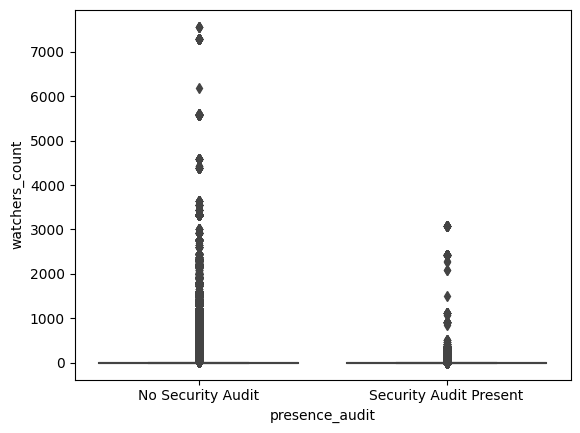

In [ ]:
sns.boxplot(data=temp1, x='presence_audit', y='watchers_count', palette='husl')

In [ ]:
%%bigquery temp1 --project $project_id

SELECT CAST(repository_stars_count AS FLOAT64) as count,
(CASE WHEN repository_security_audit_filename <> "" THEN "Security Audit Present" ELSE "No Security Audit" END) as presence_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`

Query is running:   0%|          |

Downloading:   0%|          |

<Axes: xlabel='presence_audit', ylabel='count'>

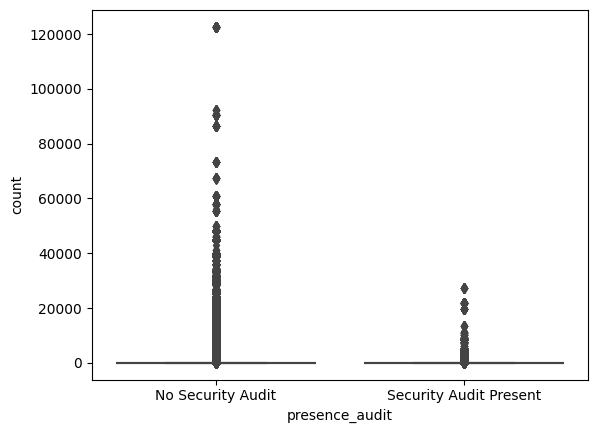

In [ ]:
sns.boxplot(data=temp1, x='presence_audit', y='count', palette='husl')

In [ ]:
%%bigquery temp1 --project $project_id

SELECT CAST(repository_forks_count AS FLOAT64) as count,
(CASE WHEN repository_security_audit_filename <> "" THEN "Security Audit Present" ELSE "No Security Audit" END) as presence_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`


Query is running:   0%|          |

Downloading:   0%|          |

<Axes: xlabel='presence_audit', ylabel='count'>

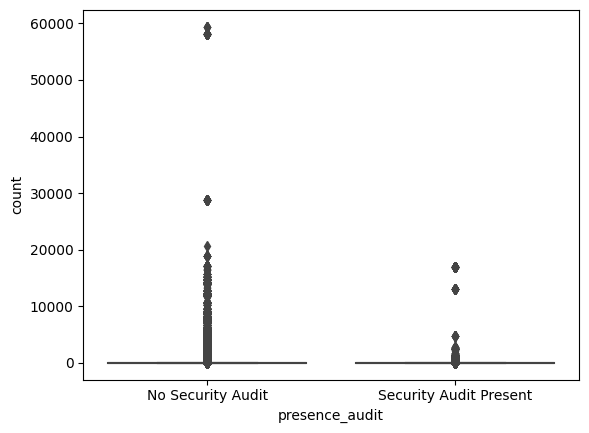

In [ ]:
sns.boxplot(data=temp1, x='presence_audit', y='count', palette='husl')

The "enabled" repository columns displayed below do not seem to be associated with whether or not a project has a security audit. For instance, whether or not a repository has pages enabled doesn't exhibit any differences in the rate of audits.

In [ ]:
%%bigquery --project $project_id

SELECT repository_pages_enabled, COUNTIF(repository_security_audit_filename <> "")/COUNT(id) as perc_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY repository_pages_enabled

Query is running:   0%|          |

Downloading:   0%|          |

,repository_pages_enabled,perc_audit
0,<NA>,0.000859
1,False,0.038790
2,True,0.031709


In [ ]:
%%bigquery --project $project_id

SELECT repository_wiki_enabled, COUNTIF(repository_security_audit_filename <> "")/COUNT(id) as perc_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY repository_wiki_enabled

Query is running:   0%|          |

Downloading:   0%|          |

,repository_wiki_enabled,perc_audit
0,<NA>,0.000000
1,True,0.039537
2,False,0.029429


In [ ]:
%%bigquery --project $project_id

SELECT repository_issues_enabled, COUNTIF(repository_security_audit_filename <> "")/COUNT(id) as perc_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY repository_issues_enabled

Query is running:   0%|          |

Downloading:   0%|          |

,repository_issues_enabled,perc_audit
0,<NA>,0.000000
1,False,0.024593
2,True,0.043309


## Data Exploration

#### Data Exploration of Initial Security Practices Analysis
We answer the following questions:
* What percentage of open-source projects have implemented security guidelines or conducted security audits?

* Among GitHub, GitLab, and Bitbucket, which host type appears to have the highest prevalence of secure practices based on the presence of security documentation (security_threat_model_filename, security_audit_filename)?


Upon conducting an initial analysis of the data resulting from the merging of the 'repositories' and 'projects' tables, we observed notable discrepancies in the figures pertaining to the repositories with audit files and security threat models. The combined data from both tables indicated a total of 862 audits and 5 threat models. However, a separate review of the 'projects_with_repository_fields' table yielded significantly different results. In order to maintain objectivity and avoid premature assumptions, we have concluded that it is most prudent to utilize the aggregated data as is, without engaging in further SQL joins. This approach ensures a more straightforward and reliable analysis moving forward.

In [ ]:
%%bigquery --project $project_id

WITH total_repos AS (
    SELECT COUNT(*) as total_count
    FROM `bigquery-public-data.libraries_io.repositories`
),
audit_repos AS (
    SELECT COUNT(*) as audit_count
    FROM `bigquery-public-data.libraries_io.repositories`
    WHERE security_audit_filename IS NOT NULL
),
threat_model_repos AS (
    SELECT COUNT(*) as threat_model_count
    FROM `bigquery-public-data.libraries_io.repositories`
    WHERE security_threat_model_filename IS NOT NULL
),
both_repos AS (
    SELECT COUNT(*) as both_count
    FROM `bigquery-public-data.libraries_io.repositories`
    WHERE security_audit_filename IS NOT NULL
    AND security_threat_model_filename IS NOT NULL
)
SELECT
    total_repos.total_count,
    audit_repos.audit_count,
    threat_model_repos.threat_model_count,
    both_repos.both_count,
    (audit_repos.audit_count / total_repos.total_count * 100) AS audit_percentage,
    (threat_model_repos.threat_model_count / total_repos.total_count * 100) AS threat_model_percentage,
    (both_repos.both_count / total_repos.total_count * 100) AS both_percentage
FROM
    total_repos,
    audit_repos,
    threat_model_repos,
    both_repos;


Query is running:   0%|          |

Downloading:   0%|          |

,total_count,audit_count,threat_model_count,both_count,audit_percentage,threat_model_percentage,both_percentage
0,8061556,862,5,0,0.010693,0.000062,0.0


Results from using the projects_with_repository_fields table

In [ ]:
%%bigquery --project $project_id

WITH total_repos AS (
    SELECT COUNT(*) as total_count
    FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
),
audit_repos AS (
    SELECT COUNT(*) as audit_count
    FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
    WHERE repository_security_audit_filename IS NOT NULL
    AND TRIM(repository_security_audit_filename) != ''
),
threat_model_repos AS (
    SELECT COUNT(*) as threat_model_count
    FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
    WHERE repository_security_threat_model_filename IS NOT NULL
    AND TRIM(repository_security_threat_model_filename) != ''
),
both_repos AS (
    SELECT COUNT(*) as both_count
    FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
    WHERE repository_security_audit_filename IS NOT NULL
    AND repository_security_threat_model_filename IS NOT NULL
    AND TRIM(repository_security_audit_filename) != ''
    AND TRIM(repository_security_threat_model_filename) != ''
)
SELECT
    total_repos.total_count,
    audit_repos.audit_count,
    threat_model_repos.threat_model_count,
    both_repos.both_count,
    (audit_repos.audit_count / total_repos.total_count * 100) AS audit_percentage,
    (threat_model_repos.threat_model_count / total_repos.total_count * 100) AS threat_model_percentage,
    (both_repos.both_count / total_repos.total_count * 100) AS both_percentage
FROM
    total_repos,
    audit_repos,
    threat_model_repos,
    both_repos;


Query is running:   0%|          |

Downloading:   0%|          |

,total_count,audit_count,threat_model_count,both_count,audit_percentage,threat_model_percentage,both_percentage
0,2556311,73420,61659,61659,2.872108,2.41203,2.41203


In our further investigations, we focused on analyzing the recurrence of filenames in project audits and threat models across various projects to determine similarities in security dependencies. Our preliminary findings revealed that a substantial number of filenames, though not explicitly labeled as null, were in fact empty strings. We have consequently excluded these from our analysis, treating them as null values for clarity and accuracy. Additionally, we encountered generic filenames, notably 'f' and 't', in our dataset. Despite their simplicity, we have chosen to consider these as valid file identifiers. This decision is particularly crucial in the context of threat models, where the ubiquitous filename 'f' is observed. Disregarding these as invalid would result in a significant loss of potentially valuable data, as rows containing 'f' would be rendered devoid of meaningful content.

In [ ]:
%%bigquery --project $project_id

SELECT
    repository_security_audit_filename,
    COUNT(*) AS project_reuse_count
FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE
    repository_security_audit_filename IS NOT NULL
    AND TRIM(repository_security_audit_filename) != ''
GROUP BY
    repository_security_audit_filename
ORDER BY
    project_reuse_count DESC;


Query is running:   0%|          |

Downloading:   0%|          |

,repository_security_audit_filename,project_reuse_count
0,f,61655
1,audit/audit_test.go,8339
2,audit/package_test.go,1053
3,audit/hashstructure_test.go,973
4,audit/v1/audit-gen.go,520
...,...,...
110,audit.php,1
111,auditing/DCleanAuditRecords.php,1
112,AuditPsnotifyTest.go,1
113,AUDITS/.gitkeep,1


In [ ]:
%%bigquery --project $project_id

SELECT
    repository_security_threat_model_filename,
    COUNT(*) AS project_reuse_count
FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE
    repository_security_threat_model_filename IS NOT NULL
    AND TRIM(repository_security_threat_model_filename) != ''
GROUP BY
    repository_security_threat_model_filename
ORDER BY
project_reuse_count DESC

Query is running:   0%|          |

Downloading:   0%|          |

,repository_security_threat_model_filename,project_reuse_count
0,f,61659


In [ ]:
%%bigquery --project $project_id

WITH audit_reuse AS (
    SELECT
        COUNT(*) AS project_reuse_count
    FROM
        `bigquery-public-data.libraries_io.projects_with_repository_fields`
    WHERE
        repository_security_audit_filename IS NOT NULL
        AND TRIM(repository_security_audit_filename) != ''
),
threat_model_reuse AS (
    SELECT
        COUNT(*) AS project_reuse_count
    FROM
        `bigquery-public-data.libraries_io.projects_with_repository_fields`
    WHERE
        repository_security_threat_model_filename IS NOT NULL
        AND TRIM(repository_security_threat_model_filename) != ''
),
total_reuse AS (
    SELECT 'Audit File Reuse' AS type, SUM(a.project_reuse_count) AS total_reuse_count
    FROM audit_reuse a
    UNION ALL
    SELECT 'Threat Model Reuse' AS type, SUM(t.project_reuse_count) AS total_reuse_count
    FROM threat_model_reuse t
)
SELECT
    *,
    RANK() OVER (ORDER BY total_reuse_count DESC) AS reuse_rank
FROM
    total_reuse
ORDER BY
    total_reuse_count DESC;


Query is running:   0%|          |

Downloading:   0%|          |

,type,total_reuse_count,reuse_rank
0,Audit File Reuse,73420,1
1,Threat Model Reuse,61659,2


In [ ]:
%%bigquery repo_perc_with_security --project $project_id

SELECT
    projects.repository_host_type,
    COUNT(DISTINCT CASE
        WHEN (projects.repository_security_threat_model_filename IS NOT NULL AND projects.repository_security_threat_model_filename != '')
             OR (projects.repository_security_audit_filename IS NOT NULL AND projects.repository_security_audit_filename != '')
        THEN projects.repository_id
        END) AS security_documented_count,
    COUNT(DISTINCT projects.repository_id) AS total_projects,
    (COUNT(DISTINCT CASE
        WHEN (projects.repository_security_threat_model_filename IS NOT NULL AND projects.repository_security_threat_model_filename != '')
             OR (projects.repository_security_audit_filename IS NOT NULL AND projects.repository_security_audit_filename != '')
        THEN projects.repository_id
        END) * 100.0 / COUNT(DISTINCT projects.repository_id)) AS percentage_with_security_docs
FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields` as projects
GROUP BY
    projects.repository_host_type
ORDER BY
    percentage_with_security_docs DESC;


Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
fig = px.bar(repo_perc_with_security[repo_perc_with_security["repository_host_type"] != ""], x='repository_host_type', y='percentage_with_security_docs',
             title='% of Projects with Security Documentation by Repository Host Type',
             labels={'percentage_with_security_docs': '% with Security Documentation'},
             color_discrete_sequence=["darkgreen"])
fig.update_xaxes(title="Repository Host Type")
fig.show()

The rate of security audits in projects depends on the repository host type - BitBucket has the greatest proportion of audits whereas GitLab has the least - so we use this as a feature during prediction.

#### Data Exploration on correlation between security documentation and project features (excluding popularity/dependencies)
How do security practices of open source projects relate to other features of a main project, such as status, description, platform/host type, or programming languages?
  * Is there a correlation between the adoption of security practices and the version counts of a project or number of tags in a repository (proxies of activity or amount of updates in open source software packages)?
  * Do specific programming languages, platforms or project types (keywords + description) have a higher prevalence of security documentation?

Based on the distribution of project version counts, we define the quartiles for visualization.

In [ ]:
# First observe the distribution of version counts in projects
%%bigquery --project $project_id

SELECT * FROM (SELECT DISTINCT versions_count,
CONCAT(ROUND(100*PERCENT_RANK() OVER (ORDER BY versions_count),2),"%") as perc_rank_versions_count
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields` p)
LIMIT 11

Query is running:   0%|          |

Downloading:   0%|          |

,versions_count,perc_rank_versions_count
0,0,0%
1,1,38.12%
2,2,58.06%
3,3,67.42%
4,4,73.59%
5,5,78.06%
6,6,81.37%
7,7,84.08%
8,8,86.11%
9,9,87.75%


In [ ]:
%%bigquery versions_audit_table --project $project_id

SELECT (CASE WHEN repository_security_audit_filename != "" THEN 1 ELSE 0 END) as presence_of_security_audit,
(CASE WHEN versions_count = 0 THEN "Q1"
WHEN versions_count BETWEEN 1 AND 2 THEN "Q2"
WHEN versions_count BETWEEN 3 AND 5 THEN "Q3"
WHEN versions_count >= 6 THEN "Q4" END) as versions_count_bucket,
COUNT(id) as num_projects
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY presence_of_security_audit, versions_count_bucket
ORDER BY presence_of_security_audit DESC, versions_count_bucket ASC

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
num_projs_table = np.reshape(np.array(versions_audit_table["num_projects"]),(2,4))
security_audit_version_counts = [num_projs_table[0]]
fig = px.imshow(security_audit_version_counts,
                text_auto=True,
                color_continuous_scale="Blues")
fig.update_xaxes(title="Project Version Quartiles (Q1, Q2, Q3, Q4) - Counts Among Audited Software Projects")
fig.show()

In [ ]:
no_security_audit_version_counts = [num_projs_table[1]]
fig = px.imshow(no_security_audit_version_counts, text_auto=True, color_continuous_scale="Blues")
fig.update_xaxes(title="Project Version Quartiles (Q1, Q2, Q3, Q4) - Counts Among Non-Audited Software Projects")
fig.show()

The distribution of version counts does not appear to differ between audited and non-audited projects. Both have the greatest concentration of projects around 0-1 versions and lower concentrations for greater number of version counts, a proxy of project activity. The low variance in version counts across projects may be an artifact of how the data was selected by those who maintain the libraries io dataset.

For the tag counts across repositories, we see that the data is slightly more evenly spread out compared to the version counts across projects. We bucket the data into quartiles: 0-1 bucket 1, 2-4 bucket 2, 5-10 bucket 3, 10+ as bucket 4.

In [ ]:
%%bigquery --project $project_id
WITH tags_count_repo AS
(
  SELECT r.id, COUNT(DISTINCT t.id) as tags_count FROM `bigquery-public-data.libraries_io.repositories` r
  JOIN `bigquery-public-data.libraries_io.tags` t ON t.repository_id = r.id
  GROUP BY r.id
)
SELECT * FROM (SELECT DISTINCT tags_count, CONCAT(ROUND(100*PERCENT_RANK() OVER (ORDER BY tags_count),2),"%") as perc_rank_tags_count
FROM tags_count_repo)
LIMIT 11

Query is running:   0%|          |

Downloading:   0%|          |

,tags_count,perc_rank_tags_count
0,1,0%
1,2,29.75%
2,3,43.77%
3,4,52.64%
4,5,58.61%
5,6,63.09%
6,7,66.6%
7,8,69.45%
8,9,71.87%
9,10,73.83%


In [ ]:
%%bigquery tags_audit_table --project $project_id

# getting counts in 2-way contingency table - excluding the repositories that
# do not have a corresponding entry in the tags table.
WITH tags_count_repo AS
(
  SELECT r.id, COUNT(DISTINCT t.id) as tags_count
  FROM `bigquery-public-data.libraries_io.repositories` r
  JOIN `bigquery-public-data.libraries_io.tags` t ON t.repository_id = r.id
  GROUP BY r.id
)
SELECT (CASE WHEN r.security_audit_filename IS NOT NULL THEN 1 ELSE 0 END) as presence_of_security_audit,
(CASE WHEN tr.tags_count BETWEEN 0 AND 1 THEN "Q1"
WHEN tr.tags_count BETWEEN 2 AND 4 THEN "Q2"
WHEN tr.tags_count BETWEEN 5 AND 10 THEN "Q3"
WHEN tr.tags_count BETWEEN 11 AND 60940 THEN "Q4" END) as tags_count_bucket,
COUNT(tr.id) as num_repositories
FROM tags_count_repo tr JOIN `bigquery-public-data.libraries_io.repositories` r ON  tr.id = r.id
GROUP BY presence_of_security_audit, tags_count_bucket
ORDER BY presence_of_security_audit DESC, tags_count_bucket ASC

Query is running:   0%|          |

Downloading:   0%|          |

Among repositories that have matched with the repository ids in the tags table with security audit files, there are proportionally more repositories in the fourth quartile of tag counts (11 to 60940) than those without security audits. Under the filtered set of repositories, we have that it's more likely to encounter repositories with more tags (more updates) among those with security audits than those without them. It could be that audited projects are well-developed and have gone through many repository tags.

Although we found a higher proportion of repositories with larger tag counts among those with security audits, this does not suggest that the tag number would be a strong predictor of whether or not a repository has a security audit.

In [ ]:
num_repositories_table = np.reshape(np.array(tags_audit_table["num_repositories"]),(2,4))
security_audit_tag_counts = [num_repositories_table[0]]
fig = px.imshow(security_audit_tag_counts, text_auto=True, color_continuous_scale="Blues")
fig.update_xaxes(title="Repository Tag Quartiles (Q1, Q2, Q3, Q4) - Counts Among Audited Repositories")
fig.show()

In [ ]:
no_security_audit_tag_counts = [num_repositories_table[1]]
fig = px.imshow(no_security_audit_tag_counts, text_auto=True, color_continuous_scale="Blues")
fig.update_xaxes(title="Repository Tag Quartiles (Q1, Q2, Q3, Q4) - Counts Among Non-Audited Repositories")
fig.show()

The proportion of repository ids that match between the tags table and the projects with repository fields table is low, so we consider the other features we explore below.

In [ ]:
%%bigquery --project $project_id

SELECT ROUND(100*COUNT(DISTINCT pr.repository_id)/(SELECT COUNT(DISTINCT pr.repository_id) FROM `bigquery-public-data.libraries_io.projects_with_repository_fields` pr), 2) as perc_repos_matching
FROM `bigquery-public-data.libraries_io.tags` t
JOIN `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
ON t.repository_id = pr.repository_id

Query is running:   0%|          |

Downloading:   0%|          |

,perc_repos_matching
0,8.59


In [ ]:
%%bigquery --project $project_id
SELECT ROUND(100*COUNTIF(repository_language <> "")/COUNT(repository_id),2) as perc_non_empty_languages_among_repositories FROM
(SELECT DISTINCT repository_language, repository_id FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`)


Query is running:   0%|          |

Downloading:   0%|          |

,perc_non_empty_languages_among_repositories
0,96.62


In [ ]:
%%bigquery --project $project_id
SELECT ROUND(100*COUNTIF(language <> "")/COUNT(id),2) as perc_non_empty_languages_among_projects FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`


Query is running:   0%|          |

Downloading:   0%|          |

,perc_non_empty_languages_among_projects
0,70.58


Based on the two percentages above, we use repository language due to better coverage of non-empty values.

In [ ]:
%%bigquery programming_language_prevalence --project $project_id
# Programming languages prevalence

SELECT repository_language, ROUND(100*SUM(IF(repository_security_audit_filename != "", 1, 0))/COUNT(*),2) as perc_security_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY repository_language
HAVING COUNT(id) > 10
ORDER BY perc_security_audit DESC
LIMIT 20

Query is running:   0%|          |

Downloading:   0%|          |

Out of the top 20 primary languages in open source software projects with security audits (using the projects with repository fields table), we see that Prolog has the greatest proportion of security audits.

In [ ]:
fig = px.bar(programming_language_prevalence, x='repository_language', y='perc_security_audit', color_discrete_sequence=["green"])
fig.update_layout(title="% Security Audit vs. Primary Repository Language")
fig.update_yaxes(title="% of Projects Within Repository Language That Have Security Audits")
fig.update_xaxes(title="Language")
fig.show()

It appears that the repository language with the highest rate of security audits is Prolog out of all projects with available primary repository languages. Prolog is most often used in AI and computational linguistics projects, so the repositories may be used in critical system applications, such as network intrusion detection, that would have a greater need for security audits.

In [ ]:
%%bigquery platform_security_prevalence --project $project_id
# Platform security audit prevalence - use projects with repository fields for higher coverage

SELECT platform, ROUND(100*SUM(IF(repository_security_audit_filename != "", 1, 0))/COUNT(*),2) as perc_security_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY platform
HAVING COUNT(id) > 10
ORDER BY perc_security_audit DESC
LIMIT 20

Query is running:   0%|          |

Downloading:   0%|          |

Using the project with repository fields table, among the top 20 package managers with security audits, Purescript has the largest proportion of projects with security audits at over 20% while Cargo and Shards have the second and third largest proportions of security audits. Purescript goes hand-in-hand with web application development, so it could be that web-based projects are more likely to have security audits than others.

In [ ]:
fig = px.bar(platform_security_prevalence, x='platform', y='perc_security_audit', color_discrete_sequence=["green"])
fig.update_layout(title="% Security Audits vs. Platform")
fig.update_xaxes(title="Platform")
fig.update_yaxes(title="% of Projects Within Language That Have Security Audits")
fig.show()

In [ ]:
%%bigquery --project $project_id

SELECT terms FROM (SELECT terms FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`, UNNEST(split(TRIM(LOWER(description)), " ")) terms
WHERE REGEXP_CONTAINS(terms, "^[a-zA-Z]*$") AND terms NOT IN ("", "for", "a",
 "the", "and", "to", "of", "in", "is", "go", "with", "from", "an", "on",
 "that", "simple", "your", "you", "this", "using", "by", "as", "or", "use", "it",
 "get","managing", "get", "into", "if", "provides", "are", "work", "based", "data",
 "all", "be", "which", "used", "can", "set", "make", "file", "files", "some",
 "personal", "small", "free", "touch", "image", "helper", "feel", "via",
 "custom", "interested", "one", "projects", "string", "copy", "services", "my",
 "collection", "access") AND repository_security_audit_filename <> ""
GROUP BY terms
ORDER BY COUNT(terms) DESC
LIMIT 100)
WHERE terms NOT IN
(SELECT terms as num_tokens FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`, UNNEST(split(TRIM(LOWER(description)), " ")) terms
WHERE REGEXP_CONTAINS(terms, "^[a-zA-Z]*$") AND terms NOT IN ("", "for", "a",
 "the", "and", "to", "of", "in", "is", "go", "with", "from", "an", "on",
 "that", "simple", "your", "you", "this", "using", "by", "as", "or", "use", "it",
 "get","managing", "get", "into", "if", "provides", "are", "work", "based", "data",
 "all", "be", "which", "used", "can", "set", "make", "file", "files", "some", "personal", "my") AND repository_security_audit_filename = ""
GROUP BY terms
ORDER BY COUNT(terms) DESC
LIMIT 1000)

Query is running:   0%|          |

Downloading:   0%|          |

,terms
0,juju
1,devops
2,distilled
3,typings
4,crate
5,ffi
6,placeholder


Based on the top 100 keywords among the audited projects but not within the top 100 keywords in projects that were not audited, we select these keywords to split the groups: juju, devops, distilled, typings, crate, ffi, placeholder.

In [ ]:
%%bigquery keyword_table --project $project_id
# see if there's a clear split between presence/lack of presence of keyword
SELECT (CASE WHEN (LOWER(description) LIKE "%juju%" OR
LOWER(description) LIKE "%devops%" OR LOWER(description) LIKE "%distilled%"
OR LOWER(description) LIKE "%typings%"
OR LOWER(description) LIKE "%crate%"
OR LOWER(description) LIKE "%ffi%"
OR LOWER(description) LIKE "%placeholder%") THEN 1 ELSE 0 END) as presence_of_keyword,
(CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_security_audit,
 COUNT(*) as num_projects
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
GROUP BY presence_of_keyword, presence_of_security_audit
ORDER BY presence_of_keyword ASC, presence_of_security_audit ASC




Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
keyword_table

,presence_of_keyword,presence_of_security_audit,num_projects
0,0,0,2451156
1,0,1,62724
2,1,0,31735
3,1,1,10696


Based on the heatmap between projects with keywords and those without, it appears that the groups split by keywords, juju, devops, distilled, typings, crate, ffi, placeholder, have a slight difference in proportion of security audits. We can interpret the group with the keywords as web applications, given typings (typescript) and placeholders, or potentially projects that have been deployed (juju, devops). Among projects with the keywords, we see 25% of them have security audits compared to the 2% in the group without keywords. However, the caveat is that we are looking a smaller subset of the data when we filter by the keywords, so the proportions are out of a smaller total number of projects. It is reassuring that there is some distinction in keywords between the descriptions of audited and non-audited projects.

In [ ]:
security_audit_keyword_counts = np.reshape(np.array(keyword_table["num_projects"]),(2,2))
props = 100*security_audit_keyword_counts/np.reshape(security_audit_keyword_counts.sum(axis=1),(2,1))
props = [[np.round(props[row][col],2) for col in range(len(props[row]))] for row in range(len(props))]
fig = ff.create_annotated_heatmap(props,
                                  x=["No Security Audit File","Security Audit File Present"],
                                  y=["Projects Without Keywords", "Projects With Keywords"],
                                  colorscale="Blues")
fig.update_xaxes(title="Security Audit Filename")
fig.update_yaxes(title="Keywords")
fig.update_layout(title="Heatmap of security audit proportions of projects with/without keywords",
                  width=700, height=600,
                  margin=dict(t=150))
fig.show()

In [ ]:
%%bigquery description_word_length --project $project_id

SELECT
  id,
  description,
  has_security_audit,
  AVG(LENGTH(word)) AS avg_word_length
FROM (
  SELECT
    id,
    description,
    IF(repository_security_audit_filename != "", 1, 0) as has_security_audit,
    word
  FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`,
    UNNEST(SPLIT(TRIM(LOWER(description)), " ")) AS word
)
GROUP BY
 id, description, has_security_audit;

Query is running:   0%|          |

Downloading:   0%|          |

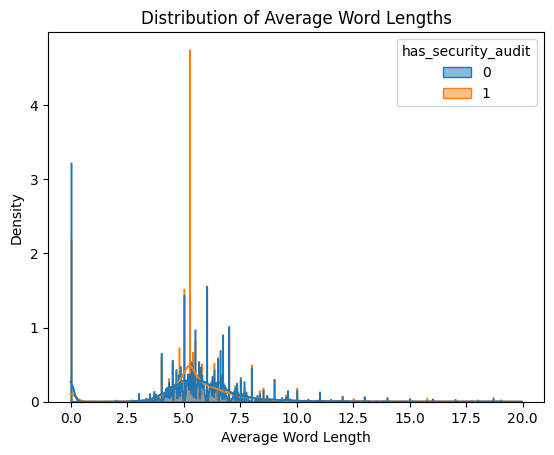

In [ ]:
sns.histplot(data=description_word_length[description_word_length["avg_word_length"] < 20],
             x='avg_word_length',
             hue='has_security_audit',
             element="step", stat="density",
             common_norm=False, kde=True,alpha=0.5)
plt.title('Distribution of Average Word Lengths')
plt.xlabel('Average Word Length')
plt.ylabel('Density')
plt.show()

In [ ]:
%%bigquery description_unique --project $project_id

WITH table1 AS
(
  SELECT
    id,
    description,
    word,
    COUNT(*) as word_count
  FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`,
    UNNEST(SPLIT(TRIM(LOWER(description)), " ")) AS word
  GROUP BY id, description, word
) SELECT
  t1.id,
  t1.description,
  t1.has_security_audit,
  COUNTIF(t2.word_count=1)/COUNT(*) AS prop_unique
FROM (
  SELECT
    id,
    description,
    IF(repository_security_audit_filename != "", 1, 0) as has_security_audit,
    word
  FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`,
    UNNEST(SPLIT(TRIM(LOWER(description)), " ")) AS word
) t1 JOIN table1 t2 ON t1.id = t2.id AND t1.description = t2.description
AND t1.word = t2.word
GROUP BY
 t1.id, t1.description, t1.has_security_audit

Query is running:   0%|          |

Downloading:   0%|          |

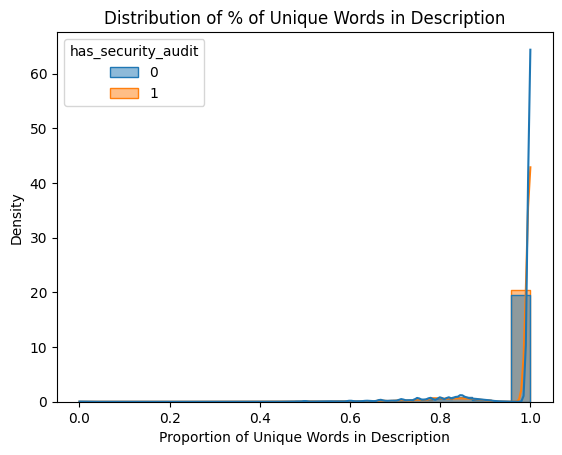

In [ ]:
sns.histplot(data=description_unique,
             x='prop_unique',
             hue='has_security_audit',
             element="step", stat="density",
             common_norm=False, kde=True,alpha=0.5)
plt.title('Distribution of % of Unique Words in Description')
plt.xlabel('Proportion of Unique Words in Description')
plt.ylabel('Density')
plt.show()

In [ ]:
%%bigquery description_count --project $project_id

SELECT
  id,
  description,
  has_security_audit,
  CAST(COUNT(word) AS FLOAT64) AS num_words
FROM (
  SELECT
    id,
    description,
    IF(repository_security_audit_filename != "", 1, 0) as has_security_audit,
    word
  FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`,
    UNNEST(SPLIT(TRIM(LOWER(description)), " ")) AS word
)
GROUP BY
 id, description, has_security_audit;

Query is running:   0%|          |

Downloading:   0%|          |

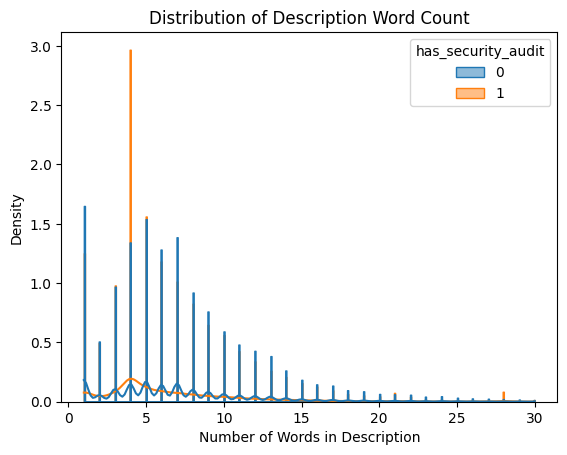

In [ ]:
sns.histplot(data=description_count[description_count["num_words"] <= 30],
             x='num_words',
             hue='has_security_audit',
             element="step", stat="density",
             common_norm=False, kde=True,alpha=0.5)
plt.title('Distribution of Description Word Count')
plt.xlabel('Number of Words in Description')
plt.ylabel('Density')
plt.show()

There are no notable differences in proportion of unique words and average word lengths between non-audited and audited projects. The distribution of average word length may be consistent because most repository descriptions are succinct and expressed in one sentence with high frequency words that average about 5-6 characters long. Also, because descriptions tend to be between 0 and 15 words long, the proportion of words that show up once in the description is more likely to be close to 100% if there are not many words in the descriptions. We still consider these features in our model to see if there are any performance improvements.

#### Data Exploration on popularity and dependencies
How do popularity and dependencies correlate with the security practices of open source projects?
  * How does the number of dependencies a project has and its popularity (sourcerank) relate with its security practices?
  * How are projects with a similar number of dependencies related in their number of contributors (repository_contributor_count) and their security practices?
  * How do external factors like having a code of conduct, license, or contributing guidelines influence a project's popularity or number of dependencies?

In [ ]:
%%bigquery security_sourcerank_table --project $project_id

SELECT (CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_audit,
CAST(repository_sourcerank AS FLOAT64) as repository_sourcerank FROM `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
WHERE repository_sourcerank IS NOT NULL
ORDER BY presence_of_audit DESC, repository_sourcerank ASC


Query is running:   0%|          |

Downloading:   0%|          |

Using the projects with repository fields table for better coverage, we first look at the presence of the security audit file vs. the repository popularity. We exclude any NA popularity scores (source rank) in our visualizations.

<Axes: xlabel='repository_sourcerank', ylabel='Density'>

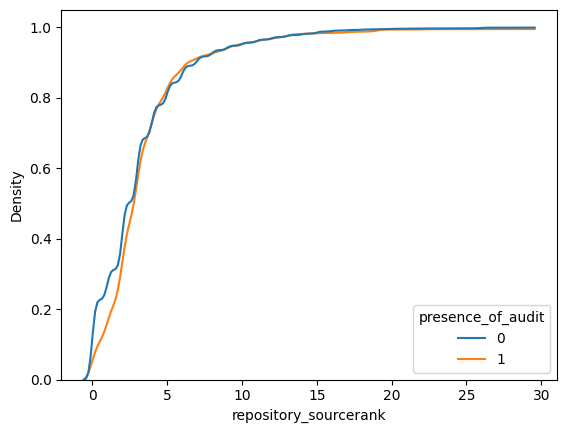

In [ ]:
sns.kdeplot(data=security_sourcerank_table, x="repository_sourcerank", hue="presence_of_audit",
            cumulative=True, common_norm=False, common_grid=True)

In [ ]:
%%bigquery security_proj_sourcerank_table --project $project_id

SELECT (CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_audit,
CAST(sourcerank AS FLOAT64) as project_sourcerank FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE sourcerank IS NOT NULL
ORDER BY presence_of_audit DESC, project_sourcerank ASC

Query is running:   0%|          |

Downloading:   0%|          |

Using the projects with repository fields table, the plot below displays the cumulative distribution of project popularities for projects with and without security audits. We exclude any NA popularity scores (source rank) in our visualizations.

<Axes: xlabel='project_sourcerank', ylabel='Density'>

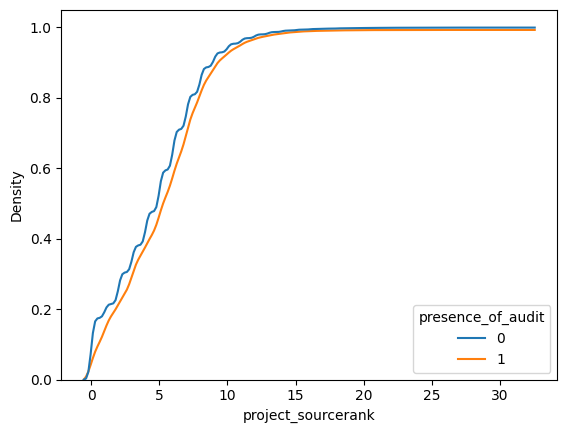

In [ ]:
sns.kdeplot(data=security_proj_sourcerank_table, x="project_sourcerank", hue="presence_of_audit",
            cumulative=True, common_norm=False, common_grid=True)

Given that the sample sizes of the two groups (projects with security audit files vs. those without the audit files) are vastly different, we compare their density plots. In the above visuals, we compare their cumulative density plots. We don't see significant differences in the popularity (source rank) distributions between audited and non-audited projects. We conclude that there may not be a notable correlation between repository/project popularity and the presence of a security audit file across open source projects, which may be due to popularity not being driven by whether or not a project was audited. Project and repository popularity may be correlated with other factors such as indicators of how well maintained a project is or how many use cases the project has.

In addition to project and repository popularity over all projects, we can inspect differences in source rank popularity distributions per platform for projects.

In [ ]:
%%bigquery security_proj_pop_host --project $project_id

SELECT repository_host_type, (CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_audit,
CAST(sourcerank AS FLOAT64) as project_sourcerank FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE sourcerank IS NOT NULL AND repository_host_type <> ""

Query is running:   0%|          |

Downloading:   0%|          |

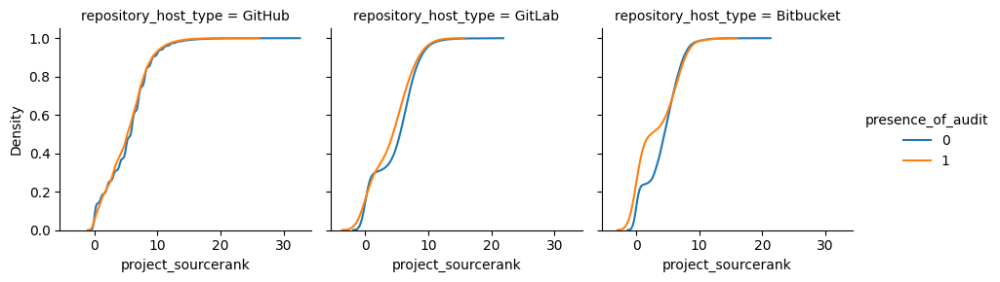

In [ ]:
g = sns.FacetGrid(security_proj_pop_host,
              col="repository_host_type",
                  hue="presence_of_audit")
_ = g.map(sns.kdeplot, "project_sourcerank", cumulative=True)
_ = g.add_legend()

In [ ]:
%%bigquery security_repo_pop_host --project $project_id

SELECT repository_host_type, (CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_audit,
CAST(repository_sourcerank AS FLOAT64) as repo_sourcerank FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE repository_sourcerank IS NOT NULL AND repository_host_type <> ""

Query is running:   0%|          |

Downloading:   0%|          |

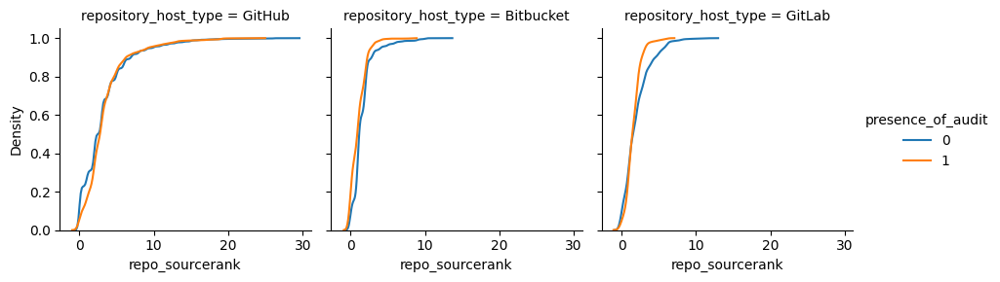

In [ ]:
g = sns.FacetGrid(security_repo_pop_host,
              col="repository_host_type",
                  hue="presence_of_audit")
g.map(sns.kdeplot, "repo_sourcerank", cumulative=True)
g.add_legend()

When we break down the project source rank distributions between projects with and without security audit files by the repository host type, we see there's not much of a difference between projects with or without security audits. However, Bitbucket projects appear to have a greater difference in project source ranks between those with security audit files and those without. Among Bitbucket projects, those with security audits appear to have a slightly greater proportion of projects among the higher source ranks than those without security audits.

There appears to be a slight difference in repository source rank distributions across GitLab projects between audited and non-audited projects, which is based on the small blip between repository source ranks of 2 and 5 for GitLab. The greater density of audited projects that are popular compared to non-audited projects for Bitbucket may be attributed from host type-specific trends of audited projects having a greater proportion of highly popular or ranked projects. It could be that Bitbucket has a greater emphasis on security and this may boost more audited projects up in source rank.

We include repository source rank and repository host type into the model to capture their association with the security audit feature.

For projects with a similar number of dependencies, the distribution of the number of dependent projects that a given project has is highly right skewed, so it may not be informative to split the projects into similar number of project dependencies if over 80% of projects have at most 1 dependent project.
Similarly, the distribution of the number of dependent repositories is also concentrated at very few dependencies.

In [ ]:
%%bigquery --project $project_id

WITH project_dependencies AS
(
  SELECT dependent_projects_count FROM
  `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
  WHERE dependent_projects_count IS NOT NULL
)
SELECT * FROM (SELECT DISTINCT dependent_projects_count, CONCAT(ROUND(100*PERCENT_RANK() OVER (ORDER BY dependent_projects_count),2),"%") as perc_rank_dep_proj_count
FROM project_dependencies)
LIMIT 3

Query is running:   0%|          |

Downloading:   0%|          |

,dependent_projects_count,perc_rank_dep_proj_count
0,0,0%
1,1,84.37%
2,2,91.43%


In [ ]:
%%bigquery --project $project_id
WITH repo_dependencies AS
(
  SELECT dependent_repositories_count FROM
  `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
  WHERE dependent_repositories_count IS NOT NULL
)
SELECT * FROM (SELECT DISTINCT dependent_repositories_count, ROUND(100*PERCENT_RANK() OVER (ORDER BY dependent_repositories_count),2) as perc_rank_dep_repo_count
FROM repo_dependencies)
LIMIT 5

Query is running:   0%|          |

Downloading:   0%|          |

,dependent_repositories_count,perc_rank_dep_repo_count
0,0,0.00
1,1,82.43
2,2,88.96
3,3,91.68
4,4,93.13


Combining the analysis on source ranks from earlier, we see if there's a difference in correlation between repository dependency count and repository popularity over the two security groups (repositories with and without security audits). In the blue scatterplots below, the correlations do not appear to differ significantly. The projects with security audits has fewer points spanning projects with many dependent repositories but lower popularity given that there are very few projects with security audits in the data.

In [ ]:
%%bigquery repo_dep_vs_pop --project $project_id

SELECT (CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_audit,
CAST(repository_sourcerank AS FLOAT64) as repository_sourcerank, CAST(dependent_repositories_count AS FLOAT64) as dependent_repositories_count,
CAST(COUNT(*) as FLOAT64) as num_projs
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE repository_sourcerank IS NOT NULL AND dependent_repositories_count IS NOT NULL
GROUP BY presence_of_audit, repository_sourcerank, dependent_repositories_count

Query is running:   0%|          |

Downloading:   0%|          |

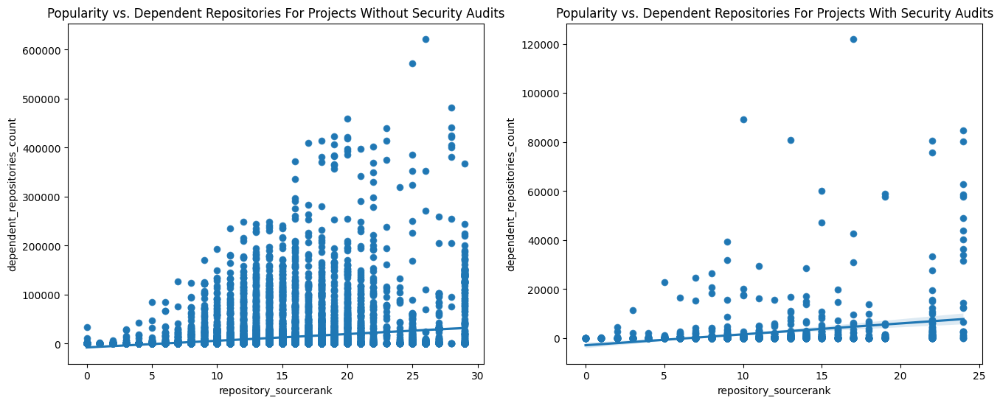

In [ ]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(16,6))

ax1.set_title("Popularity vs. Dependent Repositories For Projects Without Security Audits")
_ = sns.scatterplot(data=repo_dep_vs_pop[repo_dep_vs_pop["presence_of_audit"]==0],
                x='repository_sourcerank',
                y='dependent_repositories_count',
                ax=ax1)

_ = sns.regplot(data=repo_dep_vs_pop[repo_dep_vs_pop["presence_of_audit"]==0],
                x='repository_sourcerank',
                y='dependent_repositories_count',
            ax=ax1)


ax2.set_title("Popularity vs. Dependent Repositories For Projects With Security Audits")
_ = sns.scatterplot(data=repo_dep_vs_pop[repo_dep_vs_pop["presence_of_audit"]==1],
                x='repository_sourcerank',
                y='dependent_repositories_count',
                ax=ax2)

_ = sns.regplot(data=repo_dep_vs_pop[repo_dep_vs_pop["presence_of_audit"]==1],
            x='repository_sourcerank',
            y='dependent_repositories_count',
            ax=ax2)


In [ ]:
%%bigquery proj_dep_vs_pop --project $project_id

SELECT (CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_audit,
CAST(sourcerank AS FLOAT64) as sourcerank,
CAST(dependent_projects_count AS FLOAT64) as dependent_projects_count
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE sourcerank IS NOT NULL AND dependent_projects_count IS NOT NULL
GROUP BY presence_of_audit, sourcerank, dependent_projects_count



Query is running:   0%|          |

Downloading:   0%|          |

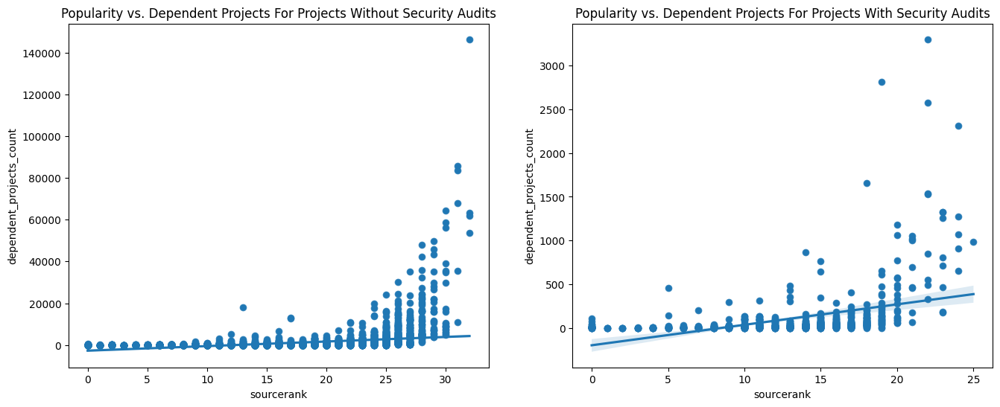

In [ ]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(16,6))

ax1.set_title("Popularity vs. Dependent Projects For Projects Without Security Audits")
_ = sns.scatterplot(data=proj_dep_vs_pop[proj_dep_vs_pop["presence_of_audit"]==0],
                x='sourcerank',
                y='dependent_projects_count',
                ax=ax1)

_ = sns.regplot(data=proj_dep_vs_pop[proj_dep_vs_pop["presence_of_audit"]==0],
                x='sourcerank',
                y='dependent_projects_count',
            ax=ax1)


ax2.set_title("Popularity vs. Dependent Projects For Projects With Security Audits")
_ = sns.scatterplot(data=proj_dep_vs_pop[proj_dep_vs_pop["presence_of_audit"]==1],
                x='sourcerank',
                y='dependent_projects_count',
                ax=ax2)

_ = sns.regplot(data=proj_dep_vs_pop[proj_dep_vs_pop["presence_of_audit"]==1],
            x='sourcerank',
            y='dependent_projects_count',
            ax=ax2)


There is a slightly positive correlation between repository popularity and dependent repositories - more popular projects tend to have more dependent repositories or projects. However, dependent repositories and repository popularity are not jointly associated with the rate of security audits in software projects, which could be that the general trend across the projects stored in libraries io is more popular projects have more dependencies. There is likely a positive correlation between popularity and repository dependency count because more popular projects may have been developed over a longer period of time that also means many more dependent projects that branch off from the original.

We also examine the heatmap of binned contributors and dependencies below. There does not appear to be association in the 2d contingency table either as all security audit rates are relatively similar across the cells.

We categorize the repository and project source ranks:

In [ ]:
%%bigquery --project $project_id

WITH table AS
(
  SELECT sourcerank FROM
  `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
  WHERE sourcerank IS NOT NULL
)
SELECT * FROM (SELECT DISTINCT sourcerank, CONCAT(ROUND(100*PERCENT_RANK() OVER (ORDER BY sourcerank),2),"%") as perc_rank_proj_sourcerank
FROM table)
LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,sourcerank,perc_rank_proj_sourcerank
0,0,0%
1,1,17.29%
2,2,21.44%
3,3,30.29%
4,4,38.09%
5,5,47.52%
6,6,59.32%
7,7,70.88%
8,8,80.85%
9,9,88.68%


In [ ]:
%%bigquery --project $project_id

WITH table AS
(
  SELECT repository_sourcerank FROM
  `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
  WHERE repository_sourcerank IS NOT NULL
)
SELECT * FROM (SELECT DISTINCT repository_sourcerank, CONCAT(ROUND(100*PERCENT_RANK() OVER (ORDER BY repository_sourcerank),2),"%") as perc_rank_repo_sourcerank
FROM table)
LIMIT 10

Query is running:   0%|          |

Downloading:   0%|          |

,repository_sourcerank,perc_rank_repo_sourcerank
0,0,0%
1,1,22.28%
2,2,30.91%
3,3,50.17%
4,4,68.6%
5,5,78.04%
6,6,84.46%
7,7,89.22%
8,8,91.82%
9,9,93.6%


We visualize the dependencies vs popularity in a heatmap:

In [ ]:
%%bigquery repo_dep_pop_table --project $project_id

SELECT (CASE WHEN repository_sourcerank BETWEEN 0 AND 1 THEN "Q1"
             WHEN repository_sourcerank BETWEEN 2 AND 3 THEN "Q2"
             WHEN repository_sourcerank BETWEEN 4 AND 5 THEN "Q3"
             WHEN repository_sourcerank > 5 THEN "Q4" END) as popularity_category,
(CASE WHEN dependent_repositories_count = 0 THEN "Q1"
      WHEN dependent_repositories_count = 1 THEN "Q2"
      WHEN dependent_repositories_count = 2 THEN "Q3"
      WHEN dependent_repositories_count > 2 THEN "Q4" END) as dependencies_category,
SUM(IF(repository_security_audit_filename <> "", 1, 0))/COUNT(*) as prop_security_audit,
CAST(COUNT(*) AS FLOAT64) as num_projects_in_bucket
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY popularity_category, dependencies_category
HAVING popularity_category IS NOT NULL AND dependencies_category IS NOT NULL
ORDER BY popularity_category ASC, dependencies_category ASC

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
%%bigquery proj_dep_pop_table --project $project_id

SELECT (CASE WHEN sourcerank BETWEEN 0 AND 2 THEN "Q1"
             WHEN sourcerank BETWEEN 3 AND 4 THEN "Q2"
             WHEN sourcerank BETWEEN 5 AND 8 THEN "Q3"
             WHEN sourcerank > 8 THEN "Q4" END) as popularity_category,
(CASE WHEN dependent_projects_count = 0 THEN "Q1"
      WHEN dependent_projects_count = 1 THEN "Q2"
      WHEN dependent_projects_count = 2 THEN "Q3"
      WHEN dependent_projects_count > 2 THEN "Q4" END) as dependencies_category,
SUM(IF(repository_security_audit_filename <> "", 1, 0))/COUNT(*) as prop_security_audit,
CAST(COUNT(*) AS FLOAT64) as num_projects_in_bucket
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY popularity_category, dependencies_category
HAVING popularity_category IS NOT NULL AND dependencies_category IS NOT NULL
ORDER BY popularity_category ASC, dependencies_category ASC

Query is running:   0%|          |

Downloading:   0%|          |

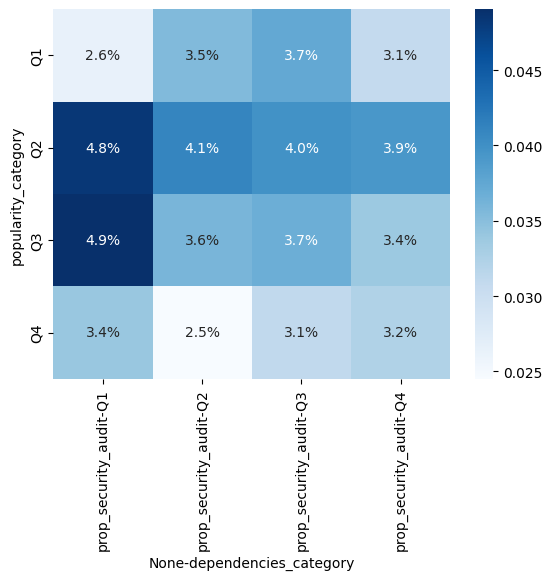

In [ ]:
_ = sns.heatmap(repo_dep_pop_table.pivot(index='popularity_category',
                                   columns='dependencies_category',
                                   values=['prop_security_audit']),
            annot=True,
            cmap="Blues",
            fmt=".1%")


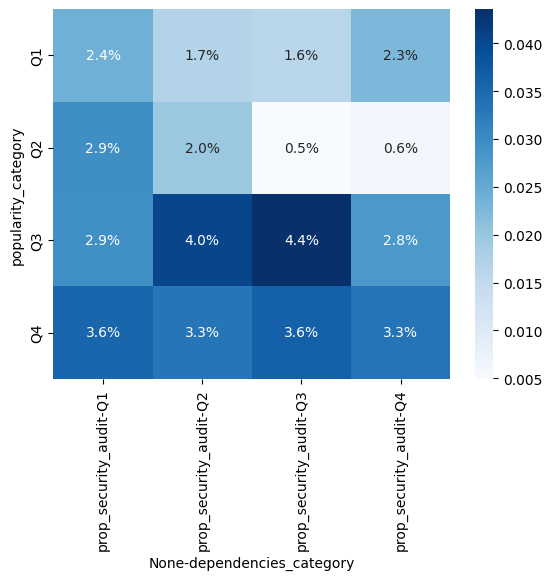

In [ ]:
_ = sns.heatmap(proj_dep_pop_table.pivot(index='popularity_category',
                                   columns='dependencies_category',
                                   values=['prop_security_audit']),
            annot=True,
            cmap="Blues",
            fmt=".1%")


From a less granular perspective, we see that the distribution of the security audit files is similar across dependency-popularity categories and suggests that the popularity and number of dependencies do not determine the likelihood of a project audit. It could be that some projects have audits that are early in development, or others may be more popular with many dependencies that are well-developed, so we may not be able to say that dependency count or popularity definitively points to the presence of an audit.

Looking at the distribution of contributors to a repository, we split repositories into those that fall under a similar number of repository contributors:

In [ ]:
%%bigquery --project $project_id
WITH repo_contributors AS
(
  SELECT repository_contributors_count FROM
  `bigquery-public-data.libraries_io.projects_with_repository_fields` pr
  WHERE repository_contributors_count IS NOT NULL
)
SELECT * FROM (SELECT DISTINCT repository_contributors_count, ROUND(100*PERCENT_RANK() OVER (ORDER BY repository_contributors_count),2) as perc_rank_contributors
FROM repo_contributors)
WHERE perc_rank_contributors IN (7.52, 52.56, 75.16)

Query is running:   0%|          |

Downloading:   0%|          |

,repository_contributors_count,perc_rank_contributors
0,1,7.52
1,2,52.56
2,8,75.16


In [ ]:
%%bigquery contributor_dependency_table --project $project_id

SELECT (CASE WHEN repository_contributors_count BETWEEN 0 AND 1 THEN "Q1"
             WHEN repository_contributors_count BETWEEN 2 AND 3 THEN "Q2"
             WHEN repository_contributors_count BETWEEN 4 AND 8 THEN "Q3"
             WHEN repository_contributors_count > 8 THEN "Q4" END) as contributors_category,
(CASE WHEN dependent_repositories_count = 0 THEN "Q1"
      WHEN dependent_repositories_count = 1 THEN "Q2"
      WHEN dependent_repositories_count = 2 THEN "Q3"
      WHEN dependent_repositories_count > 2 THEN "Q4" END) as dependencies_category,
SUM(IF(repository_security_audit_filename <> "", 1, 0))/COUNT(*) as prop_security_audit,
CAST(COUNT(*) AS FLOAT64) as num_projects_in_bucket
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY contributors_category, dependencies_category
HAVING contributors_category IS NOT NULL AND dependencies_category IS NOT NULL
ORDER BY contributors_category ASC, dependencies_category ASC


Having seen the repository dependency count distribution, we see if there's any association in the proportion of projects with security audits when plotting repository dependency count against number of contributors to a repository.

In [ ]:
%%bigquery contributor_dependency_table --project $project_id

SELECT (CASE WHEN repository_contributors_count BETWEEN 0 AND 1 THEN "Q1"
             WHEN repository_contributors_count BETWEEN 2 AND 3 THEN "Q2"
             WHEN repository_contributors_count BETWEEN 4 AND 8 THEN "Q3"
             WHEN repository_contributors_count > 8 THEN "Q4" END) as contributors_category,
(CASE WHEN dependent_repositories_count = 0 THEN "Q1"
      WHEN dependent_repositories_count = 1 THEN "Q2"
      WHEN dependent_repositories_count = 2 THEN "Q3"
      WHEN dependent_repositories_count > 2 THEN "Q4" END) as dependencies_category,
SUM(IF(repository_security_audit_filename <> "", 1, 0))/COUNT(*) as prop_security_audit,
CAST(COUNT(*) AS FLOAT64) as num_projects_in_bucket
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY contributors_category, dependencies_category
HAVING contributors_category IS NOT NULL AND dependencies_category IS NOT NULL
ORDER BY contributors_category ASC, dependencies_category ASC

Query is running:   0%|          |

Downloading:   0%|          |

The heatmap below displays the proportions of security indicators after binning repository contributor counts and dependency counts into quartiles, which doesn't indicate any joint association between contributors and dependencies that may be helpful in predicting likelihood of security audit as the proportions are nearly equal, ranging from 1.7% to at most 4.7%.

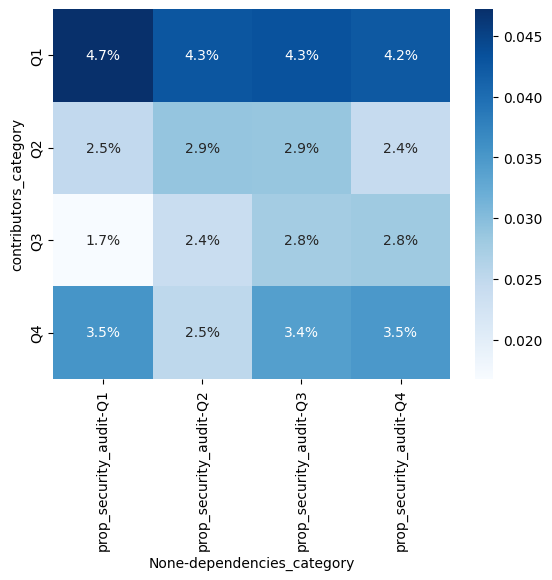

In [ ]:
_ = sns.heatmap(contributor_dependency_table.pivot(index='contributors_category',
                                   columns='dependencies_category',
                                   values=['prop_security_audit']),
            annot=True,
            cmap="Blues",
            fmt=".1%")


In [ ]:
contributor_dependency_table.pivot(index='contributors_category',
                                   columns='dependencies_category',
                                   values=['num_projects_in_bucket'])

num_projects_in_bucket                           
dependencies_category                     Q1       Q2       Q3       Q4
contributors_category                                                  
Q1                                  829249.0  90076.0  32077.0  56310.0
Q2                                  210270.0  28499.0  13348.0  40836.0
Q3                                  108151.0  11402.0   6296.0  33445.0
Q4                                  393391.0  10038.0   5491.0  48436.0

Individually, contributors and dependent repositories do not appear to be associated with the rate of security audits in projects.

In [ ]:
%%bigquery --project $project_id

SELECT (CASE WHEN repository_contributors_count BETWEEN 0 AND 1 THEN "Q1"
             WHEN repository_contributors_count BETWEEN 2 AND 3 THEN "Q2"
             WHEN repository_contributors_count BETWEEN 4 AND 8 THEN "Q3"
             WHEN repository_contributors_count > 8 THEN "Q4" END) as contributors_category,
ROUND(100*SUM(IF(repository_security_audit_filename <> "", 1, 0))/COUNT(*),2) as perc_security_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY contributors_category
HAVING contributors_category IS NOT NULL

Query is running:   0%|          |

Downloading:   0%|          |

,contributors_category,perc_security_audit
0,Q4,3.50
1,Q1,4.64
2,Q3,2.01
3,Q2,2.53


In [ ]:
%%bigquery --project $project_id

SELECT (CASE WHEN dependent_repositories_count = 0 THEN "Q1"
      WHEN dependent_repositories_count = 1 THEN "Q2"
      WHEN dependent_repositories_count = 2 THEN "Q3"
      WHEN dependent_repositories_count > 2 THEN "Q4" END) as dependent_repositories_category,
ROUND(100*SUM(IF(repository_security_audit_filename <> "", 1, 0))/COUNT(*),2) as perc_security_audit
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY dependent_repositories_category

Query is running:   0%|          |

Downloading:   0%|          |

,dependent_repositories_category,perc_security_audit
0,Q1,2.85
1,Q4,2.83
2,Q2,3.11
3,Q3,3.06


To account for the loss of granularity in the data after categorizing the numerical data, we display the scatter plot of contributors against dependency count.

In [ ]:
%%bigquery contributor_repo_dependency_table --project $project_id

SELECT (CASE WHEN repository_security_audit_filename <> "" THEN 1 ELSE 0 END) as presence_of_audit,
CAST(repository_contributors_count AS FLOAT64) as repository_contributors_count, CAST(dependent_repositories_count AS FLOAT64) as dependent_repositories_count,
CAST(COUNT(*) as FLOAT64) as num_projs
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE repository_sourcerank IS NOT NULL AND dependent_repositories_count IS NOT NULL
GROUP BY presence_of_audit, repository_contributors_count, dependent_repositories_count

Query is running:   0%|          |

Downloading:   0%|          |

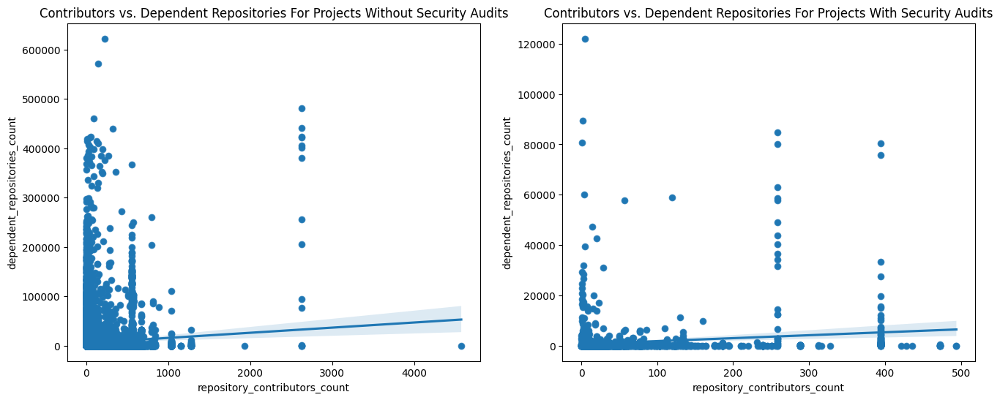

In [ ]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(16,6))

ax1.set_title("Dependent Repositories vs. Contributors For Projects Without Security Audits")
_ = sns.scatterplot(data=contributor_repo_dependency_table[contributor_repo_dependency_table["presence_of_audit"]==0],
                x='repository_contributors_count',
                y='dependent_repositories_count',
                ax=ax1)

_ = sns.regplot(data=contributor_repo_dependency_table[contributor_repo_dependency_table["presence_of_audit"]==0],
                x='repository_contributors_count',
                y='dependent_repositories_count',
            ax=ax1)


ax2.set_title("Dependent Repositories vs. Contributors For Projects With Security Audits")
_ = sns.scatterplot(data=contributor_repo_dependency_table[contributor_repo_dependency_table["presence_of_audit"]==1],
                x='repository_contributors_count',
                y='dependent_repositories_count',
                ax=ax2)

_ = sns.regplot(data=contributor_repo_dependency_table[contributor_repo_dependency_table["presence_of_audit"]==1],
            x='repository_contributors_count',
            y='dependent_repositories_count',
            ax=ax2)


Both the scatterplots and heatmap of dependency count vs. repository contributor counts reveals that the number of contributors or the number of dependencies of a repository do not explain or indicate a greater likelihood of a security audit. It may be the case that most repositories have a limited range of contributors (0-1000), so there's a mix of repositories that have audits and those that don't have audits distributed uniformly over different dependency counts. As seen in the heatmap, whether the contributor count or dependency count is high or low, the rate of audits is similar between 1.7% and 4.7%.

#### External factors' relationship with project popularity or number of dependencies

We first look into univariate plots of code of conduct/license/contributing guideline presence and security audit proportions.

In [ ]:
%%bigquery conduct_perc --project $project_id

SELECT (CASE WHEN repository_code_of_conduct_filename <> "" THEN "Code of Conduct Present" ELSE "No Code of Conduct" END) as presence,
       ROUND(100*SUM(IF(repository_security_audit_filename != "", 1, 0))/COUNT(*),2) as perc_security_audit,
       COUNT(id) as num_projects
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY presence

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
%%bigquery license_perc --project $project_id

SELECT (CASE WHEN repository_license_filename <> "" THEN "License Present" ELSE "No License" END) as presence,
       ROUND(100*SUM(IF(repository_security_audit_filename != "", 1, 0))/COUNT(*),2) as perc_security_audit, COUNT(id) as num_projects
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY presence

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
%%bigquery contributing_perc --project $project_id

SELECT (CASE WHEN repository_contributing_guidelines_filename <> "" THEN "Contributing Guidelines Present" ELSE "No Contributing Guidelines" END) as presence,
       ROUND(100*SUM(IF(repository_security_audit_filename != "", 1, 0))/COUNT(*),2) as perc_security_audit,  CAST(COUNT(id) as FLOAT64) as num_projects
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY presence

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
df_files = pd.concat([conduct_perc,license_perc, contributing_perc])
df_files["file_type"] = df_files["presence"].apply(lambda x: x[3:] if "No" in x else x[:-8])
df_files["presence"] = df_files["presence"].apply(lambda x: "No File" if "No" in x else "File Exists")
df_files

,presence,perc_security_audit,num_projects,file_type
0,No File,0.48,2443213.0,Code of Conduct
1,File Exists,54.55,113098.0,Code of Conduct
0,No File,0.72,1326538.0,License
1,File Exists,5.19,1229773.0,License
0,No File,0.06,2217903.0,Contributing Guidelines
1,File Exists,21.29,338408.0,Contributing Guidelines


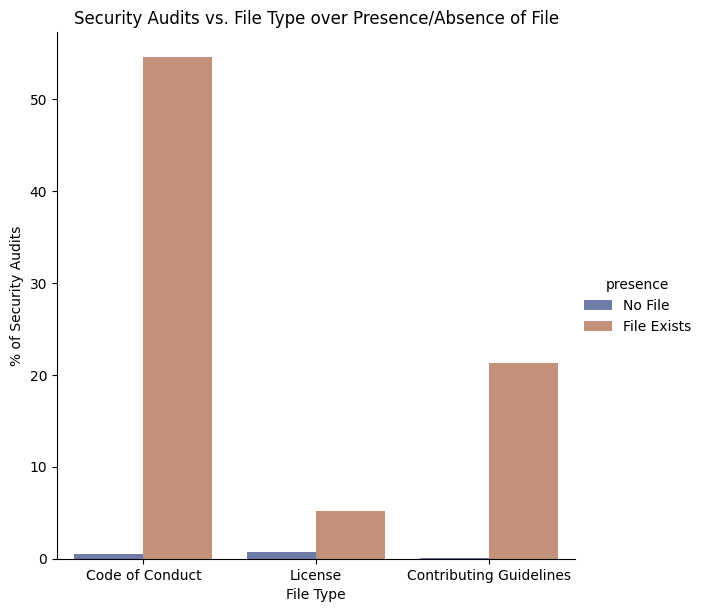

In [ ]:
g = sns.catplot(
    data=df_files, kind="bar",
    x="file_type", y="perc_security_audit", hue="presence",
    errorbar="sd", palette="dark", alpha=.6, height=6
)
_ = g.set(xlabel='File Type', ylabel='% of Security Audits', title="Security Audits vs. File Type over Presence/Absence of File")

Given a project has any of the three files (code of conduct, license, or contributing guidelines), there is a decent proportion of audits for all the external factors. This may be that more thorough documentation in the form of a license or guideline suggests that an audit is also present and the documentation of project security is also thorough. We may consider using these binary features in our predictions.

In [ ]:
%%bigquery dist_external_1 --project $project_id

SELECT (CASE WHEN repository_security_audit_filename <> "" THEN "Security Audit Present" ELSE "No Security Audit" END) as presence_audit,
       (CASE WHEN repository_code_of_conduct_filename <> "" THEN "Code of Conduct Present" ELSE "No Code of Conduct" END) as presence_conduct,
       (CASE WHEN repository_license_filename <> "" THEN "License Present" ELSE "No License File" END) as presence_license,
       (CASE WHEN repository_contributing_guidelines_filename <> "" THEN "Contributing Guidelines Present" ELSE "No Contributing Guidelines" END) as presence_contributing,
       CAST(dependent_repositories_count as FLOAT64) as dependent_repositories_count,
       CAST(dependent_projects_count as FLOAT64) as dependent_projects_count,
       CAST(repository_sourcerank AS FLOAT64) as repository_sourcerank,
       CAST(sourcerank AS FLOAT64) as sourcerank,
FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE dependent_repositories_count IS NOT NULL AND repository_sourcerank IS NOT NULL AND dependent_projects_count IS NOT NULL

Query is running:   0%|          |

Downloading:   0%|          |

Below are histograms of dependency count and source rank facetted over four possible groups formed by splitting on the security audit and one of the three external file factors.

Below are the external factor - security audit facetted plots for dependent project counts:

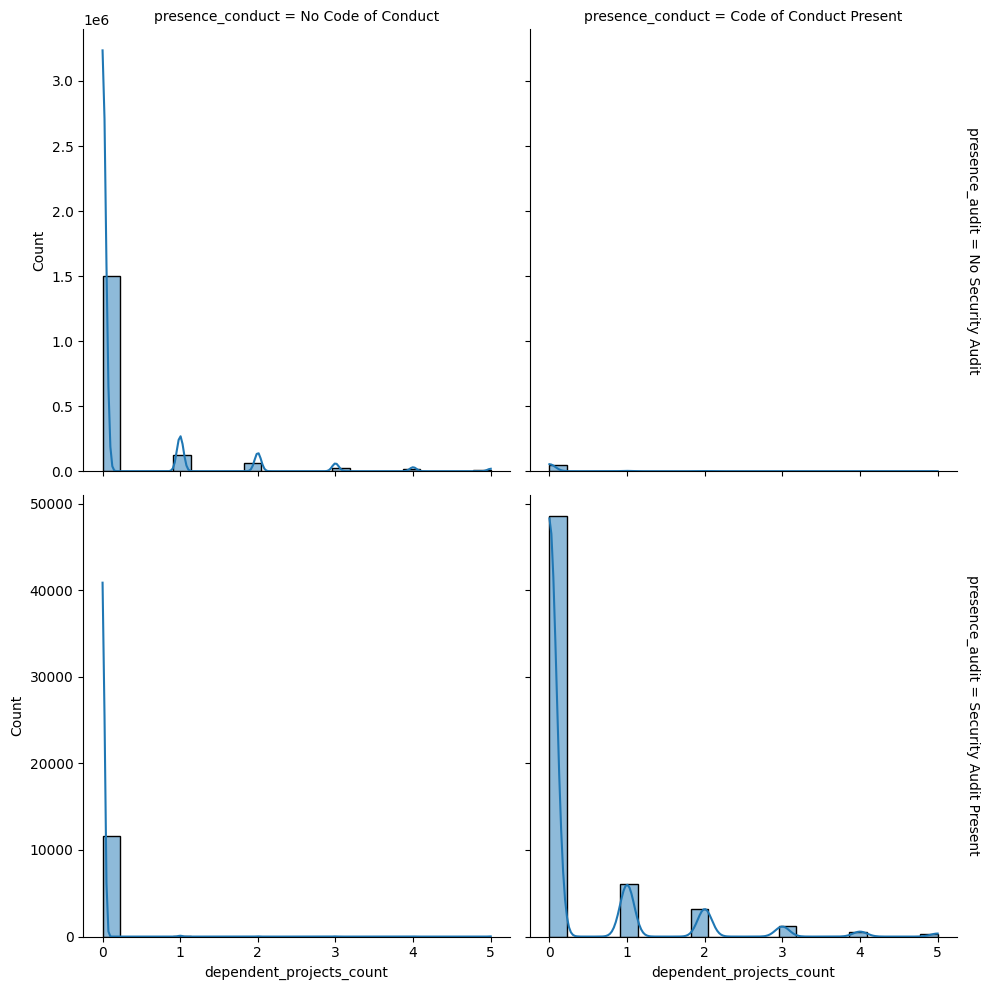

In [ ]:
g = sns.displot(
    dist_external_1[(dist_external_1["dependent_projects_count"] <= 5)],
    x="dependent_projects_count", col="presence_conduct", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

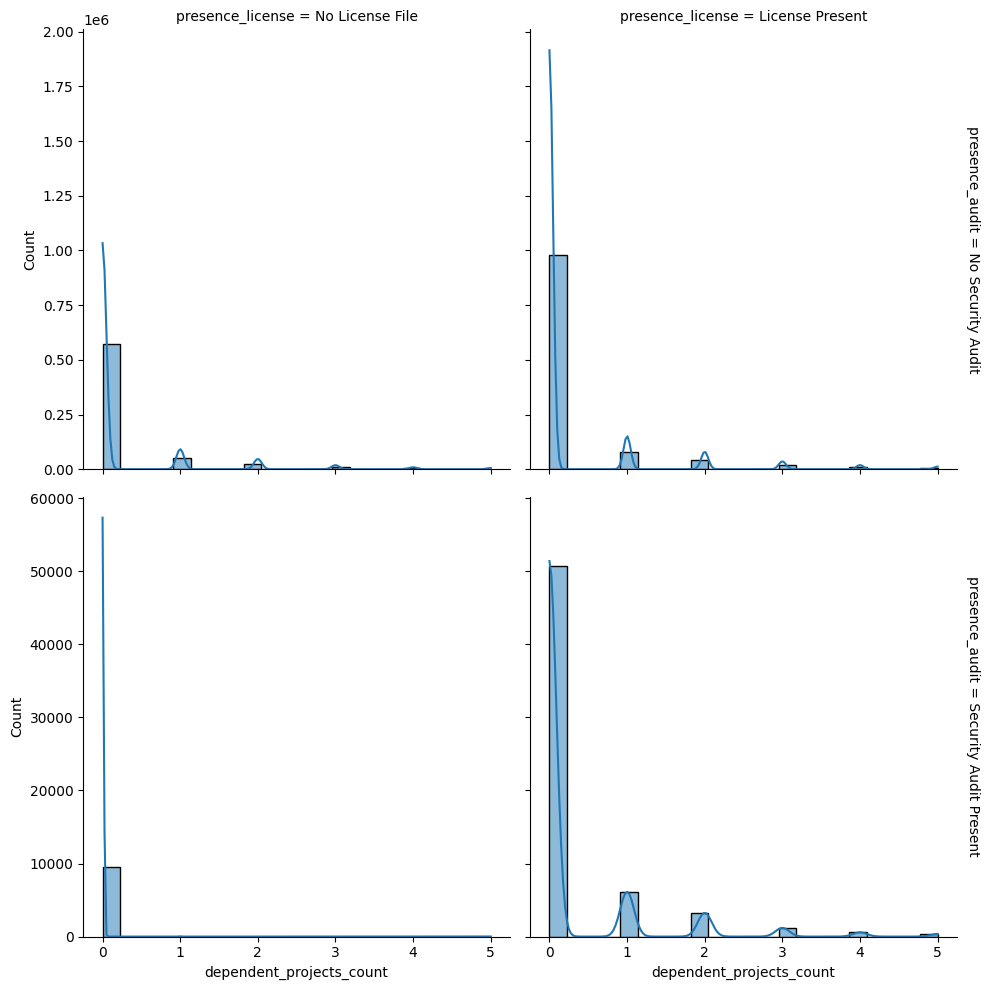

In [ ]:
g = sns.displot(
    dist_external_1[(dist_external_1["dependent_projects_count"] <= 5)],
    x="dependent_projects_count", col="presence_license", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

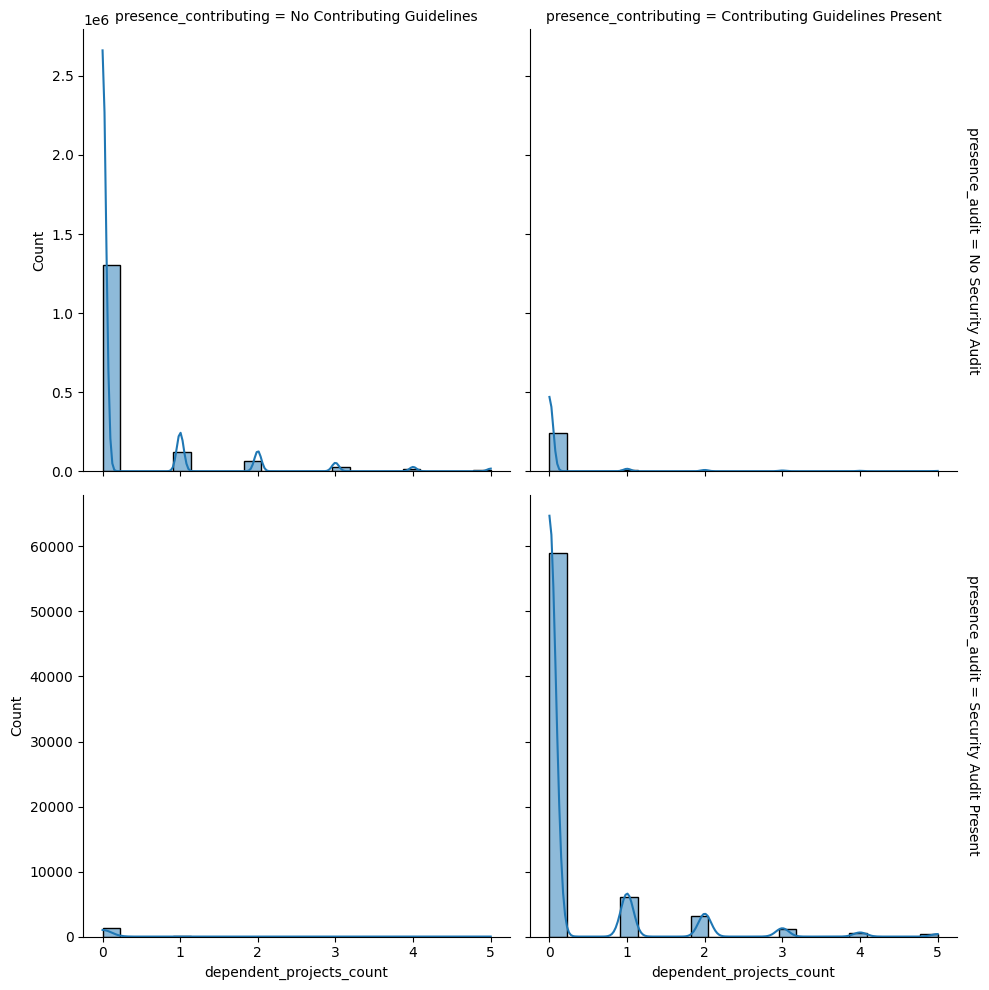

In [ ]:
g = sns.displot(
    dist_external_1[(dist_external_1["dependent_projects_count"] <= 5)],
    x="dependent_projects_count", col="presence_contributing", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

Below are the external factor - security audit facets for dependent repository counts:

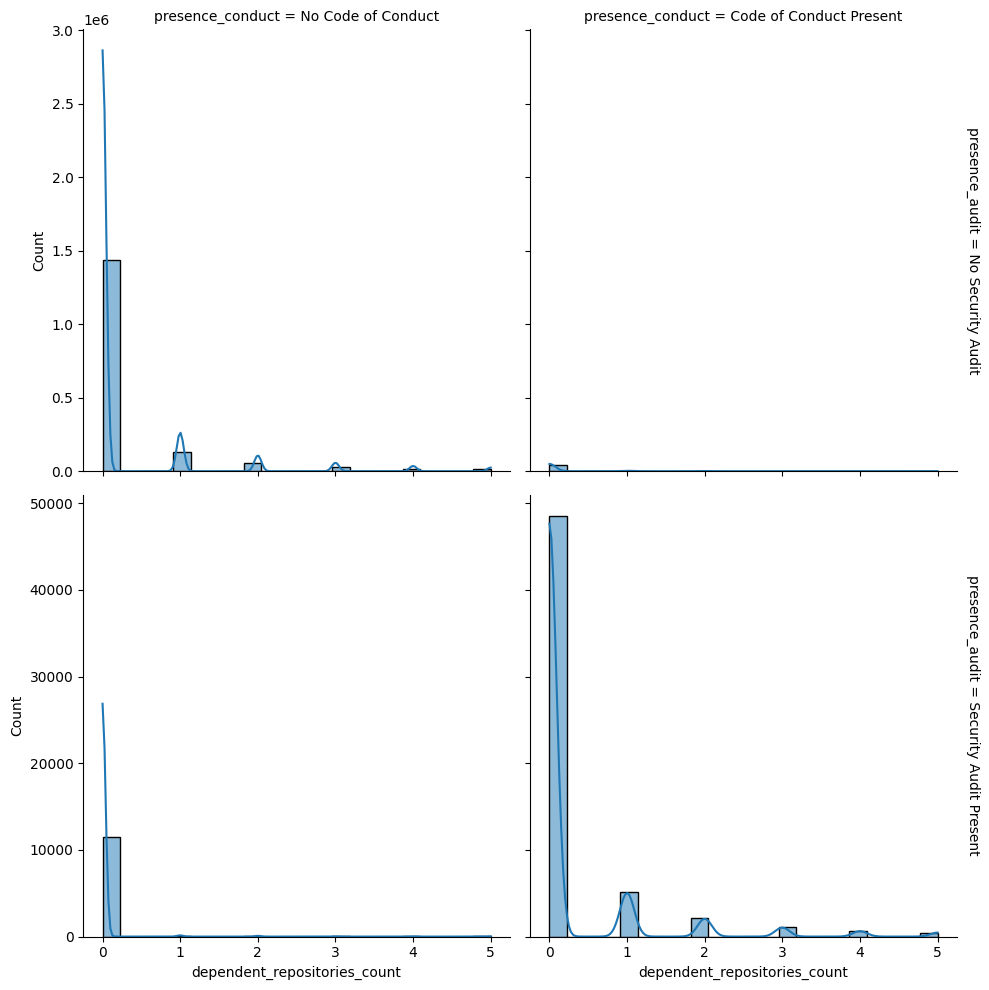

In [ ]:
g = sns.displot(
    dist_external_1[(dist_external_1["dependent_repositories_count"] <= 5)],
    x="dependent_repositories_count", col="presence_conduct", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

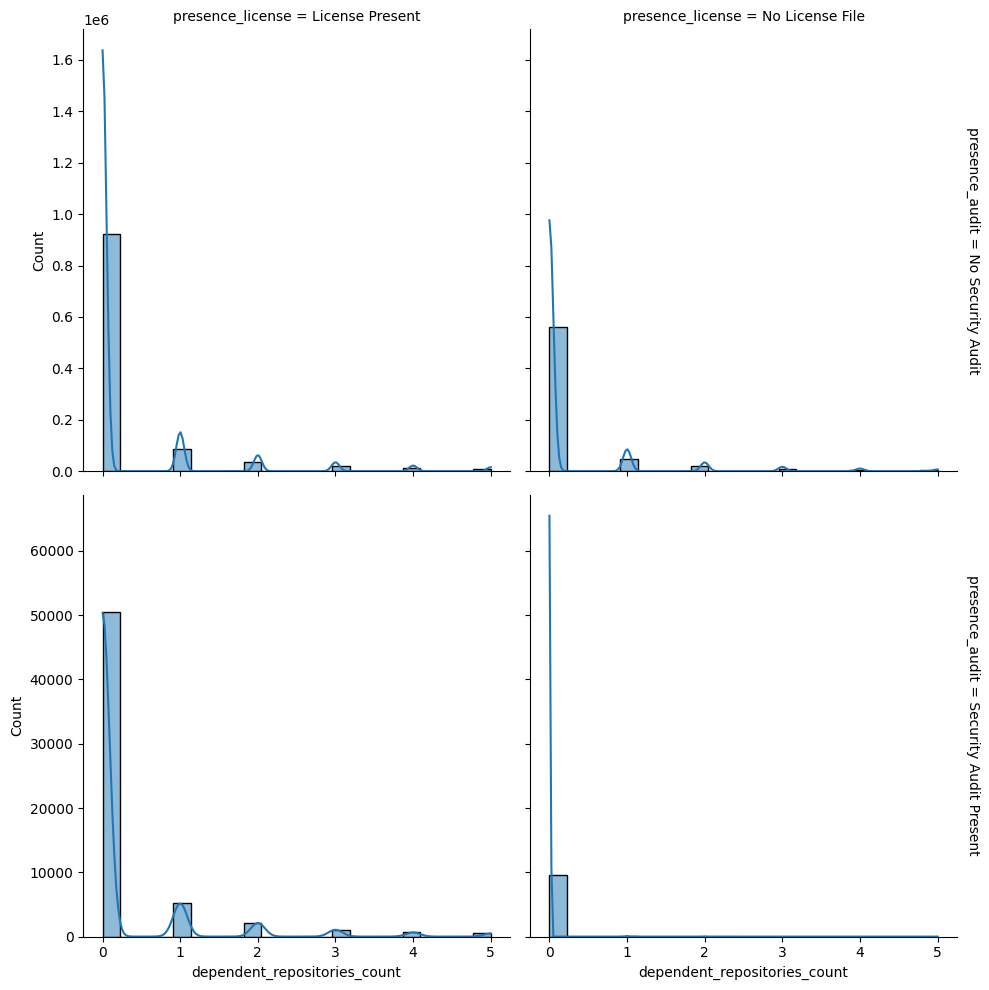

In [ ]:
g = sns.displot(
    dist_external_1[(dist_external_1["dependent_repositories_count"] <= 5)],
    x="dependent_repositories_count", col="presence_license", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

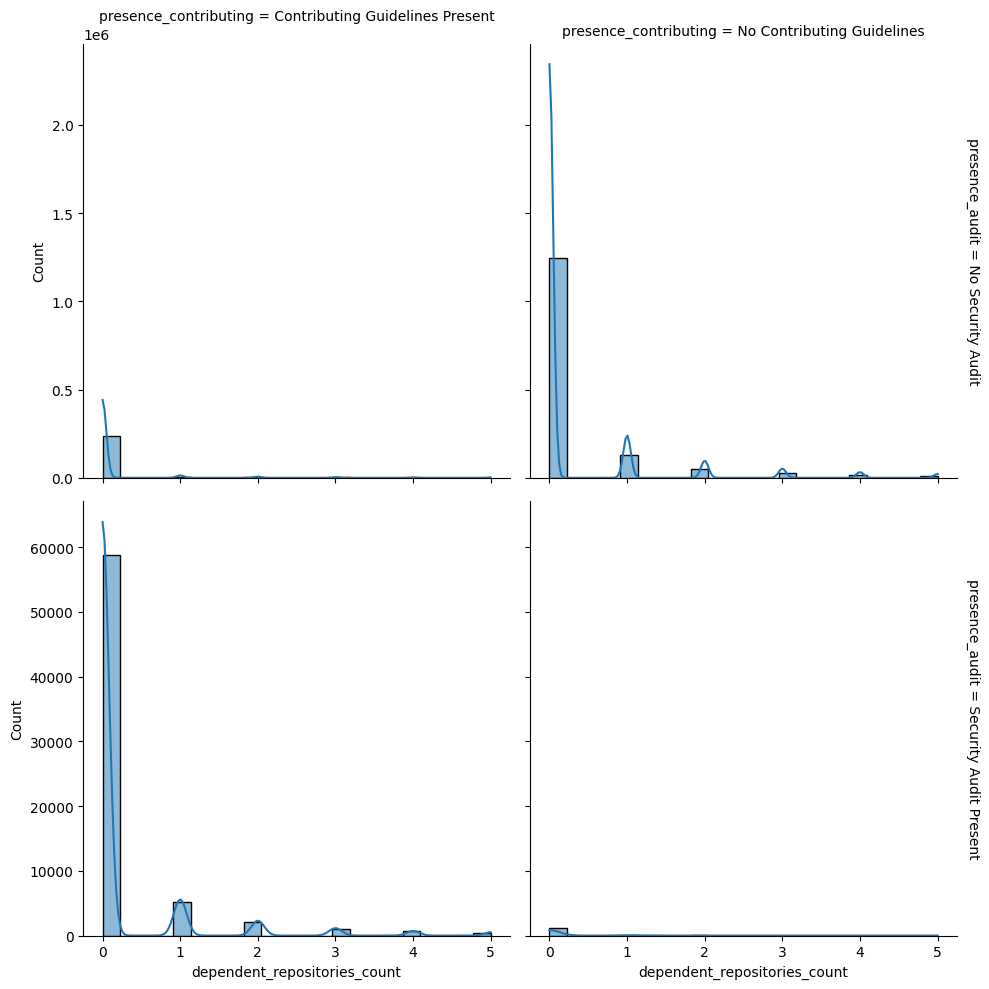

In [ ]:
g = sns.displot(
    dist_external_1[(dist_external_1["dependent_repositories_count"] <= 5)],
    x="dependent_repositories_count", col="presence_contributing", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

Note that the count plots have a larger scale in the first row to reflect the many non-audited projects and a smaller scale in the second row for the audited projects. The count plots above corroborate that a larger proportion of repositories with security audits have code of conduct files whereas a larger proportion of repositories without audits do not have code of conducts. The dependent repository distributions and dependent project distributions are similarly right skewed for the no code of conduct, no audit and code of conduct, audit groups and likewise for the top left and bottom right facetted plots. The same conclusions are reached when we split groups by security audit and the presence of a contributing guidelines file.

When we split by license file and security audit, we do see similar dependency distributions between projects with and without license files among non-audited projects. Across the board, the count distributions of dependent repositories and dependent projects split by security audit and one of the three external factors are similarly right-skewed.

We may see similar amounts of projects with licenses and without licenses because the license file is more of a convention rather than a requirement. Perhaps in some cases, contributing guidelines or code of conduct is strongly recommended and would more likely be included than an optional file such as a license.

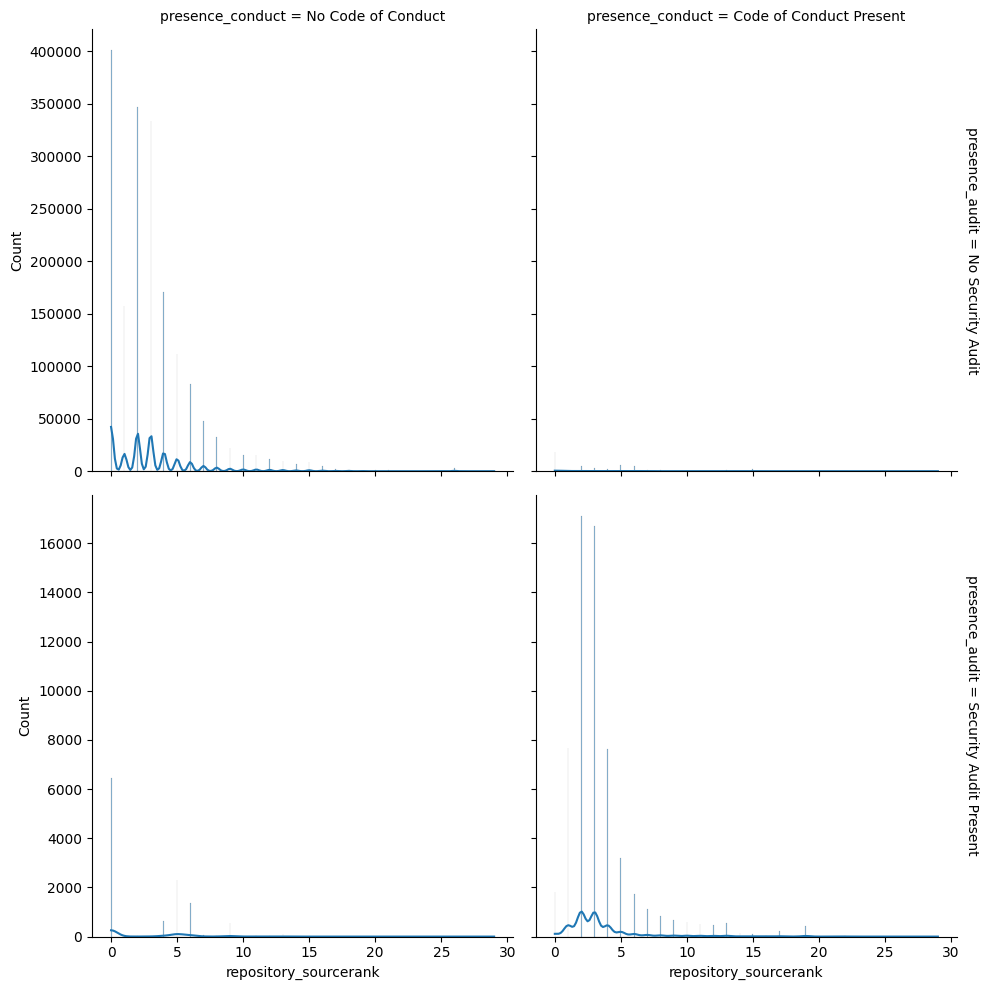

In [ ]:
g = sns.displot(
    dist_external_1,
    x="repository_sourcerank", col="presence_conduct", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

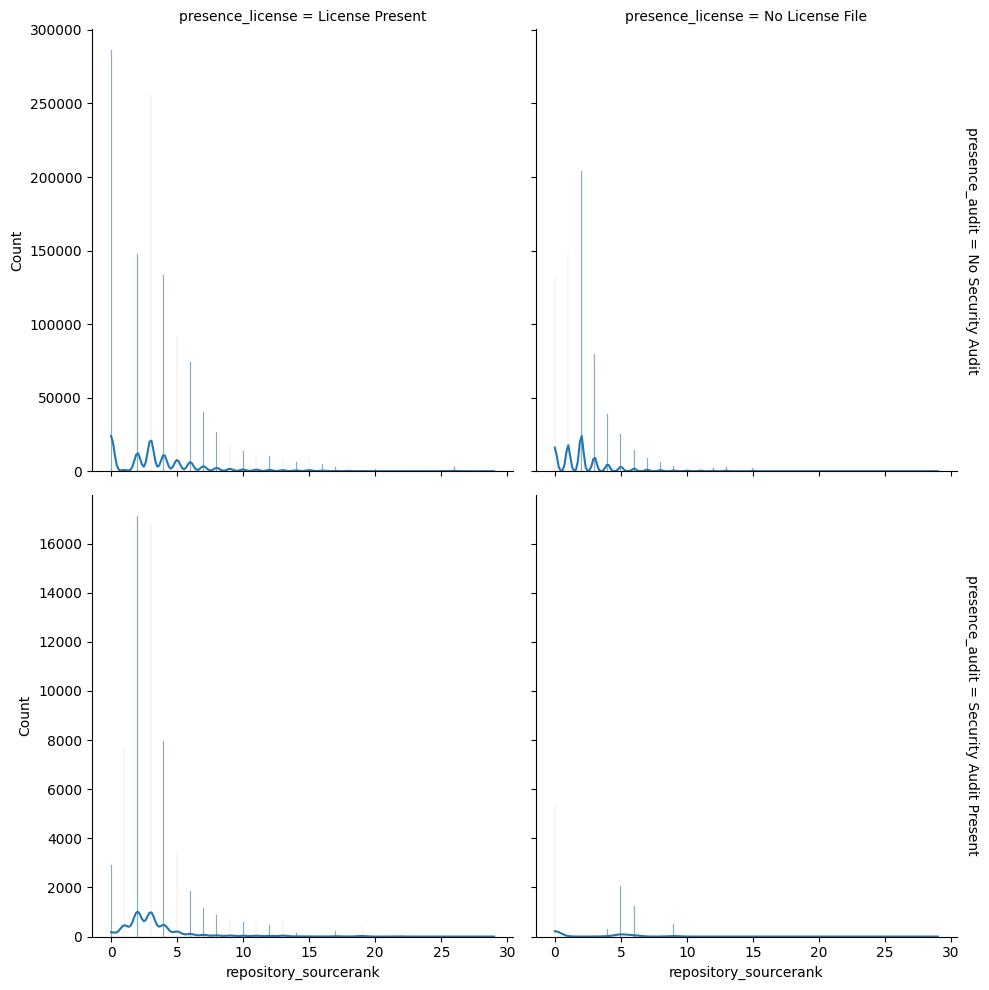

In [ ]:
g = sns.displot(
    dist_external_1,
    x="repository_sourcerank", col="presence_license", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

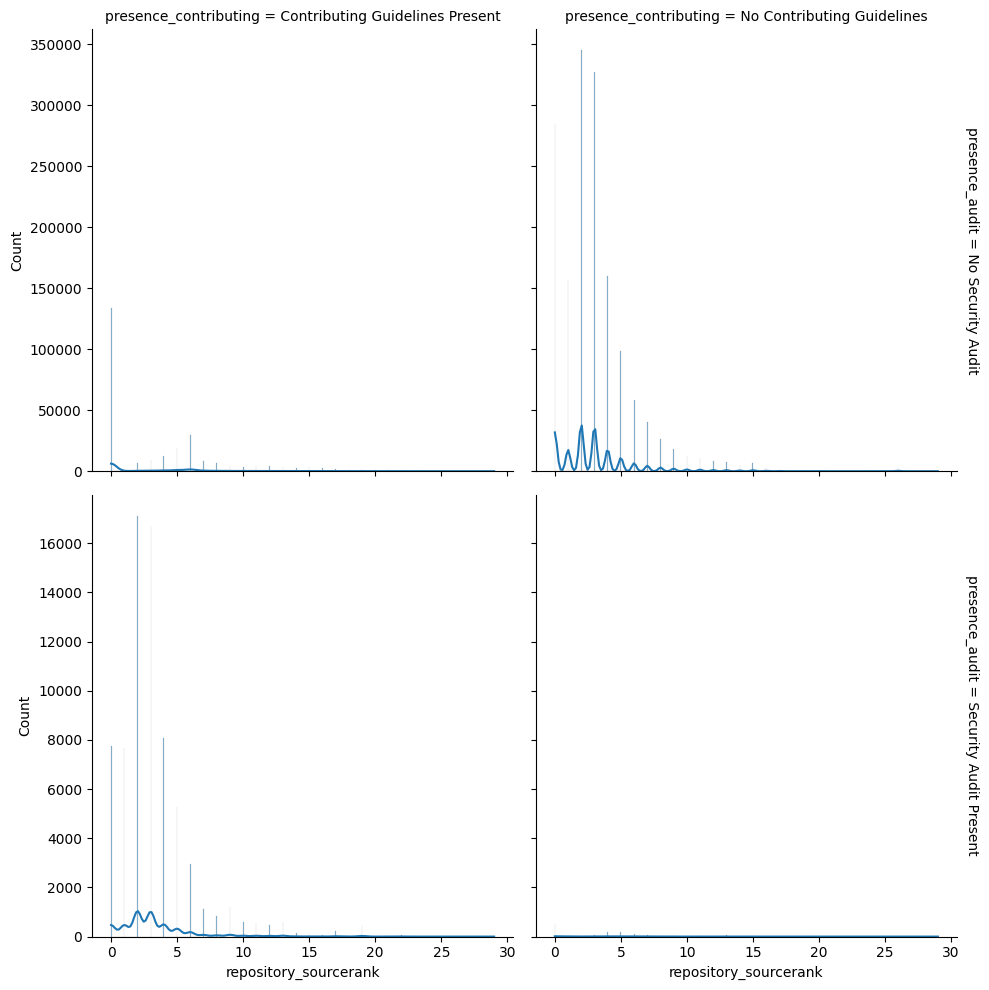

In [ ]:
g = sns.displot(
    dist_external_1,
    x="repository_sourcerank", col="presence_contributing", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

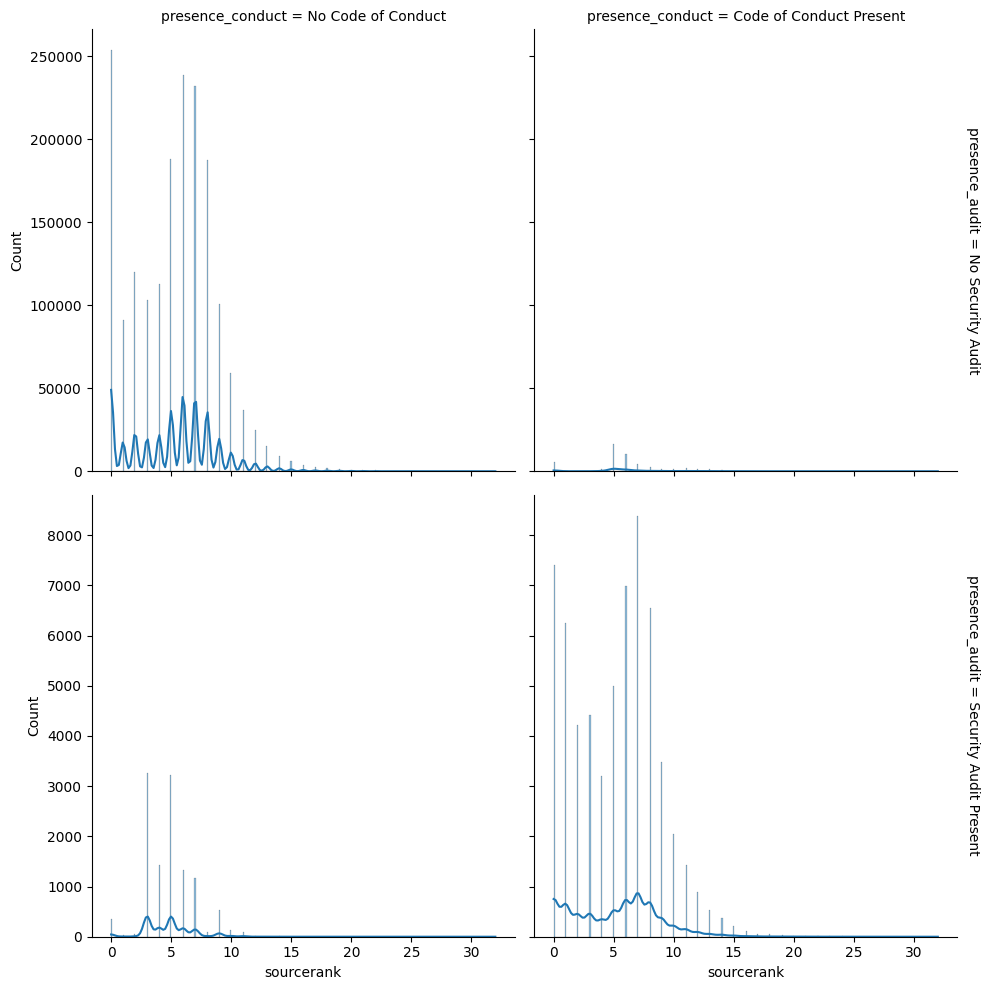

In [ ]:
g = sns.displot(
    dist_external_1,
    x="sourcerank", col="presence_conduct", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

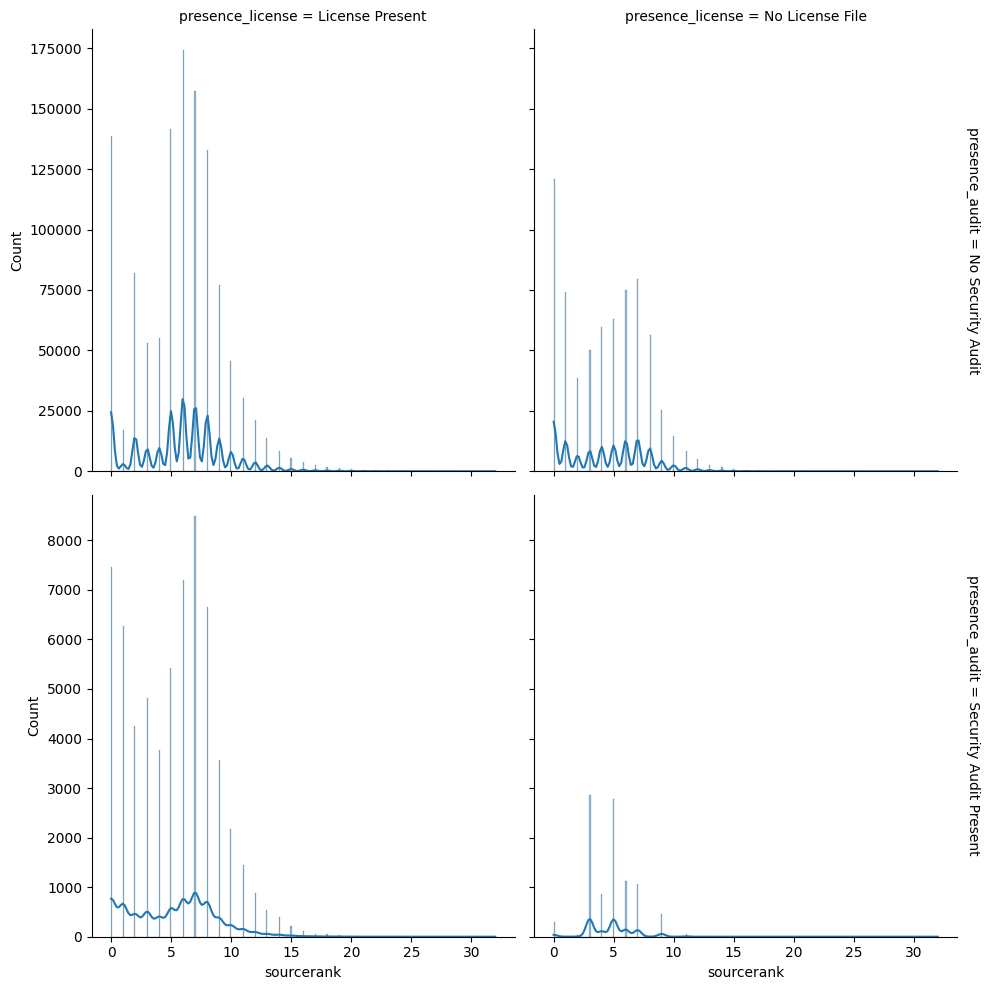

In [ ]:
g = sns.displot(
    dist_external_1,
    x="sourcerank", col="presence_license", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

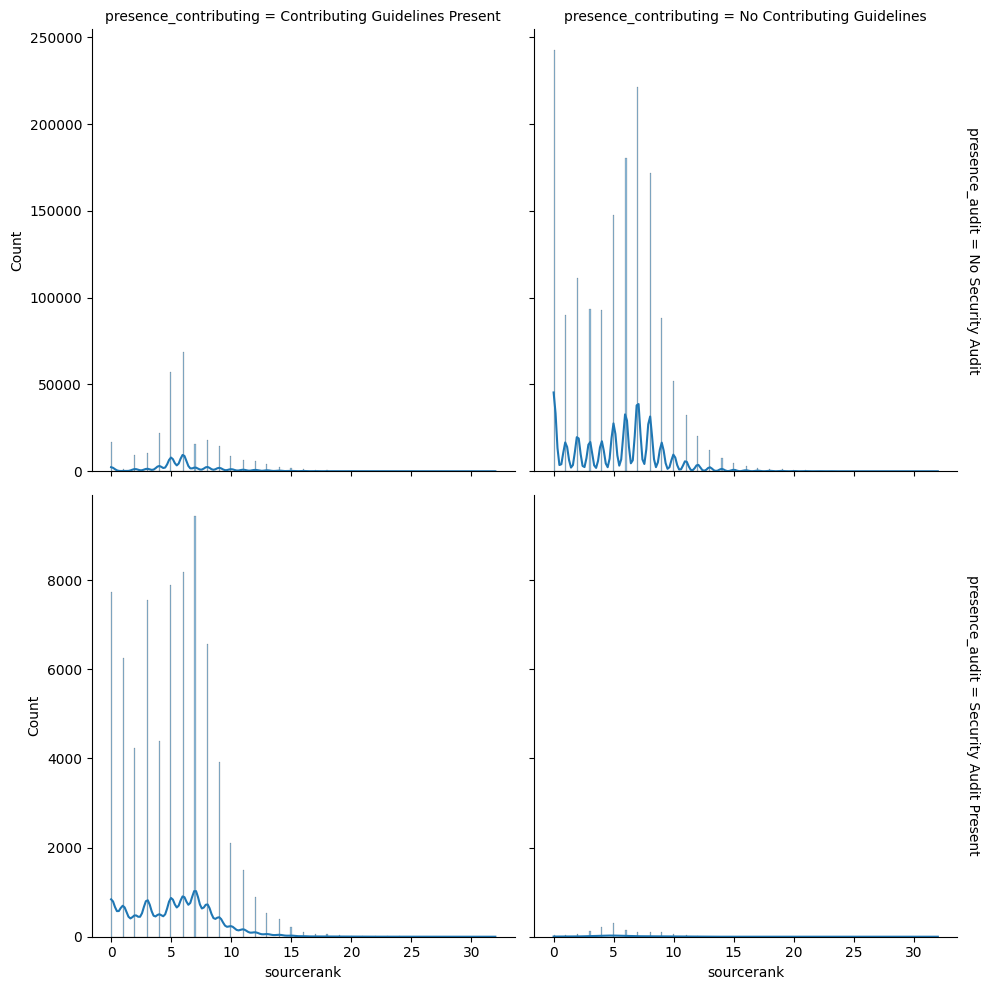

In [ ]:
g = sns.displot(
    dist_external_1,
    x="sourcerank", col="presence_contributing", row="presence_audit",
    kde=True, facet_kws=dict(margin_titles=True, sharex='col', sharey='row'))

After splitting by security audit and code of conduct, non-audited projects without code of conduct files appear to have many projects concentrated around specific top repository source ranks whereas audited projects with code of conduct files have fewer peaks. This could be attributed from non-audited projects having many distinct clusters of projects whereas audited projects may belong to a similar type of project (for instance, web applications based on our keyword analysis). This is also the case when splitting by security audit and contributing guidelines.

The only distinction when splitting by security audit and license file is the roughly equal size of repositories across the source rank distributions for non-audited projects with and without license files. The "with" and "without" license file groups are of similar size, as seen in the dependency count plots, and come from the same group of non-audited projects, which explains their similar multi-model distributions.

When we plot the project source rank over the groups defined by security audit and the three files, we notice the same multi-modal behavior as in the repository soruce rank plots except that project source ranks have a greater concentration over 0-10 project source ranks rather than 0-5 in the repository source ranks.

In turn, including source rank, dependency count, and the presence of these three files into our model would capture some of the associations we observe in the charts above.

#### Trends over time
  * Is there a growing trend in open-source projects including security guidelines or conducting security audits over time?
  * Do projects written in some programming languages have greater rates of adoption of security practices than others? How about with platforms?

Across all projects, we see how the proportion of open-source projects with security audits changes between months. Although we may order by last synced timestamp or created timestamp, the last updated timestamp may better capture shifts in security audits as updates may take place as security practices become more prevalent.

In [ ]:
%%bigquery num_proj_audits_ts --project $project_id

SELECT CONCAT(EXTRACT(YEAR FROM updated_timestamp), "-", IF(EXTRACT(MONTH FROM updated_timestamp) < 10,
CONCAT("0",CAST(EXTRACT(MONTH FROM updated_timestamp) as STRING)),
CAST(EXTRACT(MONTH FROM updated_timestamp) AS STRING) )) as yr_mth,
COUNTIF(repository_security_audit_filename <> "")/COUNT(id) as prop_audits FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
GROUP BY yr_mth
ORDER BY yr_mth

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=num_proj_audits_ts["yr_mth"], y=num_proj_audits_ts["prop_audits"],
                         line=dict(color='royalblue', width=4)))
fig.update_layout(title='Proportion of Projects With Security Audits Per Month (Jan 2017-Mar 2018)',
                   xaxis_title='Month',
                   yaxis_title='% of Projects With Security Audits By Month')
fig.update_yaxes(tickformat="0%")

fig.show()

The above query and line chart looks into how the proportion of projects with a security audit changed for those that were created between Jan 2015 and March 2018. About 15% of projects created in Jan 2016 and Mar 2017 had security audits, but the projects created in the months following those peaks had similar proportions of security audits. Given the consistently low rate of security audits across most months, it is possible that there were not many major events related to security updates over the course of the libraries io project updates from 2017 to 2018 except for March 2017.

In [ ]:
%%bigquery host_type_ts --project $project_id

SELECT repository_host_type,
CONCAT(EXTRACT(YEAR FROM updated_timestamp), "-", IF(EXTRACT(MONTH FROM updated_timestamp) < 10,
CONCAT("0",CAST(EXTRACT(MONTH FROM updated_timestamp) as STRING)),
CAST(EXTRACT(MONTH FROM updated_timestamp) AS STRING) )) as yr_mth,
COUNTIF(repository_security_audit_filename <> "")/COUNT(id) as prop_audits FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
WHERE repository_host_type != ""
GROUP BY repository_host_type, yr_mth
ORDER BY repository_host_type, yr_mth

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
fig = go.Figure()

dat_github = host_type_ts[host_type_ts["repository_host_type"]=="GitHub"]
dat_gitlab = host_type_ts[host_type_ts["repository_host_type"]=="GitLab"]
dat_bitbucket = host_type_ts[host_type_ts["repository_host_type"]=="Bitbucket"]
fig.add_trace(go.Scatter(x=dat_github["yr_mth"], y=dat_github["prop_audits"], name='GitHub',
                         line=dict(color='royalblue', width=4)))
fig.add_trace(go.Scatter(x=dat_gitlab["yr_mth"], y=dat_gitlab["prop_audits"], name='GitLab',
                         line=dict(color='firebrick', width=4)))
fig.add_trace(go.Scatter(x=dat_bitbucket["yr_mth"], y=dat_bitbucket["prop_audits"], name='Bitbucket',
                         line=dict(color='darkorange', width=4)))

fig.update_layout(title='Proportion of Projects With Security Audits By Repository Host Type (Jan 2017-Mar 2018)',
                   xaxis_title='Year-Month',
                   yaxis_title='% of Projects With Security Audits By Month')
fig.update_yaxes(tickformat="0%")

fig.show()

After breaking down the security audit rate per month by repository host type, we can see Bitbucket having the greatest spike in projects with security audits in March 2017 at 54-55%. One event that may be relevant to the spike could be [Atlassian strengthening Bitbucket's security](https://www.linkedin.com/pulse/atlassian-adds-two-layered-security-bitbucket-abhinav) in March of 2017, but further research and analysis would be required to confirm this.

In [ ]:
%%bigquery prop_language_time --project $project_id

# how do the programming languages with the top 3 proportion of security audits change over time?
WITH language_props AS
(
  SELECT
  CONCAT(EXTRACT(YEAR FROM updated_timestamp), "-", IF(EXTRACT(MONTH FROM updated_timestamp) < 10,
  CONCAT("0",CAST(EXTRACT(MONTH FROM updated_timestamp) as STRING)),
  CAST(EXTRACT(MONTH FROM updated_timestamp) AS STRING) )) as yr_mth, repository_language,
  100*COUNTIF(repository_security_audit_filename <> "")/COUNT(id) as prop_audits FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
  GROUP BY yr_mth, repository_language
  HAVING COUNT(id) > 10
  ORDER BY yr_mth, repository_language
)
SELECT * FROM (SELECT yr_mth, repository_language, prop_audits, ROW_NUMBER() OVER (PARTITION BY yr_mth ORDER BY prop_audits DESC) as rk
FROM language_props
ORDER BY yr_mth ASC, prop_audits DESC)
where rk <= 3

Query is running:   0%|          |

Downloading:   0%|          |

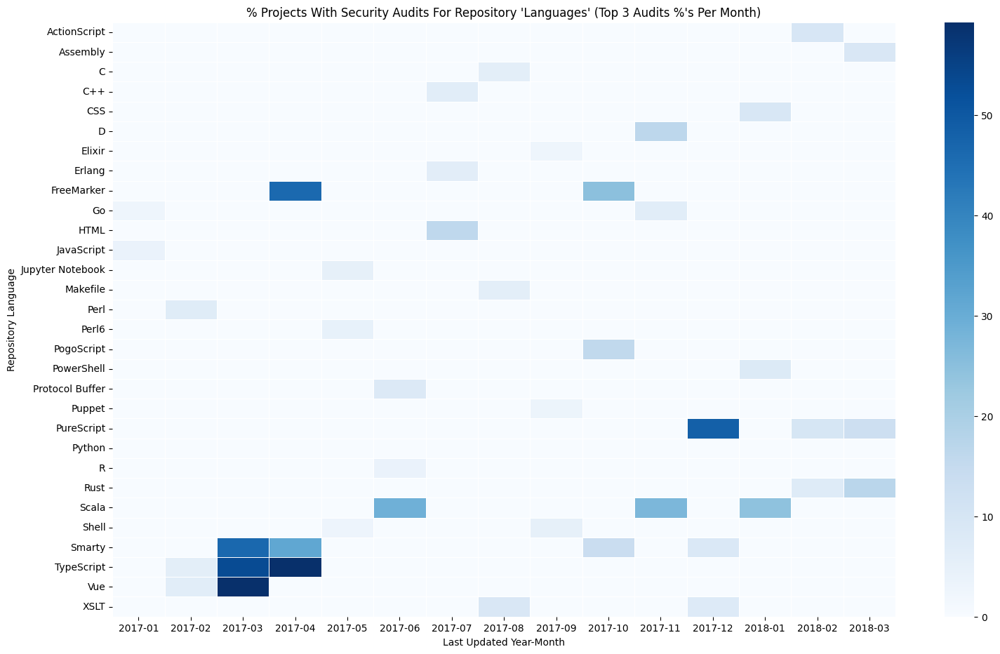

In [ ]:
plt.figure(figsize=(18, 11))
heatmap_data = prop_language_time.pivot_table(index='repository_language', columns='yr_mth', values='prop_audits', aggfunc=np.sum, fill_value=0)

sns.heatmap(heatmap_data, cmap='Blues', linewidths=.5)

plt.title("% Projects With Security Audits For Repository 'Languages' (Top 3 Audits %'s Per Month)")
plt.xlabel('Last Updated Year-Month')
plt.ylabel('Repository Language')
plt.show()

In [ ]:
%%bigquery prop_platform_time --project $project_id

WITH platform_props AS
(
  SELECT
  CONCAT(EXTRACT(YEAR FROM updated_timestamp), "-", IF(EXTRACT(MONTH FROM updated_timestamp) < 10,
  CONCAT("0",CAST(EXTRACT(MONTH FROM updated_timestamp) as STRING)),
  CAST(EXTRACT(MONTH FROM updated_timestamp) AS STRING) )) as yr_mth, platform,
  100*COUNTIF(repository_security_audit_filename <> "")/COUNT(id) as prop_audits FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
  GROUP BY yr_mth, platform
  HAVING COUNT(id) > 10
  ORDER BY yr_mth, platform
)
SELECT * FROM (SELECT yr_mth, platform, prop_audits, ROW_NUMBER() OVER (PARTITION BY yr_mth ORDER BY prop_audits DESC) as rk
FROM platform_props
ORDER BY yr_mth ASC, prop_audits DESC)
where rk <= 3

Query is running:   0%|          |

Downloading:   0%|          |

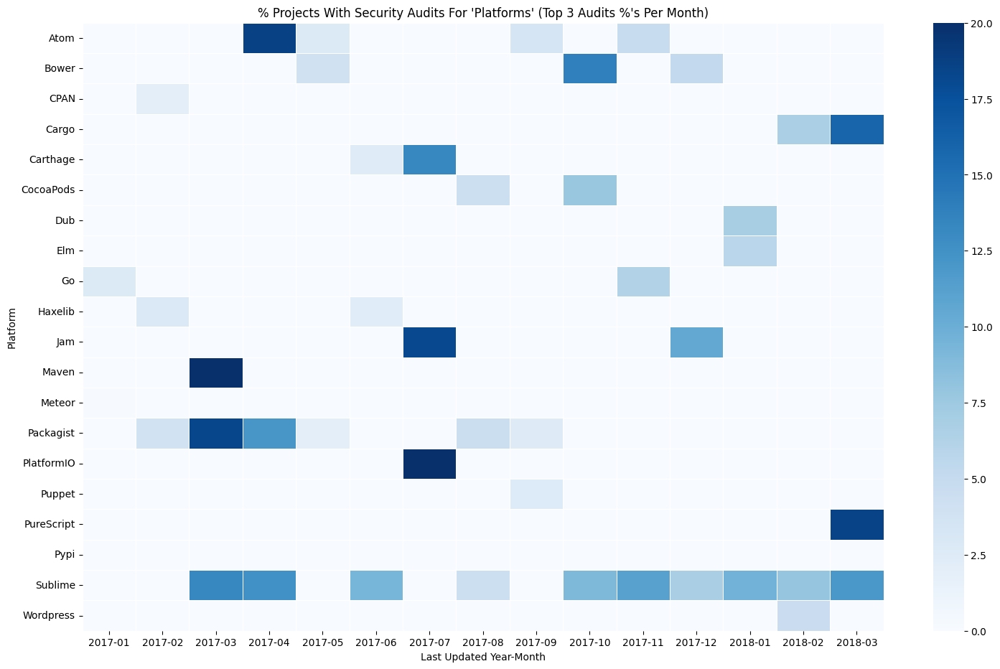

In [ ]:
plt.figure(figsize=(18, 11))
heatmap_data = prop_platform_time.pivot_table(index='platform', columns='yr_mth', values='prop_audits', aggfunc=np.sum, fill_value=0)

sns.heatmap(heatmap_data, cmap='Blues', linewidths=.5)

plt.title("% Projects With Security Audits For 'Platforms' (Top 3 Audits %'s Per Month)")
plt.xlabel('Last Updated Year-Month')
plt.ylabel('Platform')
plt.show()

For each updated year and month, there's a clear depiction of the top 3 security audited repository languages from that time period based on the shading. Some notable months are March 2017 (Smarty, TypeScript, Vue) and April 2017 (TypeScript, Smarty, FreeMarker). It appears that some of the languages with high proportions of audits is consistent with web-application projects (e.g., Vue, TypeScript). Across different platforms, sublime, packagist, and maven are platforms that stand out as having high rates of security audits. It is possible that certain language types such as TypeScript or Vue have higher rates of security audits in certain months because there were more web application-related projects updated in that month (TypeScript and Vue may be used for web development projects).

From our exploratory data analysis (EDA), we found that the count of repository watchers, stars, forks, project versions count, and number of dependent repositories did not appear to be strongly associated with the rate of security audits in open source software projects, but still consider them in our models to see what improvements they make in model performance.  

The `status` feature that we wanted to use as a proxy for the activity in a project was not as diverse as we had anticipated - after joining projects with the repositories to obtain security file information for projects, we found that the statuses were either None (active) or unmaintained. In turn, we used repository tags and project versions are proxies for activity of an open source software package, but noted their limited utility for prediction. As aforementioned, the project versions count is not associated with the rate of audits. However, we found that audited projects tend to have higher repository tag counts. The issue is that the overlap between the repository ids in the projects with repository fields table (main table for training, validation, test data) and repository table ids is quite low, so we exclude the tag counts of repositories due to missingness.

Based on  outside research, we exclude the code of conduct feature because we found that many projects with security leaks that have had security audits have a code of conduct with a protocol on how to proceed with the leak.

## Baseline and Data Prediction

---
After exploratory data analysis, we construct a model using the features that may influence the likelihood of a given project having a security audit. We use the repository's `host type` (ignore empty strings) as we see slight differences between the security audit present/absent distributions. Similarly, with regards, we found there are a handful of programming `languages` and `platforms` that have a higher than expected proportion of projects with security audits, so we include these features too. `updated_timestamp` and the presence of the files `contributing_guidelines` and `license` are included as well. We do not consider the presence of the code of conduct file because outside research suggests that projects with a security audit are more prone to having a code of conduct file that details the protocol on how to handle the security leaks that led to the audit. We test the efficacy of this list of features:

1. last_updated_timestamp
2. repository_host_type
3. repository_sourcerank
4. sourcerank
5. repository_watchers_count
6. repository_stars_count
7. repository_forks_count
8. presence_license
9. presence_contributing
10. versions_count_bucket
11. presence_of_keyword
12. dependent_repositories_count
13. dependent_projects_count
14. presence_high_audit_rate_languages
15. presence_high_audit_rate_platforms
16. average_word_length
16. prop_unique_words
---

In [ ]:
model_dataset_name = 'libraries_io_proj2'

dataset = bigquery.Dataset(client.dataset(model_dataset_name))
dataset.location = 'US'
client.create_dataset(dataset)

We take 80% for training and 20% for testing. 20% of the training data is used for validation. There is a total of 1,829,779 rows in the projects with repository fields table that do not have null values for the features that we are using in our model, so we allocate 1,097,000+ to training, 365,000+ to validation, and 366,000+ to testing.

KNN in Big Query on the Data:

In [ ]:
%%bigquery --project $project_id

CREATE OR REPLACE TABLE libraries_io_proj2.SplitData AS

WITH
Statistics AS (
    SELECT
      AVG(repository_sourcerank) AS avg_repository_sourcerank,
      STDDEV(repository_sourcerank) AS stddev_repository_sourcerank,
      AVG(sourcerank) AS avg_project_sourcerank,
      STDDEV(sourcerank) AS stddev_project_sourcerank,
      AVG(repository_watchers_count) AS avg_repo_watchers,
      STDDEV(repository_watchers_count) AS stddev_repo_watchers,
      AVG(repository_stars_count) AS avg_repo_stars,
      STDDEV(repository_stars_count) AS stddev_repo_stars,
      AVG(repository_forks_count) AS avg_repo_forks,
      STDDEV(repository_forks_count) AS stddev_repo_forks,
      AVG(UNIX_SECONDS(updated_timestamp)) as avg_timestamp,
      STDDEV(UNIX_SECONDS(updated_timestamp)) as stddev_timestamp,
      AVG(CAST(dependent_repositories_count AS FLOAT64)) as avg_dep_repos,
      STDDEV(CAST(dependent_repositories_count AS FLOAT64)) as stddev_dep_repos,
      AVG(CAST(dependent_projects_count AS FLOAT64)) as avg_dep_projs,
      STDDEV(CAST(dependent_projects_count AS FLOAT64)) as stddev_dep_projs
    FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`
  ),
  PreprocessedData AS (
    SELECT
      id,
      IF(repository_security_audit_filename IS NOT NULL AND TRIM(repository_security_audit_filename) != '', 1, 0 ) AS has_security_audit,
      (UNIX_SECONDS(updated_timestamp)-avg_timestamp)/stddev_timestamp AS normalized_timestamp_numeric,
      IF(repository_contributing_guidelines_filename IS NOT NULL AND TRIM(repository_contributing_guidelines_filename) != '', 1, 0) AS has_contributing_guidelines,
      IF(repository_license_filename IS NOT NULL AND TRIM(repository_license_filename) != "", 1, 0) AS has_license,
      IF(repository_code_of_conduct_filename IS NOT NULL AND TRIM(repository_code_of_conduct_filename) != "", 1, 0) AS has_code_of_conduct,
      (repository_sourcerank - avg_repository_sourcerank) / stddev_repository_sourcerank AS normalized_repository_sourcerank,
      (sourcerank - avg_project_sourcerank) / stddev_project_sourcerank AS normalized_project_sourcerank,
      (repository_watchers_count - avg_repo_watchers) / stddev_repo_watchers AS normalized_repository_watchers,
      (repository_stars_count - avg_repo_stars) / stddev_repo_stars AS normalized_repository_stars,
      (repository_forks_count - avg_repo_forks) / stddev_repo_forks AS normalized_repository_forks,
      (CAST(dependent_repositories_count AS FLOAT64)-avg_dep_repos)/stddev_dep_repos as normalized_dependent_repositories_count,
      (CAST(dependent_projects_count AS FLOAT64)-avg_dep_projs)/stddev_dep_projs as normalized_dependent_projects_count,
      IF(repository_host_type = 'GitHub', 1, 0) AS is_github,
      IF(repository_host_type = 'GitLab', 1, 0) AS is_gitlab,
      IF(repository_host_type = 'Bitbucket', 1, 0) AS is_bitbucket,
      (CASE WHEN (LOWER(description) LIKE "%juju%" OR
  LOWER(description) LIKE "%devops%" OR LOWER(description) LIKE "%distilled%"
  OR LOWER(description) LIKE "%typings%"
  OR LOWER(description) LIKE "%crate%"
  OR LOWER(description) LIKE "%ffi%"
  OR LOWER(description) LIKE "%placeholder%") THEN 1 ELSE 0 END) as presence_of_keyword,
      IF(versions_count = 0, 1, 0) AS version_bucket1,
      IF(versions_count BETWEEN 1 AND 2, 1, 0) AS version_bucket2,
      IF(versions_count BETWEEN 3 AND 5, 1, 0) AS version_bucket3,
      IF(versions_count >= 6, 1, 0) AS version_bucket4,
      IF(repository_language = "Prolog",1,0) as presence_high_audit_rate_language,
      IF(platform = "PureScript", 1, 0) as presence_high_audit_rate_platform,
    FROM `bigquery-public-data.libraries_io.projects_with_repository_fields`, Statistics
    WHERE repository_sourcerank IS NOT NULL
    AND versions_count IS NOT NULL
    AND description IS NOT NULL AND description <> ""
    AND sourcerank IS NOT NULL
    AND repository_watchers_count IS NOT NULL
    AND repository_stars_count IS NOT NULL
    AND repository_forks_count IS NOT NULL
    AND dependent_repositories_count IS NOT NULL
    AND dependent_projects_count IS NOT NULL
    AND repository_host_type IS NOT NULL
  ),
  RandData AS
  (
    SELECT PreprocessedData.*, ABS(RAND()) AS split_field FROM PreprocessedData
  )
SELECT RandData.*, (CASE WHEN split_field BETWEEN 0 AND 0.6 THEN "train"
                         WHEN split_field > 0.6 AND split_field <= 0.8 THEN "validation"
                         ELSE "test" END) as data_group
FROM RandData

Query is running:   0%|          |

""


In [ ]:
%%bigquery --project $project_id

CREATE OR REPLACE TABLE libraries_io_proj2.SplitData AS

WITH average_word_length_table
AS
(
  SELECT
  id,
  description,
  AVG(LENGTH(word)) AS avg_word_length
FROM (
  SELECT
    id,
    description,
    word
  FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`,
    UNNEST(SPLIT(TRIM(LOWER(description)), " ")) AS word
)
GROUP BY
 id, description
),
Statistics AS (
    SELECT AVG(avg_word_length) as avg_average_word_length,
    STDDEV(avg_word_length) as stddev_average_word_length
    FROM average_word_length_table
)
SELECT t1.id, has_security_audit, normalized_timestamp_numeric,
      has_contributing_guidelines,has_license,has_code_of_conduct, normalized_repository_sourcerank,
      normalized_project_sourcerank,
      normalized_repository_watchers,
      normalized_repository_stars,
      normalized_repository_forks,
      normalized_dependent_repositories_count,
      normalized_dependent_projects_count,
      is_github,
      is_gitlab,
      is_bitbucket,
      presence_of_keyword,
      version_bucket1,
      version_bucket2,
      version_bucket3,
      version_bucket4,
      presence_high_audit_rate_language,
      presence_high_audit_rate_platform,
      data_group,
      (avg_word_length-avg_average_word_length)/stddev_average_word_length as normalized_average_word_length
      FROM libraries_io_proj2.SplitData t1 LEFT JOIN average_word_length_table t2
ON t1.id = t2.id, Statistics

Query is running:   0%|          |

""


In [ ]:
%%bigquery --project $project_id

CREATE OR REPLACE TABLE libraries_io_proj2.SplitData AS

WITH prop_unique_table
AS
(
  WITH table1 AS
(
  SELECT
    id,
    description,
    word,
    COUNT(*) as word_count
  FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`,
    UNNEST(SPLIT(TRIM(LOWER(description)), " ")) AS word
  GROUP BY id, description, word
) SELECT
  t1.id,
  t1.description,
  COUNTIF(t2.word_count=1)/COUNT(*) AS prop_unique
FROM (
  SELECT
    id,
    description,
    word
  FROM
    `bigquery-public-data.libraries_io.projects_with_repository_fields`,
    UNNEST(SPLIT(TRIM(LOWER(description)), " ")) AS word
) t1 JOIN table1 t2 ON t1.id = t2.id AND t1.description = t2.description
AND t1.word = t2.word
GROUP BY
 t1.id, t1.description
),
Statistics AS (
    SELECT AVG(prop_unique) as avg_prop_unique,
    STDDEV(prop_unique) as stddev_prop_unique
    FROM prop_unique_table
)
SELECT t1.id, has_security_audit, normalized_timestamp_numeric,
      has_contributing_guidelines,has_license,has_code_of_conduct, normalized_repository_sourcerank,
      normalized_project_sourcerank,
      normalized_repository_watchers,
      normalized_repository_stars,
      normalized_repository_forks,
      normalized_dependent_repositories_count,
      normalized_dependent_projects_count,
      is_github,
      is_gitlab,
      is_bitbucket,
      presence_of_keyword,
      version_bucket1,
      version_bucket2,
      version_bucket3,
      version_bucket4,
      presence_high_audit_rate_language,
      presence_high_audit_rate_platform,
      data_group,
      normalized_average_word_length,
      (prop_unique-avg_prop_unique)/stddev_prop_unique as normalized_prop_unique
      FROM libraries_io_proj2.SplitData t1 LEFT JOIN prop_unique_table t2
ON t1.id = t2.id, Statistics

Query is running:   0%|          |

""


In [ ]:
%%bigquery --project $project_id

SELECT * FROM libraries_io_proj2.SplitData

Query is running:   0%|          |

Downloading:   0%|          |

,id,has_security_audit,normalized_timestamp_numeric,has_contributing_guidelines,has_license,has_code_of_conduct,normalized_repository_sourcerank,normalized_project_sourcerank,normalized_repository_watchers,normalized_repository_stars,...,presence_of_keyword,version_bucket1,version_bucket2,version_bucket3,version_bucket4,presence_high_audit_rate_language,presence_high_audit_rate_platform,data_group,normalized_average_word_length,normalized_prop_unique
0,204997,0,1.388630,0,1,0,4.114723,5.340617,0.788108,2.150440,...,0,0,0,0,1,0,0,validation,0.012154,-2.717970
1,631680,0,1.432260,0,1,0,4.114723,5.340617,1.305471,0.915150,...,0,0,0,0,1,0,0,test,-0.222981,0.356501
2,308073,0,1.476905,1,1,0,4.114723,5.340617,11.266653,17.899354,...,0,0,0,0,1,0,0,train,0.232528,0.356501
3,1139464,0,1.395849,0,1,0,4.114723,5.340617,-0.076739,-0.078124,...,0,0,0,0,1,0,0,train,-0.011043,0.356501
4,739353,0,1.470342,0,1,0,4.114723,5.340617,0.842161,1.672366,...,0,0,0,0,1,0,0,test,0.093344,0.356501
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1829774,5977,0,1.209898,0,0,0,2.034541,2.136964,0.278466,0.770765,...,0,1,0,0,0,0,0,test,0.162936,0.356501
1829775,911525,0,1.474015,0,1,0,2.034541,2.136964,-0.045852,-0.026329,...,0,1,0,0,0,0,0,test,-0.002344,0.356501
1829776,999201,0,1.446092,0,1,0,2.034541,2.136964,-0.053574,-0.028163,...,0,1,0,0,0,0,0,test,-0.080635,0.356501
1829777,1358866,0,1.431686,1,1,0,2.034541,2.136964,0.278466,-0.091875,...,0,0,0,0,1,0,0,train,0.128140,0.356501


In [ ]:
%%bigquery --project $project_id

SELECT
  has_security_audit,
  COUNT(*) AS count,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM libraries_io_proj2.SplitData), 2) AS percentage
FROM libraries_io_proj2.SplitData
GROUP BY has_security_audit;


Query is running:   0%|          |

Downloading:   0%|          |

,has_security_audit,count,percentage
0,0,1761220,96.25
1,1,68559,3.75


In [ ]:
%%bigquery --project $project_id

SELECT
  has_security_audit,
  COUNT(*) AS count,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM libraries_io_proj2.SplitData), 2) AS percentage
FROM libraries_io_proj2.SplitData
GROUP BY has_security_audit;


Query is running:   0%|          |

Downloading:   0%|          |

,has_security_audit,count,percentage
0,0,1761220,96.25
1,1,68559,3.75


In [ ]:
%%bigquery --project $project_id

SELECT
  has_security_audit,
  COUNT(*) AS count,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM
  libraries_io_proj2.SplitData), 2) AS percentage_from_total,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM
  libraries_io_proj2.SplitData WHERE data_group = 'train'), 2) AS percentage_from_train,
FROM libraries_io_proj2.SplitData
WHERE data_group = 'train'
GROUP BY has_security_audit;

Query is running:   0%|          |

Downloading:   0%|          |

,has_security_audit,count,percentage_from_total,percentage_from_train
0,0,1057500,57.79,96.27
1,1,41016,2.24,3.73


In [ ]:
%%bigquery --project $project_id

SELECT
  has_security_audit,
  COUNT(*) AS count,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM
  libraries_io_proj2.SplitData), 2) AS percentage_from_total,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM
  libraries_io_proj2.SplitData WHERE data_group = 'test'), 2) AS percentage_from_test,

FROM libraries_io_proj2.SplitData
WHERE data_group = 'test'
GROUP BY has_security_audit;

Query is running:   0%|          |

Downloading:   0%|          |

,has_security_audit,count,percentage_from_total,percentage_from_test
0,0,350866,19.18,96.23
1,1,13735,0.75,3.77


In [ ]:
%%bigquery --project $project_id

SELECT
  has_security_audit,
  COUNT(*) AS count,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM
  libraries_io_proj2.SplitData), 2) AS percentage_from_total,
  ROUND((COUNT(*) * 100.0) / (SELECT COUNT(*) FROM
  libraries_io_proj2.SplitData WHERE data_group = 'validation'), 2) AS percentage_from_validation,
FROM libraries_io_proj2.SplitData
WHERE data_group = 'validation'
GROUP BY has_security_audit;

Query is running:   0%|          |

Downloading:   0%|          |

,has_security_audit,count,percentage_from_total,percentage_from_validation
0,0,352854,19.28,96.23
1,1,13808,0.75,3.77


In [ ]:
%%bigquery --project $project_id

SELECT data_group, COUNT(*) AS count
FROM libraries_io_proj2.SplitData
GROUP BY data_group;


Query is running:   0%|          |

Downloading:   0%|          |

,data_group,count
0,validation,366662
1,train,1098516
2,test,364601


In [ ]:
%%bigquery --project $project_id

CREATE OR REPLACE TABLE libraries_io_proj2.reduced_validation_set AS

WITH test_1 AS
  (SELECT * FROM libraries_io_proj2.SplitData
  WHERE has_security_audit = 0 AND data_group = 'validation'
  LIMIT 2000),

  test_2 AS
  (SELECT * FROM libraries_io_proj2.SplitData
  WHERE has_security_audit = 1 AND data_group = 'validation'
  LIMIT 2000)

  SELECT * from test_1
  UNION ALL
  SELECT * from test_2

Query is running:   0%|          |

""


In [ ]:
%%bigquery --project $project_id

WITH
NearestNeighbors AS (
  SELECT test.id AS test_id,
         train.id AS train_id,
         train.has_security_audit,
         SQRT(POWER(test.normalized_repository_sourcerank - train.normalized_repository_sourcerank, 2) +
              POWER(test.normalized_timestamp_numeric - train.normalized_timestamp_numeric, 2) +
              POWER(test.normalized_project_sourcerank - train.normalized_project_sourcerank, 2) +
              POWER(test.has_contributing_guidelines - train.has_contributing_guidelines, 2) +
              POWER(test.has_license - train.has_license, 2) +
              POWER(test.is_github - train.is_github, 2) +
              POWER(test.is_gitlab - train.is_gitlab, 2) +
              POWER(test.is_bitbucket - train.is_bitbucket, 2) +
              POWER(test.presence_of_keyword - train.presence_of_keyword, 2) +
              POWER(test.version_bucket1 - train.version_bucket1, 2) +
              POWER(test.version_bucket2 - train.version_bucket2, 2) +
              POWER(test.version_bucket3 - train.version_bucket3, 2) +
              POWER(test.version_bucket4 - train.version_bucket4, 2)) AS distance
  FROM libraries_io_proj2.reduced_validation_set test
  CROSS JOIN (SELECT * FROM libraries_io_proj2.SplitData WHERE data_group = 'train') train
),

RankedNeighbors AS (
  SELECT *,
         ROW_NUMBER() OVER(PARTITION BY test_id ORDER BY distance ASC) AS rank
  FROM NearestNeighbors
),

TopNeighbors AS (
  SELECT test_id, has_security_audit
  FROM RankedNeighbors
  WHERE rank <= 3
),

Prediction AS (
  SELECT test_id,
         ROUND(AVG(has_security_audit)) AS predicted_has_security_audit
  FROM TopNeighbors
  GROUP BY test_id
)

-- Main Query
SELECT
    (SELECT AVG(CASE WHEN P.predicted_has_security_audit = T.has_security_audit THEN 1 ELSE 0 END)
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation') AS accuracy,

     (SELECT COUNTIF(P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)/COUNTIF((P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)
     OR (P.predicted_has_security_audit = 0 AND T.has_security_audit = 1))
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation') as recall,

     (SELECT COUNTIF(P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)/COUNTIF((P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)
     OR (P.predicted_has_security_audit = 1 AND T.has_security_audit = 0))
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation') as precision,

    (SELECT COUNT(*)
     FROM Prediction) AS total_predictions,

    (SELECT COUNT(*)
     FROM libraries_io_proj2.SplitData
     WHERE has_security_audit IS NOT NULL AND data_group = 'validation') AS total_actual,

    (SELECT STRING_AGG(CONCAT('Test ID: ', CAST(P.test_id AS STRING),
                               ', Predicted: ', CAST(P.predicted_has_security_audit AS STRING),
                               ', Actual: ', CAST(T.has_security_audit AS STRING)), '; ')
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation'
     LIMIT 10) AS sample_predictions


Query is running:   0%|          |

Downloading:   0%|          |

,accuracy,recall,precision,total_predictions,total_actual,sample_predictions
0,0.90275,0.81,0.994475,4000,366662,"Test ID: 127781, Predicted: 0, Actual: 0; Test..."


In [ ]:
%%bigquery --project $project_id

WITH
NearestNeighbors AS (
  SELECT test.id AS test_id,
         train.id AS train_id,
         train.has_security_audit,
         SQRT(POWER(test.normalized_repository_sourcerank - train.normalized_repository_sourcerank, 2) +
              POWER(test.normalized_timestamp_numeric - train.normalized_timestamp_numeric, 2) +
              POWER(test.normalized_project_sourcerank - train.normalized_project_sourcerank, 2) +
              POWER(test.has_contributing_guidelines - train.has_contributing_guidelines, 2) +
              POWER(test.normalized_repository_watchers - train.normalized_repository_watchers, 2) +
              POWER(test.normalized_repository_stars - train.normalized_repository_stars, 2) +
              POWER(test.normalized_repository_forks - train.normalized_repository_forks, 2) +
              POWER(test.normalized_dependent_repositories_count - train.normalized_dependent_repositories_count, 2) +
              POWER(test.normalized_dependent_projects_count - train.normalized_dependent_projects_count, 2) +
              POWER(test.presence_high_audit_rate_language - train.presence_high_audit_rate_language,2) +
              POWER(test.presence_high_audit_rate_platform - train.presence_high_audit_rate_platform,2) +
              POWER(test.normalized_average_word_length - train.normalized_average_word_length,2) +
              POWER(test.normalized_prop_unique - train.normalized_prop_unique,2) +
              POWER(test.has_license - train.has_license, 2) +
              POWER(test.is_github - train.is_github, 2) +
              POWER(test.is_gitlab - train.is_gitlab, 2) +
              POWER(test.is_bitbucket - train.is_bitbucket, 2) +
              POWER(test.presence_of_keyword - train.presence_of_keyword, 2) +
              POWER(test.version_bucket1 - train.version_bucket1, 2) +
              POWER(test.version_bucket2 - train.version_bucket2, 2) +
              POWER(test.version_bucket3 - train.version_bucket3, 2) +
              POWER(test.version_bucket4 - train.version_bucket4, 2)) AS distance
  FROM libraries_io_proj2.reduced_validation_set test
  CROSS JOIN (SELECT * FROM libraries_io_proj2.SplitData WHERE data_group = 'train') train
),

RankedNeighbors AS (
  SELECT *,
         ROW_NUMBER() OVER(PARTITION BY test_id ORDER BY distance ASC) AS rank
  FROM NearestNeighbors
),

TopNeighbors AS (
  SELECT test_id, has_security_audit
  FROM RankedNeighbors
  WHERE rank <= 3
),

Prediction AS (
  SELECT test_id,
         ROUND(AVG(has_security_audit)) AS predicted_has_security_audit
  FROM TopNeighbors
  GROUP BY test_id
)

-- Main Query
SELECT
    (SELECT AVG(CASE WHEN P.predicted_has_security_audit = T.has_security_audit THEN 1 ELSE 0 END)
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation') AS accuracy,

    (SELECT COUNTIF(P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)/COUNTIF((P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)
     OR (P.predicted_has_security_audit = 0 AND T.has_security_audit = 1))
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation') as recall,

     (SELECT COUNTIF(P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)/COUNTIF((P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)
     OR (P.predicted_has_security_audit = 1 AND T.has_security_audit = 0))
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation') as precision,

    (SELECT COUNT(*)
     FROM Prediction) AS total_predictions,

    (SELECT COUNT(*)
     FROM libraries_io_proj2.SplitData
     WHERE has_security_audit IS NOT NULL AND data_group = 'validation') AS total_actual,

    (SELECT STRING_AGG(CONCAT('Test ID: ', CAST(P.test_id AS STRING),
                               ', Predicted: ', CAST(P.predicted_has_security_audit AS STRING),
                               ', Actual: ', CAST(T.has_security_audit AS STRING)), '; ')
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'validation'
     LIMIT 10) AS sample_predictions


Query is running:   0%|          |

Downloading:   0%|          |

,accuracy,recall,precision,total_predictions,total_actual,sample_predictions
0,0.8975,0.801,0.992565,4000,366662,"Test ID: 2450310, Predicted: 1, Actual: 1; Tes..."


The presence of high audit rate languages and platforms features along with the repository watchers, forks, and stars appear to slightly lower the KNN accuracy by about 2%, which could be from the curse of dimensionality, or all points generally being far from one another in higher dimensions. This is over a validation dataset of 4000 data points due to the cost of running cross join. We select 2000 audited projects and 2000 non-audited ones to form the validation dataset.

### Logistic Regression Baseline using BigQuery's ML model

#### Logistic Model - preliminary model

In [ ]:
%%bigquery --project $project_id

CREATE OR REPLACE MODEL `libraries_io_proj2.logistic_model_trained_v1`
OPTIONS(model_type='logistic_reg') AS

SELECT
has_security_audit as label,
normalized_timestamp_numeric,
has_contributing_guidelines,
has_license,
normalized_repository_sourcerank,
normalized_project_sourcerank,
is_github,
is_gitlab,
is_bitbucket,
presence_of_keyword,
version_bucket1,
version_bucket2,
version_bucket3,
version_bucket4

FROM libraries_io_proj2.SplitData
WHERE data_group = "train"


Query is running:   0%|          |

""


In [ ]:
%%bigquery --project $project_id

SELECT
  *
FROM
  ML.TRAINING_INFO(MODEL `libraries_io_proj2.logistic_model_trained_v1`)


Query is running:   0%|          |

Downloading:   0%|          |

,training_run,iteration,loss,eval_loss,learning_rate,duration_ms
0,0,16,0.052092,0.056650,6.4,7805
1,0,15,0.052746,0.056861,25.6,8225
2,0,14,0.053847,0.058091,12.8,7420
3,0,13,0.055098,0.059238,6.4,8010
4,0,12,0.055823,0.059964,3.2,7811
5,0,11,0.056842,0.061179,12.8,8013
6,0,10,0.058191,0.062175,6.4,8390
7,0,9,0.059332,0.063432,3.2,7856
8,0,8,0.065220,0.070075,6.4,7402
9,0,7,0.068364,0.071938,25.6,8365


In [ ]:
%%bigquery --project $project_id


SELECT
  *
FROM
  ML.EVALUATE(MODEL `libraries_io_proj2.logistic_model_trained_v1`, (
    SELECT
    has_security_audit as label,
    normalized_timestamp_numeric,
    has_contributing_guidelines,
    has_license,
    normalized_repository_sourcerank,
    normalized_project_sourcerank,
    is_github,
    is_gitlab,
    is_bitbucket,
    presence_of_keyword,
    version_bucket1,
    version_bucket2,
    version_bucket3,
    version_bucket4
    FROM libraries_io_proj2.reduced_validation_set
  )
)

Query is running:   0%|          |

Downloading:   0%|          |

,precision,recall,accuracy,f1_score,log_loss,roc_auc
0,0.87574,0.074,0.53175,0.136468,0.723291,0.950585


In [ ]:
%%bigquery --project $project_id


SELECT
  *
FROM
  ML.EVALUATE(MODEL `libraries_io_proj2.logistic_model_trained_v1`, (
    SELECT
    has_security_audit as label,
    normalized_timestamp_numeric,
    has_contributing_guidelines,
    has_license,
    normalized_repository_sourcerank,
    normalized_project_sourcerank,
    is_github,
    is_gitlab,
    is_bitbucket,
    presence_of_keyword,
    version_bucket1,
    version_bucket2,
    version_bucket3,
    version_bucket4

  FROM libraries_io_proj2.SplitData
  WHERE data_group = "validation"

  )
)

Query is running:   0%|          |

Downloading:   0%|          |

,precision,recall,accuracy,f1_score,log_loss,roc_auc
0,0.552912,0.063948,0.962802,0.114638,0.086007,0.956915


#### Logistic Model - full model

In [ ]:
%%bigquery --project $project_id

CREATE OR REPLACE MODEL `libraries_io_proj2.logistic_model_trained_v2`
OPTIONS(model_type='logistic_reg') AS

SELECT
has_security_audit as label,
normalized_timestamp_numeric,
has_contributing_guidelines,
has_license,
normalized_repository_sourcerank,
normalized_project_sourcerank,
normalized_repository_watchers,
normalized_repository_stars,
normalized_repository_forks,
normalized_dependent_repositories_count,
normalized_dependent_projects_count,
presence_high_audit_rate_language,
presence_high_audit_rate_platform,
normalized_average_word_length,
normalized_prop_unique,
is_github,
is_gitlab,
is_bitbucket,
presence_of_keyword,
version_bucket1,
version_bucket2,
version_bucket3,
version_bucket4

FROM libraries_io_proj2.SplitData
WHERE data_group = "train"


Query is running:   0%|          |

""


In [ ]:
%%bigquery --project $project_id

SELECT
  *
FROM
  ML.TRAINING_INFO(MODEL `libraries_io_proj2.logistic_model_trained_v2`)


Query is running:   0%|          |

Downloading:   0%|          |

,training_run,iteration,loss,eval_loss,learning_rate,duration_ms
0,0,13,0.077948,0.083787,12.8,6970
1,0,12,0.078925,0.084582,6.4,8196
2,0,11,0.080312,0.086058,25.6,8623
3,0,10,0.082734,0.087878,12.8,7115
4,0,9,0.084864,0.089860,6.4,8435
5,0,8,0.087102,0.091811,12.8,9198
6,0,7,0.090015,0.094678,25.6,9025
7,0,6,0.107141,0.110873,12.8,7242
8,0,5,0.137759,0.140810,6.4,7952
9,0,4,0.200120,0.202451,3.2,8763


In [ ]:
%%bigquery --project $project_id


SELECT
  *
FROM
  ML.EVALUATE(MODEL `libraries_io_proj2.logistic_model_trained_v2`, (
   SELECT
    has_security_audit as label,
    normalized_timestamp_numeric,
    has_contributing_guidelines,
    has_license,
    normalized_repository_sourcerank,
    normalized_project_sourcerank,
    normalized_repository_watchers,
    normalized_repository_stars,
    normalized_repository_forks,
    normalized_dependent_repositories_count,
    normalized_dependent_projects_count,
    presence_high_audit_rate_language,
    presence_high_audit_rate_platform,
    normalized_average_word_length,
    normalized_prop_unique,
    is_github,
    is_gitlab,
    is_bitbucket,
    presence_of_keyword,
    version_bucket1,
    version_bucket2,
    version_bucket3,
    version_bucket4

  FROM libraries_io_proj2.reduced_validation_set

  )
)

Query is running:   0%|          |

Downloading:   0%|          |

,precision,recall,accuracy,f1_score,log_loss,roc_auc
0,0.927536,0.224,0.60325,0.360854,0.64573,0.954634


In [ ]:
%%bigquery --project $project_id


SELECT
  *
FROM
  ML.EVALUATE(MODEL `libraries_io_proj2.logistic_model_trained_v2`, (
    SELECT
    has_security_audit as label,
    normalized_timestamp_numeric,
    has_contributing_guidelines,
    has_license,
    normalized_repository_sourcerank,
    normalized_project_sourcerank,
    normalized_repository_watchers,
    normalized_repository_stars,
    normalized_repository_forks,
    normalized_dependent_repositories_count,
    normalized_dependent_projects_count,
    presence_high_audit_rate_language,
    presence_high_audit_rate_platform,
    normalized_average_word_length,
    normalized_prop_unique,
    is_github,
    is_gitlab,
    is_bitbucket,
    presence_of_keyword,
    version_bucket1,
    version_bucket2,
    version_bucket3,
    version_bucket4

  FROM libraries_io_proj2.SplitData
  WHERE data_group = "validation"

  )
)


Query is running:   0%|          |

Downloading:   0%|          |

,precision,recall,accuracy,f1_score,log_loss,roc_auc
0,0.570704,0.211906,0.964319,0.309057,0.085605,0.958245


#### Query vs ML Solution Cost Analysis

Based on accuracy, precision, and recall, the KNN approach appears to outperform logistic regression on a reduced validation set of 6000 rows (3000 audited and 3000 non-audited projects): (KNN) 0.993 > 0.927 in precision,
(KNN) 0.801 > 0.224 in recall, and (KNN) 0.898 > 0.603 in accuracy. The time it takes to train the logistic regression on the security audit data is about 3-4 minutes whereas KNN does not require training time but still takes about 1-2 minutes to retrieve predictions based on the 3 nearest training points to each validation row out of 6000 validation rows due to CROSS JOIN.

The trade-offs with our current methods involve the KNN having better performance, at least when comparing with logistic regression on smaller datasets, but is unable to scale to much larger datasets due to the quadratic cost of CROSS JOIN and has a much higher IO cost than logistic regression due to multiple JOINs. On the other hand, logistic regression may underperform KNN, at least for the reduced validation dataset, but will scale better than KNN as logistic regression can run on the full validation dataset whereas KNN times out even with 6000 rows and would have lower IO costs.

For IO calculations, we assume $C_r=1,C_w=1,$ Page Size=4KB, we also assume that for RAM we have 500 buffer pages with Page Size=4KB, and there are three join algorithms. We assume that the training dataset has size
$60\%*1.21GB=726 MB$, the validation dataset has size $20\%*1.21GB=242 MB$,
and the reduced validation data has size $(4000/2556311)*1.21GB=1.89 MB$.

In terms of the IO cost, logistic regression reads in the large training dataset from disk and runs computations in memory. Using the parameters of the trained model, we have $726000KB/4KB = 181500$ pages for the training set, $242000/4KB = 60500$ pages for the validation set and $1890/4 = 473$ pages for the reduced validation set, thus total reading cost for the logistic regression approach, since we are using the reduced validation set would be $(P(Training) + P(Validation)) * C_r = 181500 + 473 = 181973$ IOs.

For the KNN approach we perform CROSS JOIN for the nearest neighbors and we perform 4 JOIN operations as part of our main query and a last GROUP BY operation. Thus assuming we perform HPJ for our JOINs the total cost of our CROSS JOIN would be:

$HP(Training) + HP(Validation) + PJ(Training, Validation) + C_w * OUT$. Thus $HP(Training) = (1 + 1) * 181500 = 263000$ IOs, and $HP(Validation) = (1 + 1) * 473 = 946$ IOs, $PJ = 1 * (181500 + 473) = 181973$ IOs, and $OUT = 181500 * 473 = 85849500$ pages therefore the total IO cost of our CROSS JOIN operation would be $263000 + 946 + 181973 + 85849500 = 86295419$ IOs.

Assuming we perform SMJ for CROSS JOIN, the total cost would be:

$BigSort(Training) + BigSort(Validation) + MergeJoin(Training, Validation) + C_w * OUT$. For BigSort(Training) we have $BigSort(Training) = (1 + 1) * (P(Training)) * (1 + ⌈log_{500}(P(Training)/(2 * 500))⌉$), $BigSort(Training) = (1 + 1) * (181500) * (1 + ⌈log_{500}(181500/(2 * 500))⌉) = 726000$ IOs and for BigSort(Validation) we have $BigSort(Validation) = (1 + 1) * (P(Validation)) * (1 + ⌈log_{500}(P(Validation)/(2 * 500))⌉$), $BigSort(Training) = (1 + 1) * (473) * (1 + ⌈log_{500}(473/(2 * 500))⌉) = 946$ IOs, then $MergeJoin(Training, Validation) = 1 * (P(Training) + P(Validation))$, which is $MergeJoin(Training, Validation) = 1 * (181973 + 946) = 182919$ IOs. Lastly since we know $OUT = 85849500$, our final cost is $726000 + 946 + 182919 + 85849500 = 86759365$ IOs.

Assuming BNLJ, we have the cost of the CROSS JOIN: $C_r*(P(Validation)+P(Training)*\lceil \frac{P(Validation)}{500} \rceil) + C_w(OUT) \\= 1*(473+181500*\lceil \frac{473}{500} \rceil) + 85849500 = 86031473$.

Assuming that we use HPJ for our other JOIN operations the total cost of those operations would be:

$4 * (HP(Validation) + HP(Total) + PJ(Total, Validation) + C_w * OUT)$. Since our full dataset has a size of $1.21GB$ we have $P(Total) = 1210000000/4 = 302500000$ IOs, and $HP(Total) = (1 + 1) * 302500000 = 605000000$ IOs and $PJ(Total, Validation) = 1 * (302500000 + 473) = 302500473$ IOs, and $OUT = 473$ IOs, thus the total cost would be $4 * (946 + 605000000 + 302500473 + 473) = 3630007568$ IOs.

Assuming that we use SMJ for our other JOIN operations the total cost would be:

$BigSort(Total) + BigSort(Validation) + MergeJoin(Total, Validation) + C_w * OUT$. For BigSort(Total) we have $BigSort(Total) = (1 + 1) * (P(Total)) * (1 + ⌈log_{500}(P(Total)/(2 * 500))⌉$), $BigSort(Total) = (1 + 1) * (302500000) * (1 + ⌈log_{500}(302500000/(2 * 500))⌉) = 2420000000$ IOs and for BigSort(Validation) we have $BigSort(Validation) = (1 + 1) * (P(Validation)) * (1 + ⌈log_{500}(P(Validation)/(2 * 500))⌉$), $BigSort(Validation) = (1 + 1) * (473) * (1 + ⌈log_{500}(473/(2 * 500))⌉) = 946$ IOs, then $MergeJoin(Total, Validation) = 1 * (P(Total) + P(Validation))$, which is $MergeJoin(Total, Validation) = 1 * (302500000 + 946) = 302500946$ IOs. Lastly since we know $OUT = 473$, our final cost is $4 * (2420000000 + 946 + 302500946 + 473) = 2722502365$ IOs.

Assuming BNLJ each of the four other JOINs:
$\\C_r*(P(Validation)+P(Total)*\lceil \frac{P(Validation)}{500} \rceil) + C_w(OUT)
\\= 1*(473+302500000*\lceil \frac{473}{500} \rceil) + 473 = 302500946$.

Lastly for our GROUP BY we have:

$(1 + 1) * (3 * P(Validation)) * (1 + ⌈log_{500}(3 * P(Validation)/(2 * 500))⌉)$.
$(1 + 1) * (3 * 473) * (1 + ⌈log_{500}((3 * 473)/(2 * 500))⌉) = 5676$ IOs.

Thus the overall cost of our KNN query would be (assuming using BNLJ for lowest cost) the cost of BNLJ's 4 JOINs + BNLJ's CROSS JOIN + GROUP BY = $86031473 + 4*302500946 + 5676 = 1296040933$ IOs, which is significantly higher than the logistic regression IO cost of 181973 IOs.

#### Final Predictions

In [ ]:
%%bigquery --project $project_id

WITH
reduced_test_set AS
(
  WITH test_1 AS
  (SELECT * FROM libraries_io_proj2.SplitData
  WHERE has_security_audit = 0 AND data_group = 'test'
  LIMIT 2000),

  test_2 AS
  (SELECT * FROM libraries_io_proj2.SplitData
  WHERE has_security_audit = 1 AND data_group = 'test'
  LIMIT 2000)

  SELECT * from test_1
  UNION ALL
  SELECT * from test_2
),
NearestNeighbors AS (
  SELECT test.id AS test_id,
         train.id AS train_id,
         train.has_security_audit,
         SQRT(POWER(test.normalized_repository_sourcerank - train.normalized_repository_sourcerank, 2) +
              POWER(test.normalized_timestamp_numeric - train.normalized_timestamp_numeric, 2) +
              POWER(test.normalized_project_sourcerank - train.normalized_project_sourcerank, 2) +
              POWER(test.has_contributing_guidelines - train.has_contributing_guidelines, 2) +
              POWER(test.has_license - train.has_license, 2) +
              POWER(test.is_github - train.is_github, 2) +
              POWER(test.is_gitlab - train.is_gitlab, 2) +
              POWER(test.is_bitbucket - train.is_bitbucket, 2) +
              POWER(test.presence_of_keyword - train.presence_of_keyword, 2) +
              POWER(test.version_bucket1 - train.version_bucket1, 2) +
              POWER(test.version_bucket2 - train.version_bucket2, 2) +
              POWER(test.version_bucket3 - train.version_bucket3, 2) +
              POWER(test.version_bucket4 - train.version_bucket4, 2)) AS distance
  FROM reduced_test_set test
  CROSS JOIN (SELECT * FROM libraries_io_proj2.SplitData WHERE data_group = 'train') train
),

RankedNeighbors AS (
  SELECT *,
         ROW_NUMBER() OVER(PARTITION BY test_id ORDER BY distance ASC) AS rank
  FROM NearestNeighbors
),

TopNeighbors AS (
  SELECT test_id, has_security_audit
  FROM RankedNeighbors
  WHERE rank <= 3
),

Prediction AS (
  SELECT test_id,
         ROUND(AVG(has_security_audit)) AS predicted_has_security_audit
  FROM TopNeighbors
  GROUP BY test_id
)

-- Main Query
SELECT
    (SELECT AVG(CASE WHEN P.predicted_has_security_audit = T.has_security_audit THEN 1 ELSE 0 END)
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'test') AS accuracy,

     (SELECT COUNTIF(P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)/COUNTIF((P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)
     OR (P.predicted_has_security_audit = 0 AND T.has_security_audit = 1))
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'test') as recall,

     (SELECT COUNTIF(P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)/COUNTIF((P.predicted_has_security_audit = 1 AND T.has_security_audit = 1)
     OR (P.predicted_has_security_audit = 1 AND T.has_security_audit = 0))
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'test') as precision,

    (SELECT COUNT(*)
     FROM Prediction) AS total_predictions,

    (SELECT COUNT(*)
     FROM libraries_io_proj2.SplitData
     WHERE has_security_audit IS NOT NULL AND data_group = 'test') AS total_actual,

    (SELECT STRING_AGG(CONCAT('Test ID: ', CAST(P.test_id AS STRING),
                               ', Predicted: ', CAST(P.predicted_has_security_audit AS STRING),
                               ', Actual: ', CAST(T.has_security_audit AS STRING)), '; ')
     FROM Prediction P
     JOIN libraries_io_proj2.SplitData T
     ON P.test_id = T.id
     WHERE T.data_group = 'test'
     LIMIT 10) AS sample_predictions

Query is running:   0%|          |

Downloading:   0%|          |

,accuracy,recall,precision,total_predictions,total_actual,sample_predictions
0,0.896167,0.796667,0.99459,6000,364601,"Test ID: 651863, Predicted: 1, Actual: 1; Test..."


Using the KNN on a reduced test set of 6000 rows (3000 audited and 3000 non-audited projects) yields accuracy, recall and precision metrics that are all within 0.1% of the accuracies that the KNN model with this feature set had on the reduced validation dataset.

## Conclusion

Having conducted analyses on security practices across open source repositories on different hosting services such as GitHub, Bitbucket, and GitLab, we found that some strong indicators of higher rates of security audits in projects are when the project was last updated based on time series heatmaps, the repository host type based on cumulative distribution plots, and the presence of conducting guidelines, code of conduct, or license files. We summarize our findings below.

#### How are security practices in open source projects generally distributed?

The percentage of open-source projects based on the libraries io dataset's last synced values is quite low, roughly 2.87% of projects in the `projects_with_repository_fields` table have security audits. With the security audit group being the minority class, we compared the host types' security audit rates and saw that Bitbucket had the highest prevalence of secure practices, though the security audit percentage was just 1% higher than the repository host type with the second higher audit rate, GitHub. This suggested that repository host type would be a focus on analyses and as a one-hot encoded categorical feature for our prediction models.

#### How do security practices of open source projects relate to other features of a main project, such status, description, platform/host type, or programming languages?

To better understand how the presence of security audits relates to other features in software packages, we investigated its correlation with how often a project is being updated. Although we initially considered using the `status` variable in the data, it was largely None or unmaintained, which was not sufficiently diverse for analysis. Instead, we plotted the distribution of version and tag counts for audited and non-audited projects as proxies of how often projects have been updated (how many versions a project went through, or tags for repositories).

We found that audited projects had a higher proportion of repositories, relative to the small set of audited projects that did have tag information, that had the top quartile of tag counts (more active). However, we did not add tag counts as a feature to our model because labeling a project having a tag count in the top quartile as being audited would lead to many false positives as many more non-audited projects have tag counts in the top quartile than audited projects.

In addition to correlation with activity, we looked at prevalence of security practices in primary repository languages and platforms, finding that Prolog was the language with the highest rate of security audits overall and PureScript was the "platform" with the greatest prevalence of audits. The most audited language and platform are relative to the time period of when the projects were updated (2017-2018), so the most audited languages and platforms would likely change if we examined a different time period.

Using the description, we extracted keywords by taking the top 100 tokens from descriptions of audited projects that were not among the top 1000 tokens of descriptions from non-audited projects. This resulted in a set of 7 keywords - juju, distilled, devops, typings, crate, ffi, placeholder - which we used to split the projects into groups. Among the subset of projects with the keywords, 25% of them had audits, so we considered the presence of any of these keywords as a predictor in our full model. Likely, this was due to some of the keywords being indicators of web applications (typings, placeholder) or deployment of these applications (juju, devops) that may be more prone to security audits than other project types. Note that this feature is limited in that we only considered keywords in audited projects that were not among the top 1000 non-audited tokens, but could be in the top 10,000 non-audited tokens, for instance. There may be fuzzy boundaries where two projects contain the same keyword but are actually non-audited and audited or vice versa.

#### How do popularity and dependencies correlate with the security practices of open source projects?

Aside from the correlation between security audits and general project features, we looked into the association between popularity (source rank) and presence of a security audit as well as dependency count and the presence of a security audit. First, we wanted to see if there's a relationship between project dependency count and source rank. From our scatterplots, we saw a positive correlation, which appears to be reasonable as projects with more dependent projects or repositories could be more developed, better maintained, and more popular. However, there did not appear to be a difference in the correlation of these two features between audited and non-audited projects. This suggests that the positive correlation between dependency count and popularity may be a general trend among the projects that were synced by libraries io at the time of our analysis. We also binned the dependency counts and source ranks into quartiles, which revealed relatively similar rates of audits across dependency-source rank quartile group combinations (0-4%). It appeared that there was no association between the two features and security audits.

There appeared to be a difference in repository source rank distribution between audited and non-audited projects for those with their repository hosted on Bitbucket. We also observed distributional differences in project source rank between audited and non-audited projects hosted on GitLab.

We also investigated the correlation between dependency count and the number of contributors to the project's repository. The scatterplots of repository contributors vs. repository contributors between audited and non-audited projects both revealed positive trends, but no difference in correlations. Based on the distribution of number of contributors, we binned the contributor counts into quartiles as well and displayed a heatmap of dependency count quartiles against contributor count quartiles. In each cell of the heatmap, we saw roughly similar rates of security audits (1.7% to 4.7%) and did not observe any dependency-contributor groups that tended to have significantly higher rates of security audits.

For external factors (the presence of code of conduct, license, or contributing guidelines), we found from univariate plots that over 50% of projects with a code of conduct have a security audit, 5% of projects with license files have a security audit, and that there's about a 20% audit rate for projects with contributing guidelines. Due to outside research, we excluded the code of conduct as projects with a security audit innately have a higher chance of a code of conduct file being created detailing the protocol on how to handle security leaks.

The histogram and density plots of dependent repository and dependent project counts corroborate that the presence of any of the external factors (documentation files) is associated with more security audits given the greater counts in the plot. Across the board, the distributions of dependent repositories and dependent projects split by security audit and one of the three external factors are similarly right-skewed, where the majority of audited projects have any one of the three files and the majority of non-audited projects do not have any one of the three files. We reach a similar conclusion when plotting the popularity distribution, only that we see many peaks among the non-audited projects. A wide variety of different project types being present among non-audited projects likely contributes to the bumpy popularity density curves.

#### Trends over time

The software projects are all relative to a timescale, which includes the last updated timestamp, the timestamp of when it was created, and last synced timestamp. We used the last updated timestamp to organize the projects as we believe this would group together projects that went through updates to their security around the same time depending on when they were made aware of vulnerabilities. We found that there has not been a growing prevalence in projects with secure practices among those that were last updated, but there was a peak proportion of security audits overall in March 2017. After grouping by repository host type, we found that a fairly large proportion of Bitbucket projects in March 2017 had audits. This is around the same time as Atlassian's announcement of additional security on Bitbucket, but we will need to do further research to confirm the association between the spike in audits and the event.

Across the last updated year-months, we found that some notable languages, such as PureScript, Vue, and TypeScript, had some of the highest rates of security audits in March and December of 2017 based on our 2d heatmap. These languages are associated with JavaScript frameworks and it may make sense that web applications would have more prevalent security practices. Given two of the languages with the greatest audit rate in March 2017 came from Vue and TypeScript, it could be that the Atlassian's additional security measures in that month coincided with security updates to web application projects. With platforms, those with the highest proportion of audits appear to be less informative because Sublime, for instance, is high across all months but does not seem to be associated with a specific type of project. With Maven as one of the top three platforms with % of security audits, it corresponds to projects written in Java, which could be associated with web applications. Packagist is another platform with a high rate of audits, which contains projects written in PHP; the PHP language can be used to create web applications as well. In general, there are some languages and platforms that stand out as having the greatest rate of audits in certain months, but it isn't entirely clear whether there's one or more types of projects that have these higher rates of audits (e.g. web applications).

Our conclusions are still contingent on data currency, which we noted is sub-optimal because most of the data was last updated between 2017 and 2018, as well as selection bias by the maintainers of the libraries io. Namely, the projects that have been synced with the dataset may be subject to biases from the team responsible for adding them to the bigquery dataset.

#### Predictions

The best predictor for the presence of a security audit in a project is the presence of a contributing guidelines file, the last updated timestamp of the project, and the repository host type for the logistic and KNN models. The rate of security audits appeared to slightly depend on the repository host type - slightly different audit percentages for different host types. The time that a project was last updated is another important factor, which was exhibited in the time series showing different rates of audits between repository host types across updated timestamps. Also, based on our 2d heatmaps over time, there's an association between the likelihood of a project having a security audit and the combination of the primary repository language and its last updated timestamp. The presence of a contributing guidelines file feature was also important given that our grouped barchart revealed over 20% of projects with contributing guidelines have security audits.

It's reasonable to see why repository host type could help a model distinguish audited and non-audited projects given how the different types would naturally organize into some ranking based on the greatest proportion of projects with audits. Another reason why the contributing guidelines file could be a good indicator of an audited project is that it signals a well-documented project. A well-documented project may also likely have a security audit file.

Some good indicators of the presence of a security audit in a project include last updated timestamps that signal a pivotal security change to a project or repository host type, the repository host type that may signal a greater likelihood of having an audit file given the host's security practices, and evidence that the project is well-documented such as having a contributing guidelines file. It is unexpected that the presence of any keywords suggesting a project is related to web development would not be a top predictor, but it may be that projects other than web applications can also have high rates of being audited. We also did not anticipate the number of versions in a project to not be a better predictor, but this means that a project being more active does not necessarily imply that a project has amended an audit file. The minority class in the dataset is audited projects, so there could also be lingering bias in how the dataset was constructed and that could contribute to features not being strong predictors when they were expected to be.

The count of repository watchers, stars, forks, project versions count, number of dependent repositories, number of dependent projects, and repository contributor count did not end up being associated with the present of a security audit file in a project. It was likely that the variance of these features were too low - such as most projects having 0-3 dependencies - and this contributed to the features not being informative.

We expected our logistic regression to outperform our KNN solution, but it may have underperformed from the imbalance in the data (audited projects was the minority class) and perhaps was vulnerable to interaction between predictors such as the dependency count and the number of contributors or popularity of a project. Also, it is possible that the log-odds of the outcome (whether or not a project has a security audit file) was not linear that led to poorer predictions.

